# DWI Preprocessing Quality Control

This notebook provides comprehensive quality control checks for each step of the DWI preprocessing pipeline.

## Pipeline Steps Covered:
1. Raw Data QC
2. Denoising QC
3. Gibbs Ringing Removal QC
4. Distortion Correction QC (topup/eddy)
5. Bias Field Correction QC
6. Brain Mask QC
7. Response Function QC
8. FOD Estimation QC
9. T1 Segmentation QC (5TT)
10. DWI-T1 Coregistration QC
11. DTI Maps QC
12. Tractography QC
13. SIFT2 Filtering QC
14. Atlas Registration QC
15. Connectome QC

## Usage:
- Run cells sequentially for single subject QC
- Use batch processing cell to QC all subjects
- Check `qc_reports/` directory for saved outputs


In [31]:

# Helper function for interactive slice viewer
def interactive_slice_viewer(before_data, after_data, before_title="Before", after_title="After", 
                             mask_data=None, axis=2, cmap='gray', mask_cmap='Reds', mask_alpha=0.3):
    """
    Create an interactive slice viewer comparing two 3D images side-by-side.
    
    Parameters:
    -----------
    before_data : numpy array
        3D image data (before processing)
    after_data : numpy array
        3D image data (after processing)
    before_title : str
        Title for the before image
    after_title : str
        Title for the after image
    mask_data : numpy array, optional
        Optional mask/overlay to display on top
    axis : int
        Which axis to slice along (0=sagittal, 1=coronal, 2=axial)
    cmap : str
        Colormap for main images
    mask_cmap : str
        Colormap for mask overlay
    mask_alpha : float
        Transparency of mask overlay (0-1)
    """
    if not IPYWIDGETS_AVAILABLE:
        print("⚠️  ipywidgets not available. Install with: pip install ipywidgets")
        return None
    
    # Ensure data is 3D
    if before_data.ndim == 4:
        before_data = np.mean(before_data, axis=-1)
    if after_data.ndim == 4:
        after_data = np.mean(after_data, axis=-1)
    
    # Get dimensions
    n_slices = before_data.shape[axis]
    
    # Prepare mask if provided
    if mask_data is not None:
        if mask_data.ndim == 4:
            mask_data = np.mean(mask_data, axis=-1)
        # Ensure same shape
        if mask_data.shape != before_data.shape:
            from scipy import ndimage
            zoom_factors = [before_data.shape[i] / mask_data.shape[i] for i in range(3)]
            mask_data = ndimage.zoom(mask_data.astype(float), zoom_factors, order=0)
    
    # Create slider
    slider = widgets.IntSlider(
        value=n_slices // 2, min=0, max=n_slices - 1, step=1,
        description='Slice:', style={'description_width': 'initial'},
        layout=Layout(width='500px')
    )
    
    # Function to update display
    def update_slice(slice_idx):
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))
        
        # Extract slices with proper orientation (matching get_mid_slices)
        if axis == 0:  # Sagittal
            before_slice = np.flipud(before_data[slice_idx, :, :].T)
            after_slice = np.flipud(after_data[slice_idx, :, :].T)
            if mask_data is not None:
                mask_slice = np.flipud(mask_data[slice_idx, :, :].T)
        elif axis == 1:  # Coronal
            before_slice = np.flipud(before_data[:, slice_idx, :].T)
            after_slice = np.flipud(after_data[:, slice_idx, :].T)
            if mask_data is not None:
                mask_slice = np.flipud(mask_data[:, slice_idx, :].T)
        else:  # Axial (axis == 2)
            before_slice = np.flipud(before_data[:, :, slice_idx].T)
            after_slice = np.flipud(after_data[:, :, slice_idx].T)
            if mask_data is not None:
                mask_slice = np.flipud(mask_data[:, :, slice_idx].T)
        
        # Plot before
        axes[0].imshow(before_slice, cmap=cmap, origin='lower')
        if mask_data is not None:
            axes[0].imshow(mask_slice, cmap=mask_cmap, alpha=mask_alpha, origin='lower')
        axes[0].set_title(f'{before_title}\nSlice {slice_idx}/{n_slices-1}', fontsize=12, fontweight='bold')
        axes[0].axis('off')
        
        # Plot after
        axes[1].imshow(after_slice, cmap=cmap, origin='lower')
        if mask_data is not None:
            axes[1].imshow(mask_slice, cmap=mask_cmap, alpha=mask_alpha, origin='lower')
        axes[1].set_title(f'{after_title}\nSlice {slice_idx}/{n_slices-1}', fontsize=12, fontweight='bold')
        axes[1].axis('off')
        
        plt.tight_layout()
        plt.show()
    
    # Create interactive widget
    interact(update_slice, slice_idx=slider)

print("✓ interactive_slice_viewer function defined")

# Helper function to get middle slices from 3D data
def get_mid_slices(data, axis=2):
    """
    Extract middle slice from 3D data along specified axis.
    
    Parameters:
    -----------
    data : numpy array
        3D image data
    axis : int
        Which axis to slice along (0=sagittal, 1=coronal, 2=axial)
    
    Returns:
    --------
    slice_data : numpy array
        2D slice data, or None if data is not 3D
    """
    if data.ndim == 4:
        data = np.mean(data, axis=-1)
    
    if data.ndim != 3:
        return None
    
    mid_idx = data.shape[axis] // 2
    
    if axis == 0:  # Sagittal
        slice_data = data[mid_idx, :, :]
        # Transpose and flip for proper orientation (R->L view)
        return np.flipud(slice_data.T)
    elif axis == 1:  # Coronal
        slice_data = data[:, mid_idx, :]
        # Transpose and flip for proper orientation (A->P view)
        return np.flipud(slice_data.T)
    else:  # Axial (axis == 2)
        slice_data = data[:, :, mid_idx]
        # Transpose and flip for proper orientation (I->S view, R on left)
        return np.flipud(slice_data.T)

# Helper function to plot side-by-side comparison
def plot_comparison(before_data, after_data, before_title="Before", after_title="After", 
                    cmap='gray', figsize=(15, 10)):
    """
    Create a static side-by-side comparison of two 3D images showing middle slices in all three views.
    
    Parameters:
    -----------
    before_data : numpy array
        3D image data (before processing)
    after_data : numpy array
        3D image data (after processing)
    before_title : str
        Title for the before image
    after_title : str
        Title for the after image
    cmap : str
        Colormap for images
    figsize : tuple
        Figure size (width, height)
    
    Returns:
    --------
    fig : matplotlib figure
        The created figure
    """
    # Ensure data is 3D
    if before_data.ndim == 4:
        before_data = np.mean(before_data, axis=-1)
    if after_data.ndim == 4:
        after_data = np.mean(after_data, axis=-1)
    
    # Get middle slices for all three views
    fig, axes = plt.subplots(3, 2, figsize=figsize)
    
    view_names = ['Sagittal', 'Coronal', 'Axial']
    
    for i, axis in enumerate([0, 1, 2]):
        # Before image
        before_slice = get_mid_slices(before_data, axis=axis)
        if before_slice is not None:
            vmin = np.percentile(before_data[before_data > 0], 1) if np.any(before_data > 0) else 0
            vmax = np.percentile(before_data[before_data > 0], 99) if np.any(before_data > 0) else 1
            im1 = axes[i, 0].imshow(before_slice, cmap=cmap, origin='lower', vmin=vmin, vmax=vmax)
            axes[i, 0].set_title(f'{before_title} - {view_names[i]}', fontsize=11, fontweight='bold')
            axes[i, 0].axis('off')
            plt.colorbar(im1, ax=axes[i, 0], fraction=0.046, pad=0.04)
        
        # After image
        after_slice = get_mid_slices(after_data, axis=axis)
        if after_slice is not None:
            vmin = np.percentile(after_data[after_data > 0], 1) if np.any(after_data > 0) else 0
            vmax = np.percentile(after_data[after_data > 0], 99) if np.any(after_data > 0) else 1
            im2 = axes[i, 1].imshow(after_slice, cmap=cmap, origin='lower', vmin=vmin, vmax=vmax)
            axes[i, 1].set_title(f'{after_title} - {view_names[i]}', fontsize=11, fontweight='bold')
            axes[i, 1].axis('off')
            plt.colorbar(im2, ax=axes[i, 1], fraction=0.046, pad=0.04)
    
    plt.tight_layout()
    return fig

print("✓ get_mid_slices and plot_comparison functions defined")


✓ interactive_slice_viewer function defined
✓ get_mid_slices and plot_comparison functions defined


In [25]:
# Helper function to print QC summary
def qc_summary(step_name, qc_metrics, verbose=True):
    """
    Print a formatted summary of QC metrics for a processing step.
    
    Parameters:
    -----------
    step_name : str
        Name of the processing step (e.g., "Step 1: Denoising")
    qc_metrics : dict
        Dictionary containing QC metrics to display
    verbose : bool
        If True, print detailed summary. If False, print minimal summary.
    """
    print(f"\n{'='*80}")
    print(f"QC SUMMARY: {step_name}")
    print(f"{'='*80}")
    
    if qc_metrics is None or len(qc_metrics) == 0:
        print("  No QC metrics available")
        return
    
    # Print metrics in a formatted way
    for key, value in qc_metrics.items():
        if value is None:
            continue
        
        # Format the key name (replace underscores with spaces, capitalize)
        formatted_key = key.replace('_', ' ').title()
        
        # Format the value based on its type
        if isinstance(value, (int, float)):
            if isinstance(value, float):
                # Format floats with appropriate precision
                if abs(value) < 0.01 or abs(value) > 1000:
                    formatted_value = f"{value:.4e}"
                else:
                    formatted_value = f"{value:.4f}"
            else:
                formatted_value = str(value)
            print(f"  {formatted_key}: {formatted_value}")
        elif isinstance(value, (list, tuple, np.ndarray)):
            if len(value) > 0:
                if isinstance(value[0], (int, float)):
                    mean_val = np.mean(value)
                    std_val = np.std(value)
                    print(f"  {formatted_key}: {mean_val:.4f} ± {std_val:.4f} (n={len(value)})")
                else:
                    print(f"  {formatted_key}: {value}")
            else:
                print(f"  {formatted_key}: []")
        elif isinstance(value, dict):
            print(f"  {formatted_key}:")
            for sub_key, sub_value in value.items():
                formatted_sub_key = sub_key.replace('_', ' ').title()
                if isinstance(sub_value, (int, float)):
                    if isinstance(sub_value, float):
                        formatted_sub_value = f"{sub_value:.4f}" if abs(sub_value) < 1000 else f"{sub_value:.4e}"
                    else:
                        formatted_sub_value = str(sub_value)
                    print(f"    {formatted_sub_key}: {formatted_sub_value}")
                else:
                    print(f"    {formatted_sub_key}: {sub_value}")
        else:
            print(f"  {formatted_key}: {value}")
    
    print(f"{'='*80}\n")

print("✓ qc_summary function defined")


✓ qc_summary function defined


In [18]:
# Imports
import os
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import pandas as pd
from pathlib import Path
import json
from collections import defaultdict
import warnings
warnings.filterwarnings('ignore')

# Interactive widgets for slice navigation (like fsleyes/MRview)
try:
    import ipywidgets as widgets
    from ipywidgets import interact, interactive, fixed, HBox, VBox, Layout
    from IPython.display import display, clear_output
    IPYWIDGETS_AVAILABLE = True
except ImportError:
    IPYWIDGETS_AVAILABLE = False
    print("Note: ipywidgets not available - interactive navigation will be disabled. Install with: pip install ipywidgets")

# Optional imports
try:
    from nilearn import plotting, image
    NILEARN_AVAILABLE = True
except ImportError:
    NILEARN_AVAILABLE = False
    print("Note: nilearn not available - some 3D visualizations will be skipped")

# Set style
plt.style.use('default')
plt.rcParams['figure.dpi'] = 100
plt.rcParams['savefig.dpi'] = 150

# Base directory
BASE_DIR = Path("/media/RCPNAS/Data/Delirium/Delirium_Rania/Preproc_new_clean")
QC_OUTPUT_DIR = BASE_DIR / "qc_reports"

print("✓ Imports loaded")
print(f"Base directory: {BASE_DIR}")
print(f"QC output directory: {QC_OUTPUT_DIR}")
if IPYWIDGETS_AVAILABLE:
    print("✓ Interactive widgets available - slice navigation enabled")


✓ Imports loaded
Base directory: /media/RCPNAS/Data/Delirium/Delirium_Rania/Preproc_new_clean
QC output directory: /media/RCPNAS/Data/Delirium/Delirium_Rania/Preproc_new_clean/qc_reports
✓ Interactive widgets available - slice navigation enabled


In [24]:
class DWIQC:
    """
    Comprehensive DWI preprocessing quality control class.
    """
    
    def __init__(self, sub_id, base_dir=BASE_DIR, verbose=True):
        self.sub_id = sub_id
        self.base_dir = Path(base_dir)
        self.sub_dir = self.base_dir / sub_id
        self.qc_results = defaultdict(dict)
        self.qc_plots = []
        self.verbose = verbose
        
        # Create output directory
        self.qc_dir = QC_OUTPUT_DIR / sub_id / "qc_plots"
        self.qc_dir.mkdir(parents=True, exist_ok=True)
        
        if self.verbose:
            print(f"Initialized QC for {sub_id}")
            print(f"Subject directory: {self.sub_dir}")
            print(f"QC output: {self.qc_dir}")
    
    def check_files(self):
        """Check which preprocessing files exist."""
        files_to_check = {
            'raw_dwi': f"{self.sub_id}_dwi.mif",
            'denoised': f"{self.sub_id}_den.mif",
            'unringed': f"{self.sub_id}_den_unr.mif",
            'preprocessed': f"{self.sub_id}_den_preproc.mif",
            'unbiased': f"{self.sub_id}_den_preproc_unbiased.mif",
            'noise': "noise.mif",
            'bias': "bias.mif",
            'mask': "mask_unbiased.mif",
            'mean_b0': "mean_b0.mif",
            'wm_response': f"{self.sub_id}_wm_response.txt",
            'wmfod': f"{self.sub_id}_wmfod.mif",
            'wmfod_norm': f"{self.sub_id}_wmfod_norm.mif",
            't1': "T1.mif",
            '5tt_nocoreg': "5tt_nocoreg.mif",
            '5tt_coreg': "5tt_coreg.mif",
            'tensor': "tensor.mif",
            'fa': f"{self.sub_id}_FA.nii",
            'md': f"{self.sub_id}_MD.nii",
            'tracks': f"{self.sub_id}_tracks_10M.tck",
            'sift_weights': f"{self.sub_id}_sift_1M.txt",
            'atlas': "Combined_HCPex_426.mif",
        }
        
        file_status = {}
        for key, filename in files_to_check.items():
            filepath = self.sub_dir / filename
            file_status[key] = {
                'exists': filepath.exists(),
                'path': str(filepath),
                'size_mb': filepath.stat().st_size / (1024**2) if filepath.exists() else 0
            }
        
        self.qc_results['file_check'] = file_status
        return file_status
    
    def load_image(self, filename, required=True, keep_temp=False):
        """Safely load an image file. Handles both .mif (MRtrix) and .nii/.nii.gz files.
        
        Parameters:
        -----------
        filename : str
            Name of the file to load
        required : bool
            Whether to raise an error if file not found
        keep_temp : bool
            If True, keep temp file (for .mif files). Call cleanup_temp_files() later.
        """
        import subprocess
        import tempfile
        import os
        import time
        
        filepath = self.sub_dir / filename
        if not filepath.exists():
            if required:
                raise FileNotFoundError(f"Required file not found: {filename}")
            return None
        
        try:
            # If it's a .mif file, convert to nifti temporarily
            if filename.endswith('.mif'):
                # Use system temp directory for more reliable temp file creation
                temp_dir = tempfile.gettempdir()
                temp_filename = f"dwiqc_{os.getpid()}_{int(time.time()*1000)}_{filename.replace('.mif', '.nii.gz')}"
                temp_nii = Path(temp_dir) / temp_filename
                
                # Store temp file path for later cleanup if keep_temp=True
                if not hasattr(self, '_temp_files'):
                    self._temp_files = []
                
                try:
                    # Use mrconvert to convert .mif to .nii.gz
                    result = subprocess.run(
                        ['mrconvert', str(filepath), str(temp_nii), '-force'],
                        capture_output=True,
                        text=True,
                        timeout=60
                    )
                    
                    if result.returncode != 0:
                        error_msg = result.stderr if result.stderr else result.stdout
                        if required:
                            raise RuntimeError(f"mrconvert failed (code {result.returncode}): {error_msg}")
                        return None
                    
                    # Wait a moment and check file exists
                    time.sleep(0.1)
                    if not temp_nii.exists():
                        if required:
                            raise RuntimeError(f"mrconvert completed but output file not found: {temp_nii}")
                        return None
                    
                    # Check file size to ensure it's not empty
                    if temp_nii.stat().st_size == 0:
                        if required:
                            raise RuntimeError(f"mrconvert created empty file: {temp_nii}")
                        return None
                    
                    # Load the converted file
                    img = nib.load(str(temp_nii))
                    
                    # Store temp file for later cleanup if requested
                    if keep_temp:
                        self._temp_files.append(temp_nii)
                    else:
                        # Load data into memory immediately to avoid file dependency
                        _ = img.get_fdata()  # Force load into memory
                        # Clean up temp file after data is loaded
                        try:
                            temp_nii.unlink()
                        except:
                            pass  # Ignore cleanup errors
                    
                    return img
                    
                except subprocess.TimeoutExpired:
                    # Clean up on timeout
                    if temp_nii.exists():
                        try:
                            temp_nii.unlink()
                        except:
                            pass
                    if required:
                        raise RuntimeError(f"mrconvert timed out for {filename}")
                    return None
                except FileNotFoundError:
                    if required:
                        raise RuntimeError(f"mrconvert command not found. Is MRtrix3 installed?")
                    return None
                except Exception as e:
                    # Clean up temp file if it exists
                    if temp_nii.exists():
                        try:
                            temp_nii.unlink()
                        except:
                            pass
                    if required:
                        raise
                    return None
            else:
                # Regular nifti file - load directly
                return nib.load(str(filepath))
        except Exception as e:
            if required:
                raise
            print(f"Warning: Could not load {filename}: {e}")
            return None
    
    def cleanup_temp_files(self):
        """Clean up any temporary files created during image loading."""
        if hasattr(self, '_temp_files'):
            for temp_file in self._temp_files:
                if temp_file.exists():
                    try:
                        temp_file.unlink()
                    except:
                        pass
            self._temp_files = []
    
    def get_slice_indices(self, img, n_slices=3):
        """Get evenly spaced slice indices."""
        shape = img.shape[:3]
        return [int(s * (shape[i] - 1) / (n_slices + 1)) for i in range(3) for s in range(1, n_slices + 1)]
    
    def save_plot(self, fig, name, tight=True):
        """Save a plot figure."""
        if tight:
            fig.tight_layout()
        filepath = self.qc_dir / f"{name}.png"
        fig.savefig(filepath, bbox_inches='tight', facecolor='white', dpi=150)
        self.qc_plots.append(str(filepath))
        plt.close(fig)
        return filepath
    
    def compute_quality_metrics(self, before, after, mask=None):
        """Compute comprehensive quality metrics between before/after images."""
        from scipy import stats
        # Try to import SSIM, but make it optional
        try:
            from skimage.metrics import structural_similarity as ssim
            SSIM_AVAILABLE = True
        except ImportError:
            try:
                # Fallback for older scikit-image versions
                from skimage.measure import compare_ssim as ssim
                SSIM_AVAILABLE = True
            except ImportError:
                SSIM_AVAILABLE = False
        
        # Flatten arrays
        if mask is not None:
            before_flat = before[mask].flatten()
            after_flat = after[mask].flatten()
        else:
            before_flat = before.flatten()
            after_flat = after.flatten()
        
        # Remove NaN and Inf
        valid = np.isfinite(before_flat) & np.isfinite(after_flat)
        before_flat = before_flat[valid]
        after_flat = after_flat[valid]
        
        if len(before_flat) == 0:
            return {}
        
        metrics = {}
        
        # Basic statistics
        metrics['before_mean'] = float(np.mean(before_flat))
        metrics['after_mean'] = float(np.mean(after_flat))
        metrics['before_std'] = float(np.std(before_flat))
        metrics['after_std'] = float(np.std(after_flat))
        metrics['mean_diff'] = float(np.mean(after_flat - before_flat))
        metrics['mean_diff_pct'] = float(np.mean((after_flat - before_flat) / (before_flat + 1e-10)) * 100)
        
        # Correlation
        if len(before_flat) > 1:
            pearson_r, pearson_p = stats.pearsonr(before_flat, after_flat)
            spearman_r, spearman_p = stats.spearmanr(before_flat, after_flat)
            metrics['pearson_r'] = float(pearson_r)
            metrics['spearman_r'] = float(spearman_r)
        
        # MSE and PSNR
        mse = np.mean((before_flat - after_flat) ** 2)
        if mse > 0:
            max_val = max(np.max(before_flat), np.max(after_flat))
            psnr = 20 * np.log10(max_val / np.sqrt(mse))
            metrics['mse'] = float(mse)
            metrics['psnr'] = float(psnr)
        
        # SSIM (if images are same size and skimage is available)
        if SSIM_AVAILABLE:
            try:
                if before.shape == after.shape and len(before.shape) >= 2:
                    # Use 2D slice for SSIM
                    mid_slice = before.shape[2] // 2 if len(before.shape) == 3 else 0
                    if len(before.shape) == 3:
                        data_range = max(np.max(before), np.max(after)) - min(np.min(before), np.min(after))
                        if data_range > 0:
                            ssim_val = ssim(before[:, :, mid_slice], after[:, :, mid_slice], 
                                           data_range=data_range)
                            metrics['ssim'] = float(ssim_val)
                    else:
                        data_range = max(np.max(before), np.max(after)) - min(np.min(before), np.min(after))
                        if data_range > 0:
                            ssim_val = ssim(before, after, data_range=data_range)
                            metrics['ssim'] = float(ssim_val)
            except Exception as e:
                # SSIM calculation failed, skip it
                pass
        
        # SNR improvement (if applicable)
        if metrics['before_std'] > 0 and metrics['after_std'] > 0:
            snr_before = metrics['before_mean'] / metrics['before_std']
            snr_after = metrics['after_mean'] / metrics['after_std']
            metrics['snr_before'] = float(snr_before)
            metrics['snr_after'] = float(snr_after)
            metrics['snr_improvement_pct'] = float((snr_after - snr_before) / snr_before * 100) if snr_before > 0 else 0
        
        return metrics
    
    def create_comparison_figure(self, before, after, diff=None, titles=None, 
                                overlay_mask=None, slice_idx=None, 
                                cmap_base='gray', cmap_diff='RdBu_r', figsize=(18, 6)):
        """Create side-by-side comparison figure: Before | After | Difference (3 columns x 3 rows for views)."""
        if titles is None:
            titles = ['Before', 'After', 'Difference']
        
        # Get slice indices
        if slice_idx is None:
            slice_idx = [before.shape[i] // 2 for i in range(3)]
        
        fig = plt.figure(figsize=figsize)
        gs = GridSpec(3, 3, figure=fig, wspace=0.15, hspace=0.2)
        
        view_names = ['Sagittal', 'Coronal', 'Axial']
        
        for row, view_name in enumerate(view_names):
            # Extract slices for this view
            if row == 0:  # Sagittal
                before_slice = np.rot90(before[slice_idx[0], :, :])
                after_slice = np.rot90(after[slice_idx[0], :, :])
                if diff is not None:
                    diff_slice = np.rot90(diff[slice_idx[0], :, :])
                if overlay_mask is not None:
                    mask_slice = np.rot90(overlay_mask[slice_idx[0], :, :])
            elif row == 1:  # Coronal
                before_slice = np.rot90(before[:, slice_idx[1], :])
                after_slice = np.rot90(after[:, slice_idx[1], :])
                if diff is not None:
                    diff_slice = np.rot90(diff[:, slice_idx[1], :])
                if overlay_mask is not None:
                    mask_slice = np.rot90(overlay_mask[:, slice_idx[1], :])
            else:  # Axial
                before_slice = np.rot90(before[:, :, slice_idx[2]])
                after_slice = np.rot90(after[:, :, slice_idx[2]])
                if diff is not None:
                    diff_slice = np.rot90(diff[:, :, slice_idx[2]])
                if overlay_mask is not None:
                    mask_slice = np.rot90(overlay_mask[:, :, slice_idx[2]])
            
            # Column 0: Before
            ax = fig.add_subplot(gs[row, 0])
            im = ax.imshow(before_slice, cmap=cmap_base)
            if overlay_mask is not None:
                ax.imshow(mask_slice, alpha=0.3, cmap='Reds')
            ax.set_title(f'{titles[0]} - {view_name}', fontsize=9, fontweight='bold')
            ax.axis('off')
            if row == 0:
                plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
            
            # Column 1: After
            ax = fig.add_subplot(gs[row, 1])
            im = ax.imshow(after_slice, cmap=cmap_base)
            if overlay_mask is not None:
                ax.imshow(mask_slice, alpha=0.3, cmap='Reds')
            ax.set_title(f'{titles[1]} - {view_name}', fontsize=9, fontweight='bold')
            ax.axis('off')
            if row == 0:
                plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
            
            # Column 2: Difference
            ax = fig.add_subplot(gs[row, 2])
            if diff is not None:
                diff_abs = np.abs(diff_slice)
                vmax = np.percentile(diff_abs[diff_abs > 0], 95) if np.any(diff_abs > 0) else np.max(diff_abs)
                im = ax.imshow(diff_slice, cmap=cmap_diff, vmin=-vmax, vmax=vmax)
                ax.set_title(f'{titles[2]} - {view_name}', fontsize=9, fontweight='bold')
                if row == 0:
                    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
            else:
                ax.text(0.5, 0.5, 'No difference\nmap available', 
                       ha='center', va='center', transform=ax.transAxes, fontsize=10)
                ax.axis('off')
            ax.axis('off')
        
        return fig
    
    def check_pass_fail(self, metrics, thresholds):
        """Check if metrics pass/fail based on thresholds. Returns dict with pass/fail status."""
        results = {}
        for metric_name, (min_val, max_val) in thresholds.items():
            if metric_name in metrics:
                value = metrics[metric_name]
                if min_val is not None and value < min_val:
                    results[metric_name] = 'FAIL'
                elif max_val is not None and value > max_val:
                    results[metric_name] = 'FAIL'
                else:
                    results[metric_name] = 'PASS'
            else:
                results[metric_name] = 'UNKNOWN'
        return results
    
    def interactive_viewer(self, image_data, overlay_data=None, title="Interactive Viewer", 
                          cmap='gray', overlay_cmap='Reds', overlay_alpha=0.3):
        """
        Create an interactive slice viewer similar to fsleyes/MRview.
        Allows navigation through all slices in all three views.
        
        Parameters:
        -----------
        image_data : numpy array
            3D or 4D image data (if 4D, will show mean across 4th dimension)
        overlay_data : numpy array, optional
            Overlay mask/segmentation to display on top
        title : str
            Title for the viewer
        cmap : str
            Colormap for main image
        overlay_cmap : str
            Colormap for overlay
        overlay_alpha : float
            Transparency of overlay (0-1)
        """
        if not IPYWIDGETS_AVAILABLE:
            print("⚠️  ipywidgets not available. Install with: pip install ipywidgets")
            return None
        
        # Handle 4D data
        if image_data.ndim == 4:
            image_data = np.mean(image_data, axis=-1)
        
        # Get dimensions
        nx, ny, nz = image_data.shape
        
        # Prepare overlay if provided
        if overlay_data is not None:
            if overlay_data.ndim == 4:
                overlay_data = np.mean(overlay_data, axis=-1)
            # Ensure same shape
            if overlay_data.shape != image_data.shape:
                from scipy import ndimage
                zoom_factors = [image_data.shape[i] / overlay_data.shape[i] for i in range(3)]
                overlay_data = ndimage.zoom(overlay_data.astype(float), zoom_factors, order=0)
        
        # Create sliders
        slider_sag = widgets.IntSlider(
            value=nx // 2, min=0, max=nx - 1, step=1,
            description='Sagittal:', style={'description_width': 'initial'},
            layout=Layout(width='400px')
        )
        slider_cor = widgets.IntSlider(
            value=ny // 2, min=0, max=ny - 1, step=1,
            description='Coronal:', style={'description_width': 'initial'},
            layout=Layout(width='400px')
        )
        slider_ax = widgets.IntSlider(
            value=nz // 2, min=0, max=nz - 1, step=1,
            description='Axial:', style={'description_width': 'initial'},
            layout=Layout(width='400px')
        )
        
        # Create output widget
        out = widgets.Output()
        
        def update_view(sag_idx, cor_idx, ax_idx):
            """Update the view based on slider positions."""
            with out:
                clear_output(wait=True)
                fig, axes = plt.subplots(1, 3, figsize=(18, 6))
                
                # Sagittal view
                ax = axes[0]
                img = np.rot90(image_data[sag_idx, :, :])
                im = ax.imshow(img, cmap=cmap, aspect='auto')
                if overlay_data is not None:
                    overlay_slice = np.rot90(overlay_data[sag_idx, :, :])
                    ax.imshow(overlay_slice, alpha=overlay_alpha, cmap=overlay_cmap)
                ax.set_title(f'Sagittal - Slice {sag_idx}/{nx-1}', fontsize=12, fontweight='bold')
                ax.axis('off')
                plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
                
                # Coronal view
                ax = axes[1]
                img = np.rot90(image_data[:, cor_idx, :])
                im = ax.imshow(img, cmap=cmap, aspect='auto')
                if overlay_data is not None:
                    overlay_slice = np.rot90(overlay_data[:, cor_idx, :])
                    ax.imshow(overlay_slice, alpha=overlay_alpha, cmap=overlay_cmap)
                ax.set_title(f'Coronal - Slice {cor_idx}/{ny-1}', fontsize=12, fontweight='bold')
                ax.axis('off')
                plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
                
                # Axial view
                ax = axes[2]
                img = np.rot90(image_data[:, :, ax_idx])
                im = ax.imshow(img, cmap=cmap, aspect='auto')
                if overlay_data is not None:
                    overlay_slice = np.rot90(overlay_data[:, :, ax_idx])
                    ax.imshow(overlay_slice, alpha=overlay_alpha, cmap=overlay_cmap)
                ax.set_title(f'Axial - Slice {ax_idx}/{nz-1}', fontsize=12, fontweight='bold')
                ax.axis('off')
                plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
                
                fig.suptitle(f'{title} - {self.sub_id}', fontsize=14, fontweight='bold', y=0.98)
                plt.tight_layout()
                plt.show()
        
        # Create interactive widget
        interact_widget = interactive(update_view, sag_idx=slider_sag, cor_idx=slider_cor, ax_idx=slider_ax)
        
        # Display
        display(VBox([interact_widget, out]))
        
        # Initial display
        update_view(nx // 2, ny // 2, nz // 2)
        
        return interact_widget

print("✓ DWIQC class defined with enhanced helper functions and interactive viewer")


✓ DWIQC class defined with enhanced helper functions and interactive viewer


In [6]:
# Helper utilities for interactive QC browsing
from functools import lru_cache

def list_available_subjects(base_dir=BASE_DIR):
    base_dir = Path(base_dir)
    subjects = sorted([d.name for d in base_dir.iterdir() if d.is_dir() and d.name.startswith('sub-')])
    return subjects

def collapse_to_3d(data):
    arr = np.squeeze(np.asarray(data))
    while arr.ndim > 3:
        arr = np.mean(arr, axis=-1)
    if arr.ndim != 3:
        raise ValueError(f"Expected 3D volume after collapsing, got shape {arr.shape}")
    return arr

def ensure_same_shape(volume, target_shape, order=1):
    """Resample a volume to match target_shape."""
    from scipy import ndimage
    if volume.shape == target_shape:
        return volume
    zoom = [t / s for t, s in zip(target_shape, volume.shape)]
    return ndimage.zoom(volume, zoom, order=order)

def prepare_mask(mask_data, target_shape):
    mask = collapse_to_3d(mask_data).astype(float)
    resampled = ensure_same_shape(mask, target_shape, order=0)
    return resampled > 0.5


In [7]:
if IPYWIDGETS_AVAILABLE:
    class QCInteractiveDashboard:
        """Interactive multi-subject QC browser with slice & subject controls."""
        def __init__(self, base_dir=BASE_DIR):
            self.base_dir = Path(base_dir)
            self.subjects = list_available_subjects(self.base_dir)
            if not self.subjects:
                raise RuntimeError("No subjects found in base directory")
            self.view_axes = {'Axial': 2, 'Coronal': 1, 'Sagittal': 0}
            self._qc_cache = {}
            # Cache key: (subject, step) -> processed data bundle (3D numpy arrays)
            self._data_cache = {}
            # Track current subject/step to detect changes and avoid unnecessary reloads
            self._current_subject = None
            self._current_step = None
            self.step_loaders = {
                'Raw vs Denoised': self._load_raw_vs_denoised,
                'Denoised vs Unringed': self._load_denoised_vs_unringed,
                'Distortion Correction (AP/PA B0)': self._load_distortion_correction,
                'Bias Correction': self._load_bias_correction,
                'Brain Mask Overlay': self._load_brain_mask,
                '5TT WM Overlay': self._load_5tt_wm,
                'Atlas Overlay': self._load_atlas_overlay,
                'FOD Mean Amplitude': self._load_fod_mean,
                'DTI FA Map': self._load_dti_fa,
                'Mean B0 (Final)': self._load_mean_b0,
            }
            self._build_widgets()
        
        def _get_qc(self, subject):
            if subject not in self._qc_cache:
                self._qc_cache[subject] = DWIQC(subject, self.base_dir, verbose=False)
            return self._qc_cache[subject]
        
        def clear_cache(self, subject=None, step=None):
            """Clear cached data. If subject/step specified, clear only that entry."""
            if subject is not None and step is not None:
                cache_key = (subject, step)
                if cache_key in self._data_cache:
                    del self._data_cache[cache_key]
            elif subject is not None:
                # Clear all entries for this subject
                keys_to_remove = [k for k in self._data_cache.keys() if k[0] == subject]
                for k in keys_to_remove:
                    del self._data_cache[k]
            else:
                # Clear all cache
                self._data_cache.clear()
                self._current_subject = None
                self._current_step = None
        
        def _build_widgets(self):
            self.subject_slider = widgets.SelectionSlider(
                options=self.subjects,
                value=self.subjects[0],
                description='Subject',
                continuous_update=False,
                layout=Layout(width='85%')
            )
            self.step_dropdown = widgets.Dropdown(
                options=list(self.step_loaders.keys()),
                value=list(self.step_loaders.keys())[0],  # Use first option as default
                description='QC Step',
                layout=Layout(width='50%')
            )
            self.view_toggle = widgets.ToggleButtons(
                options=list(self.view_axes.keys()),
                value='Axial',
                description='View',
                button_style='info'
            )
            self.slice_slider = widgets.IntSlider(
                min=0,
                max=10,
                value=0,
                step=1,
                description='Slice',
                continuous_update=False,
                layout=Layout(width='60%')
            )
            self.status_label = widgets.HTML(
                "<em>Select a subject/QC step and use the slice slider to navigate.</em>"
            )
            controls = widgets.VBox([
                self.status_label,
                self.subject_slider,
                widgets.HBox([self.step_dropdown, self.view_toggle]),
                self.slice_slider,
            ])
            self.output = widgets.Output(layout=Layout(border='1px solid #ccc'))
            self.ui = widgets.VBox([controls, self.output])
            self._wire_callbacks()
        
        def _wire_callbacks(self):
            controls = {
                'subject': self.subject_slider,
                'step': self.step_dropdown,
                'view': self.view_toggle,
                'slice_idx': self.slice_slider,
            }
            self._interactive = widgets.interactive_output(self._render, controls)
        
        def display(self):
            display(self.ui)
            display(self._interactive)
        
        def _render(self, subject, step, view, slice_idx):
            with self.output:
                clear_output(wait=True)
                if subject is None:
                    print("No subject selected")
                    return
                
                # Check if we need to reload data (subject or step changed)
                cache_key = (subject, step)
                need_reload = (subject != self._current_subject or step != self._current_step)
                
                if need_reload:
                    # Update tracking
                    self._current_subject = subject
                    self._current_step = step
                    
                    # Check cache first
                    if cache_key in self._data_cache:
                        data_bundle = self._data_cache[cache_key]
                        self.status_label.value = f"<em>Loaded from cache: {subject} - {step}</em>"
                    else:
                        # Load new data
                        loader = self.step_loaders.get(step)
                        if loader is None:
                            print(f"Unsupported step: {step}")
                            return
                        self.status_label.value = f"<em>Loading {subject} - {step}...</em>"
                        try:
                            data_bundle = loader(subject)
                            # Cache the processed data bundle (contains numpy arrays)
                            self._data_cache[cache_key] = data_bundle
                            self.status_label.value = f"<em>✓ Loaded: {subject} - {step}</em>"
                        except Exception as e:
                            self.status_label.value = f"<em>⚠️ Error loading {step} for {subject}</em>"
                            print(f"⚠️ Unable to load {step} for {subject}: {e}")
                            return
                else:
                    # Use cached data - no reload needed
                    if cache_key not in self._data_cache:
                        # Shouldn't happen, but handle gracefully
                        self.status_label.value = f"<em>⚠️ Cache miss - reloading...</em>"
                        loader = self.step_loaders.get(step)
                        if loader is None:
                            print(f"Unsupported step: {step}")
                            return
                        try:
                            data_bundle = loader(subject)
                            self._data_cache[cache_key] = data_bundle
                        except Exception as e:
                            print(f"⚠️ Unable to load {step} for {subject}: {e}")
                            return
                    else:
                        data_bundle = self._data_cache[cache_key]
                        self.status_label.value = f"<em>Navigating: {subject} - {step}</em>"
                
                # Extract volumes and render
                volumes = data_bundle['volumes']
                axis = self.view_axes[view]
                max_slice = volumes[0]['data'].shape[axis] - 1
                if max_slice <= 0:
                    print("Volume has invalid shape for slicing")
                    return
                
                # Update slice slider range if needed
                if self.slice_slider.max != max_slice:
                    self.slice_slider.max = max_slice
                if slice_idx > max_slice:
                    slice_idx = max_slice // 2
                    self.slice_slider.value = slice_idx
                
                # Render the plot (fast - just extracts slice from cached data)
                fig = self._plot_volumes(volumes, axis, slice_idx, data_bundle.get('overlay'))
                display(fig)
                plt.close(fig)
        
        def _plot_volumes(self, volumes, axis, slice_idx, overlay=None):
            n = len(volumes)
            fig, axes = plt.subplots(1, n, figsize=(6 * n, 6))
            if n == 1:
                axes = [axes]
            for ax, vol in zip(axes, volumes):
                slice_img = self._extract_slice(vol['data'], axis, slice_idx)
                cmap = vol.get('cmap', 'gray')
                vmin = vol.get('vmin')
                vmax = vol.get('vmax')
                im = ax.imshow(slice_img, cmap=cmap, vmin=vmin, vmax=vmax)
                ax.set_title(vol.get('title', ''))
                ax.axis('off')
                fig.colorbar(im, ax=ax, fraction=0.046)
                if overlay is not None:
                    overlay_slice = self._extract_slice(overlay, axis, slice_idx)
                    ax.imshow(overlay_slice, cmap='Reds', alpha=0.35)
            fig.suptitle(' | '.join([vol.get('title', '') for vol in volumes]), fontsize=14, fontweight='bold')
            return fig
        
        @staticmethod
        def _extract_slice(volume, axis, idx):
            if axis == 0:
                return np.rot90(volume[idx, :, :])
            if axis == 1:
                return np.rot90(volume[:, idx, :])
            return np.rot90(volume[:, :, idx])
        
        def _load_raw_vs_denoised(self, subject):
            qc = self._get_qc(subject)
            # Load images and extract data immediately (data is cached, so cleanup is safe)
            raw = qc.load_image(f"{subject}_dwi.mif", required=False, keep_temp=False)
            den = qc.load_image(f"{subject}_den.mif", required=False, keep_temp=False)
            if raw is None or den is None:
                raise FileNotFoundError("Raw or denoised data missing")
            # Extract and process data into numpy arrays (cached, no file dependency)
            raw_mean = collapse_to_3d(raw.get_fdata())
            den_mean = collapse_to_3d(den.get_fdata())
            return {
                'volumes': [
                    {'title': 'Raw (mean)', 'data': raw_mean, 'cmap': 'gray'},
                    {'title': 'Denoised (mean)', 'data': den_mean, 'cmap': 'gray'},
                ]
            }
        
        def _load_denoised_vs_unringed(self, subject):
            qc = self._get_qc(subject)
            den = qc.load_image(f"{subject}_den.mif", required=False, keep_temp=False)
            unring = qc.load_image(f"{subject}_den_unr.mif", required=False, keep_temp=False)
            if den is None or unring is None:
                raise FileNotFoundError("Denoised or unringed volume missing")
            den_mean = collapse_to_3d(den.get_fdata())
            unr_mean = collapse_to_3d(unring.get_fdata())
            return {
                'volumes': [
                    {'title': 'Denoised', 'data': den_mean, 'cmap': 'gray'},
                    {'title': 'Unringed', 'data': unr_mean, 'cmap': 'gray'},
                ]
            }
        
        def _load_distortion_correction(self, subject):
            """Load AP/PA B0 images before and after distortion correction."""
            qc = self._get_qc(subject)
            
            # Try to load AP B0 (can be .mif or .nii.gz)
            ap_b0 = None
            for ext in ['.mif', '.nii.gz', '.nii']:
                ap_b0 = qc.load_image(f"mean_b0_AP{ext}", required=False, keep_temp=False)
                if ap_b0 is not None:
                    break
            
            # Try to load PA B0
            pa_b0 = qc.load_image("mean_b0_PA.mif", required=False, keep_temp=False)
            if pa_b0 is None:
                pa_b0 = qc.load_image("mean_b0_PA.nii.gz", required=False, keep_temp=False)
            
            # Try to load topup corrected B0 first (most accurate)
            corrected_b0_img = qc.load_image("topup_corrected_b0.nii.gz", required=False, keep_temp=False)
            corrected_b0_data = None
            
            if corrected_b0_img is not None:
                # If it's a 4D volume (AP+PA), take mean across volumes
                corrected_b0_data = collapse_to_3d(corrected_b0_img.get_fdata())
            else:
                # Fallback: extract mean B0 from preprocessed DWI
                preproc = qc.load_image(f"{subject}_den_preproc.mif", required=False, keep_temp=False)
                if preproc is not None:
                    preproc_data = preproc.get_fdata()
                    if preproc_data.ndim == 4:
                        # Take mean across 4th dimension (volumes) as approximation
                        corrected_b0_data = np.mean(preproc_data, axis=3)
                    else:
                        corrected_b0_data = collapse_to_3d(preproc_data)
            
            volumes = []
            if ap_b0 is not None:
                ap_data = collapse_to_3d(ap_b0.get_fdata())
                volumes.append({'title': 'AP B0 (before)', 'data': ap_data, 'cmap': 'gray'})
            
            if pa_b0 is not None:
                pa_data = collapse_to_3d(pa_b0.get_fdata())
                volumes.append({'title': 'PA B0 (before)', 'data': pa_data, 'cmap': 'gray'})
            
            if corrected_b0_data is not None:
                volumes.append({'title': 'After Correction', 'data': corrected_b0_data, 'cmap': 'gray'})
            
            if not volumes:
                raise FileNotFoundError("No distortion correction files found (mean_b0_AP, mean_b0_PA, topup_corrected_b0, or den_preproc)")
            
            return {'volumes': volumes}
        
        def _load_mean_b0(self, subject):
            """Load final mean B0 (created after distortion correction)."""
            qc = self._get_qc(subject)
            b0 = qc.load_image("mean_b0.mif", required=False, keep_temp=False)
            if b0 is None:
                raise FileNotFoundError("mean_b0.mif not found")
            b0_data = collapse_to_3d(b0.get_fdata())
            return {'volumes': [{'title': 'Mean B0 (Final)', 'data': b0_data, 'cmap': 'gray'}]}
        
        def _load_bias_correction(self, subject):
            qc = self._get_qc(subject)
            pre = qc.load_image(f"{subject}_den_preproc.mif", required=False, keep_temp=False)
            post = qc.load_image(f"{subject}_den_preproc_unbiased.mif", required=False, keep_temp=False)
            if pre is None or post is None:
                raise FileNotFoundError("Bias correction volumes missing")
            pre_mean = collapse_to_3d(pre.get_fdata())
            post_mean = collapse_to_3d(post.get_fdata())
            return {
                'volumes': [
                    {'title': 'Before Bias Corr', 'data': pre_mean, 'cmap': 'gray'},
                    {'title': 'After Bias Corr', 'data': post_mean, 'cmap': 'gray'},
                ]
            }
        
        def _load_brain_mask(self, subject):
            qc = self._get_qc(subject)
            b0 = qc.load_image("mean_b0.mif", required=False, keep_temp=False)
            mask = qc.load_image("mask_unbiased.mif", required=False, keep_temp=False)
            if b0 is None or mask is None:
                raise FileNotFoundError("Mean B0 or mask missing")
            b0_data = collapse_to_3d(b0.get_fdata())
            mask_data = prepare_mask(mask.get_fdata(), b0_data.shape)
            return {
                'volumes': [{'title': 'Mean B0', 'data': b0_data, 'cmap': 'gray'}],
                'overlay': mask_data.astype(float)
            }
        
        def _load_5tt_wm(self, subject):
            qc = self._get_qc(subject)
            t1 = qc.load_image("T1.mif", required=False, keep_temp=False)
            five_tt = qc.load_image("5tt_coreg.mif", required=False, keep_temp=False)
            if five_tt is None:
                five_tt = qc.load_image("5tt_nocoreg.mif", required=False, keep_temp=False)
            if t1 is None or five_tt is None:
                raise FileNotFoundError("T1 or 5TT volume missing")
            t1_data = collapse_to_3d(t1.get_fdata())
            five_data = np.squeeze(five_tt.get_fdata())
            if five_data.ndim != 4:
                raise ValueError("Unexpected 5TT shape")
            wm = five_data[:, :, :, 3]
            wm = ensure_same_shape(wm, t1_data.shape, order=1)
            return {
                'volumes': [{'title': 'T1', 'data': t1_data, 'cmap': 'gray'}],
                'overlay': wm
            }
        
        def _load_atlas_overlay(self, subject):
            qc = self._get_qc(subject)
            b0 = qc.load_image("mean_b0.mif", required=False, keep_temp=False)
            atlas = qc.load_image("Combined_HCPex_426.mif", required=False, keep_temp=False)
            if b0 is None or atlas is None:
                raise FileNotFoundError("Atlas or mean B0 missing")
            b0_data = collapse_to_3d(b0.get_fdata())
            atlas_data = collapse_to_3d(atlas.get_fdata())
            atlas_resampled = ensure_same_shape(atlas_data, b0_data.shape, order=0)
            return {
                'volumes': [{'title': 'Mean B0', 'data': b0_data, 'cmap': 'gray'}],
                'overlay': (atlas_resampled > 0).astype(float)
            }
        
        def _load_fod_mean(self, subject):
            qc = self._get_qc(subject)
            fod = qc.load_image(f"{subject}_wmfod.mif", required=False, keep_temp=False)
            if fod is None:
                raise FileNotFoundError("wmfod.mif missing")
            fod_data = np.squeeze(fod.get_fdata())
            if fod_data.ndim >= 4:
                fod_mean = np.mean(fod_data, axis=tuple(range(3, fod_data.ndim)))
            else:
                fod_mean = fod_data
            fod_mean = collapse_to_3d(fod_mean)
            vmax = np.percentile(fod_mean[fod_mean > 0], 95) if np.any(fod_mean > 0) else None
            return {
                'volumes': [{'title': 'FOD Mean Amplitude', 'data': fod_mean, 'cmap': 'hot', 'vmin': 0, 'vmax': vmax}]
            }
        
        def _load_dti_fa(self, subject):
            qc = self._get_qc(subject)
            fa = qc.load_image(f"{subject}_FA.nii", required=False)
            if fa is None:
                raise FileNotFoundError("FA map not found")
            fa_data = collapse_to_3d(fa.get_fdata())
            return {
                'volumes': [{'title': 'FA map', 'data': fa_data, 'cmap': 'inferno', 'vmin': 0, 'vmax': 1}]
            }
else:
    QCInteractiveDashboard = None


## Interactive Multi-Subject QC Browser
Use the widget below to explore any QC step interactively:
- Move the **Subject slider** to jump between participants.
- Choose the **QC Step** to load the relevant volumes (raw vs denoised, brain mask overlay, etc.).
- Switch orientation with the **View** toggle.
- Drag the **Slice** slider to inspect any slice (similar to FSLeyes/MRview).



In [8]:
if IPYWIDGETS_AVAILABLE and QCInteractiveDashboard is not None:
    try:
        qc_browser = QCInteractiveDashboard(BASE_DIR)
        qc_browser.display()
    except Exception as e:
        print(f"⚠️ Unable to start interactive dashboard: {e}")
else:
    print("⚠️ ipywidgets not available. Install with: pip install ipywidgets")


Output()

## Comprehensive Qualitative QC Metrics

This section provides meaningful qualitative QC metrics that assess the quality of preprocessing steps:

1. **SNR (Signal-to-Noise Ratio)**: Before vs After preprocessing
2. **CNR (Contrast-to-Noise Ratio)**: Tissue contrast quality
3. **Image Quality Metrics**: SSIM, PSNR, correlation
4. **Artifact Detection**: Gibbs ringing, motion artifacts
5. **Brain Mask Quality**: Coverage and accuracy
6. **FOD Quality**: Fiber orientation distribution quality
7. **DTI Quality**: FA/MD map quality
8. **Tractography Quality**: Track count and distribution



In [9]:
# ============================================================================
# QUALITATIVE QC METRICS
# ============================================================================

def compute_snr_in_roi(signal_data, noise_data, roi_mask):
    """
    Compute SNR in a region of interest: mean(signal) / std(noise).
    
    Parameters:
    -----------
    signal_data : np.ndarray
        3D signal image
    noise_data : np.ndarray
        3D noise image (or noise estimate)
    roi_mask : np.ndarray
        Boolean mask of ROI
    
    Returns:
    --------
    snr : float
        Signal-to-noise ratio
    mean_signal : float
        Mean signal in ROI
    std_noise : float
        Standard deviation of noise in ROI
    """
    signal_vals = signal_data[roi_mask]
    noise_vals = noise_data[roi_mask]
    
    if signal_vals.size == 0:
        return None, None, None
    
    mean_signal = float(np.mean(signal_vals))
    std_noise = float(np.std(noise_vals))
    
    if std_noise == 0:
        return None, mean_signal, std_noise
    
    snr = float(mean_signal / std_noise)
    return snr, mean_signal, std_noise


def compute_cnr(signal_wm, signal_gm, noise_data, mask_wm, mask_gm):
    """
    Compute CNR (Contrast-to-Noise Ratio): |mean(WM) - mean(GM)| / std(noise).
    
    Parameters:
    -----------
    signal_wm : np.ndarray
        Signal in white matter
    signal_gm : np.ndarray
        Signal in gray matter
    noise_data : np.ndarray
        Noise estimate
    mask_wm : np.ndarray
        White matter mask
    mask_gm : np.ndarray
        Gray matter mask
    
    Returns:
    --------
    cnr : float
        Contrast-to-noise ratio
    """
    wm_vals = signal_wm[mask_wm]
    gm_vals = signal_gm[mask_gm]
    noise_vals = noise_data[mask_wm | mask_gm]
    
    if wm_vals.size == 0 or gm_vals.size == 0 or noise_vals.size == 0:
        return None
    
    mean_wm = np.mean(wm_vals)
    mean_gm = np.mean(gm_vals)
    std_noise = np.std(noise_vals)
    
    if std_noise == 0:
        return None
    
    cnr = float(abs(mean_wm - mean_gm) / std_noise)
    return cnr


def compute_image_quality_metrics(before, after, mask=None):
    """
    Compute comprehensive image quality metrics.
    
    Returns:
    --------
    dict with metrics: ssim, psnr, mse, pearson_r, spearman_r
    """
    from scipy import stats
    
    # Flatten arrays
    if mask is not None:
        before_flat = before[mask].flatten()
        after_flat = after[mask].flatten()
    else:
        before_flat = before.flatten()
        after_flat = after.flatten()
    
    # Remove NaN and Inf
    valid = np.isfinite(before_flat) & np.isfinite(after_flat)
    before_flat = before_flat[valid]
    after_flat = after_flat[valid]
    
    if len(before_flat) == 0:
        return {}
    
    metrics = {}
    
    # Correlation
    if len(before_flat) > 1:
        pearson_r, _ = stats.pearsonr(before_flat, after_flat)
        spearman_r, _ = stats.spearmanr(before_flat, after_flat)
        metrics['pearson_r'] = float(pearson_r)
        metrics['spearman_r'] = float(spearman_r)
    
    # MSE and PSNR
    mse = np.mean((before_flat - after_flat) ** 2)
    if mse > 0:
        max_val = max(np.max(before_flat), np.max(after_flat))
        psnr = 20 * np.log10(max_val / np.sqrt(mse))
        metrics['mse'] = float(mse)
        metrics['psnr'] = float(psnr)
    
    # SSIM (if available)
    try:
        from skimage.metrics import structural_similarity as ssim
        SSIM_AVAILABLE = True
    except ImportError:
        try:
            from skimage.measure import compare_ssim as ssim
            SSIM_AVAILABLE = True
        except ImportError:
            SSIM_AVAILABLE = False
    
    if SSIM_AVAILABLE and before.shape == after.shape and len(before.shape) >= 2:
        try:
            mid_slice = before.shape[2] // 2 if len(before.shape) == 3 else 0
            if len(before.shape) == 3:
                data_range = max(np.max(before), np.max(after)) - min(np.min(before), np.min(after))
                if data_range > 0:
                    ssim_val = ssim(before[:, :, mid_slice], after[:, :, mid_slice], 
                                   data_range=data_range)
                    metrics['ssim'] = float(ssim_val)
        except:
            pass
    
    return metrics


def compute_gibbs_ringing_metric(image_data, mask=None):
    """
    Detect Gibbs ringing artifacts using edge detection.
    Higher values indicate more ringing artifacts.
    
    Returns:
    --------
    ringing_score : float
        Measure of Gibbs ringing (0-1, higher = more ringing)
    """
    from scipy import ndimage
    
    if mask is not None:
        image_data = image_data.copy()
        image_data[~mask] = 0
    
    # Compute gradient magnitude (edges)
    grad_x = ndimage.sobel(image_data, axis=0)
    grad_y = ndimage.sobel(image_data, axis=1)
    if image_data.ndim == 3:
        grad_z = ndimage.sobel(image_data, axis=2)
        grad_mag = np.sqrt(grad_x**2 + grad_y**2 + grad_z**2)
    else:
        grad_mag = np.sqrt(grad_x**2 + grad_y**2)
    
    # Gibbs ringing creates strong edges at boundaries
    # Normalize by image intensity
    mean_intensity = np.mean(image_data[image_data > 0]) if np.any(image_data > 0) else 1
    ringing_score = float(np.percentile(grad_mag[grad_mag > 0], 95) / mean_intensity) if np.any(grad_mag > 0) else 0
    
    return ringing_score


def compute_mask_quality(mask_data, b0_data):
    """
    Assess brain mask quality: coverage, edge smoothness, etc.
    
    Returns:
    --------
    dict with: volume_ml, coverage_pct, edge_smoothness
    """
    mask_bool = mask_data > 0.5
    
    # Volume in ml (assuming 1mm^3 voxels)
    voxel_volume_ml = np.prod(np.abs(np.diag(b0_data.affine[:3, :3]))) / 1000 if hasattr(b0_data, 'affine') else 1.0
    volume_ml = float(np.sum(mask_bool) * voxel_volume_ml)
    
    # Coverage (percentage of non-zero voxels)
    coverage_pct = float(np.sum(mask_bool) / mask_bool.size * 100)
    
    # Edge smoothness (lower = smoother)
    from scipy import ndimage
    edges = ndimage.binary_erosion(mask_bool) != mask_bool
    edge_smoothness = float(np.sum(edges) / np.sum(mask_bool) * 100) if np.any(mask_bool) else 0
    
    return {
        'volume_ml': volume_ml,
        'coverage_pct': coverage_pct,
        'edge_smoothness': edge_smoothness
    }


def compute_fod_quality(fod_data, mask=None):
    """
    Assess FOD quality: mean amplitude, peak sharpness, etc.
    
    Returns:
    --------
    dict with: mean_amplitude, max_amplitude, peak_sharpness
    """
    if mask is not None:
        fod_masked = fod_data[mask]
    else:
        fod_masked = fod_data[fod_data > 0]
    
    if fod_masked.size == 0:
        return {}
    
    mean_amp = float(np.mean(fod_masked))
    max_amp = float(np.max(fod_masked))
    
    # Peak sharpness: ratio of max to mean (higher = sharper peaks)
    peak_sharpness = float(max_amp / mean_amp) if mean_amp > 0 else 0
    
    return {
        'mean_amplitude': mean_amp,
        'max_amplitude': max_amp,
        'peak_sharpness': peak_sharpness
    }


def compute_dti_quality(fa_data, md_data, mask=None):
    """
    Assess DTI map quality: FA/MD ranges, contrast, etc.
    
    Returns:
    --------
    dict with: fa_mean, fa_max, md_mean, fa_md_contrast
    """
    if mask is not None:
        fa_vals = fa_data[mask]
        md_vals = md_data[mask]
    else:
        fa_vals = fa_data[fa_data > 0]
        md_vals = md_data[md_data > 0]
    
    if fa_vals.size == 0 or md_vals.size == 0:
        return {}
    
    fa_mean = float(np.mean(fa_vals))
    fa_max = float(np.max(fa_vals))
    md_mean = float(np.mean(md_vals))
    
    # FA-MD contrast (normalized difference)
    fa_md_contrast = float((fa_mean - md_mean) / (fa_mean + md_mean + 1e-10))
    
    return {
        'fa_mean': fa_mean,
        'fa_max': fa_max,
        'md_mean': md_mean,
        'fa_md_contrast': fa_md_contrast
    }

print("✓ Qualitative QC metric functions loaded")


✓ Qualitative QC metric functions loaded


In [10]:
def comprehensive_qualitative_qc(sub_id, base_dir=BASE_DIR, save_plots=True):
    """
    Comprehensive qualitative QC for a single subject.
    Computes meaningful metrics and creates visualizations.
    
    Parameters:
    -----------
    sub_id : str
        Subject ID (e.g., 'sub-AF')
    base_dir : Path
        Base directory containing subject folders
    save_plots : bool
        Whether to save plots to disk
    
    Returns:
    --------
    dict : All computed QC metrics
    """
    qc = DWIQC(sub_id, base_dir, verbose=False)
    results = {}
    
    print(f"\n{'='*70}")
    print(f"COMPREHENSIVE QUALITATIVE QC: {sub_id}")
    print(f"{'='*70}\n")
    
    # ========================================================================
    # 1. SNR: Before vs After Preprocessing
    # ========================================================================
    print("1. Computing SNR metrics...")
    try:
        # Load raw and preprocessed data
        raw_dwi = qc.load_image(f"{sub_id}_dwi.mif", required=False, keep_temp=False)
        preproc_dwi = qc.load_image(f"{sub_id}_den_preproc_unbiased.mif", required=False, keep_temp=False)
        noise = qc.load_image("noise.mif", required=False, keep_temp=False)
        mask = qc.load_image("mask_unbiased.mif", required=False, keep_temp=False)
        
        if raw_dwi and preproc_dwi and noise and mask:
            # Extract mean B0 from raw and preprocessed
            raw_data = raw_dwi.get_fdata()
            preproc_data = preproc_dwi.get_fdata()
            noise_data = noise.get_fdata()
            mask_data = mask.get_fdata() > 0.5
            
            # Collapse to 3D
            if raw_data.ndim == 4:
                raw_mean = np.mean(raw_data, axis=3)
            else:
                raw_mean = collapse_to_3d(raw_data)
            
            if preproc_data.ndim == 4:
                preproc_mean = np.mean(preproc_data, axis=3)
            else:
                preproc_mean = collapse_to_3d(preproc_data)
            
            noise_3d = collapse_to_3d(noise_data)
            
            # Compute SNR
            snr_raw, mean_sig_raw, std_noise_raw = compute_snr_in_roi(raw_mean, noise_3d, mask_data)
            snr_preproc, mean_sig_preproc, std_noise_preproc = compute_snr_in_roi(preproc_mean, noise_3d, mask_data)
            
            if snr_raw and snr_preproc:
                results['snr'] = {
                    'raw': snr_raw,
                    'preprocessed': snr_preproc,
                    'improvement_pct': ((snr_preproc - snr_raw) / snr_raw * 100) if snr_raw > 0 else 0,
                    'mean_signal_raw': mean_sig_raw,
                    'mean_signal_preproc': mean_sig_preproc
                }
                print(f"   ✓ SNR Raw: {snr_raw:.2f}, Preprocessed: {snr_preproc:.2f} "
                      f"(+{results['snr']['improvement_pct']:.1f}%)")
    except Exception as e:
        print(f"   ⚠️ SNR computation failed: {e}")
        results['snr'] = None
    
    # ========================================================================
    # 2. Image Quality: Denoising
    # ========================================================================
    print("2. Computing denoising quality metrics...")
    try:
        raw_dwi = qc.load_image(f"{sub_id}_dwi.mif", required=False, keep_temp=False)
        denoised = qc.load_image(f"{sub_id}_den.mif", required=False, keep_temp=False)
        mask = qc.load_image("mask_unbiased.mif", required=False, keep_temp=False)
        
        if raw_dwi and denoised and mask:
            raw_mean = collapse_to_3d(raw_dwi.get_fdata())
            den_mean = collapse_to_3d(denoised.get_fdata())
            mask_data = mask.get_fdata() > 0.5
            
            quality_metrics = compute_image_quality_metrics(raw_mean, den_mean, mask=mask_data)
            results['denoising_quality'] = quality_metrics
            
            if quality_metrics:
                print(f"   ✓ SSIM: {quality_metrics.get('ssim', 'N/A'):.3f}, "
                      f"PSNR: {quality_metrics.get('psnr', 'N/A'):.1f} dB, "
                      f"Pearson r: {quality_metrics.get('pearson_r', 'N/A'):.3f}")
    except Exception as e:
        print(f"   ⚠️ Denoising quality computation failed: {e}")
        results['denoising_quality'] = None
    
    # ========================================================================
    # 3. Gibbs Ringing Detection
    # ========================================================================
    print("3. Detecting Gibbs ringing artifacts...")
    try:
        denoised = qc.load_image(f"{sub_id}_den.mif", required=False, keep_temp=False)
        unringed = qc.load_image(f"{sub_id}_den_unr.mif", required=False, keep_temp=False)
        mask = qc.load_image("mask_unbiased.mif", required=False, keep_temp=False)
        
        if denoised and unringed and mask:
            den_mean = collapse_to_3d(denoised.get_fdata())
            unr_mean = collapse_to_3d(unringed.get_fdata())
            mask_data = mask.get_fdata() > 0.5
            
            ringing_before = compute_gibbs_ringing_metric(den_mean, mask=mask_data)
            ringing_after = compute_gibbs_ringing_metric(unr_mean, mask=mask_data)
            
            results['gibbs_ringing'] = {
                'before': ringing_before,
                'after': ringing_after,
                'reduction_pct': ((ringing_before - ringing_after) / ringing_before * 100) if ringing_before > 0 else 0
            }
            print(f"   ✓ Ringing score: {ringing_before:.4f} → {ringing_after:.4f} "
                  f"({results['gibbs_ringing']['reduction_pct']:.1f}% reduction)")
    except Exception as e:
        print(f"   ⚠️ Gibbs ringing detection failed: {e}")
        results['gibbs_ringing'] = None
    
    # ========================================================================
    # 4. Brain Mask Quality
    # ========================================================================
    print("4. Assessing brain mask quality...")
    try:
        mask = qc.load_image("mask_unbiased.mif", required=False, keep_temp=False)
        b0 = qc.load_image("mean_b0.mif", required=False, keep_temp=False)
        
        if mask and b0:
            mask_quality = compute_mask_quality(mask.get_fdata(), b0)
            results['mask_quality'] = mask_quality
            print(f"   ✓ Volume: {mask_quality['volume_ml']:.1f} ml, "
                  f"Coverage: {mask_quality['coverage_pct']:.2f}%")
    except Exception as e:
        print(f"   ⚠️ Mask quality assessment failed: {e}")
        results['mask_quality'] = None
    
    # ========================================================================
    # 5. FOD Quality
    # ========================================================================
    print("5. Assessing FOD quality...")
    try:
        fod = qc.load_image(f"{sub_id}_wmfod.mif", required=False, keep_temp=False)
        mask = qc.load_image("mask_unbiased.mif", required=False, keep_temp=False)
        
        if fod and mask:
            fod_data = fod.get_fdata()
            if fod_data.ndim >= 4:
                fod_mean = np.mean(fod_data, axis=tuple(range(3, fod_data.ndim)))
            else:
                fod_mean = fod_data
            fod_mean = collapse_to_3d(fod_mean)
            mask_data = mask.get_fdata() > 0.5
            
            fod_quality = compute_fod_quality(fod_mean, mask=mask_data)
            results['fod_quality'] = fod_quality
            if fod_quality:
                print(f"   ✓ Mean amplitude: {fod_quality['mean_amplitude']:.3f}, "
                      f"Peak sharpness: {fod_quality['peak_sharpness']:.2f}")
    except Exception as e:
        print(f"   ⚠️ FOD quality assessment failed: {e}")
        results['fod_quality'] = None
    
    # ========================================================================
    # 6. DTI Quality
    # ========================================================================
    print("6. Assessing DTI map quality...")
    try:
        fa = qc.load_image(f"{sub_id}_FA.nii", required=False)
        md = qc.load_image(f"{sub_id}_MD.nii", required=False)
        mask = qc.load_image("mask_unbiased.mif", required=False, keep_temp=False)
        
        if fa and md and mask:
            fa_data = collapse_to_3d(fa.get_fdata())
            md_data = collapse_to_3d(md.get_fdata())
            mask_data = mask.get_fdata() > 0.5
            
            dti_quality = compute_dti_quality(fa_data, md_data, mask=mask_data)
            results['dti_quality'] = dti_quality
            if dti_quality:
                print(f"   ✓ FA mean: {dti_quality['fa_mean']:.3f}, "
                      f"MD mean: {dti_quality['md_mean']:.4f}, "
                      f"FA-MD contrast: {dti_quality['fa_md_contrast']:.3f}")
    except Exception as e:
        print(f"   ⚠️ DTI quality assessment failed: {e}")
        results['dti_quality'] = None
    
    # ========================================================================
    # 7. Tractography Quality
    # ========================================================================
    print("7. Assessing tractography quality...")
    try:
        import subprocess
        tracks_file = qc.sub_dir / f"{sub_id}_tracks_10M.tck"
        if tracks_file.exists():
            # Get track count using tckinfo
            result = subprocess.run(
                ['tckinfo', str(tracks_file)],
                capture_output=True,
                text=True,
                timeout=30
            )
            if result.returncode == 0:
                # Parse output for track count
                for line in result.stdout.split('\n'):
                    if 'count' in line.lower() and 'tracks' in line.lower():
                        try:
                            count = int(line.split()[-1])
                            results['tractography'] = {'n_tracks': count}
                            print(f"   ✓ Number of tracks: {count:,}")
                            break
                        except:
                            pass
    except Exception as e:
        print(f"   ⚠️ Tractography quality assessment failed: {e}")
        results['tractography'] = None
    
    print(f"\n{'='*70}")
    print(f"QC COMPLETE: {sub_id}")
    print(f"{'='*70}\n")
    
    # Store results
    qc.qc_results['qualitative_metrics'] = results
    
    # Save to JSON
    qc_json = QC_OUTPUT_DIR / sub_id / "qualitative_qc.json"
    qc_json.parent.mkdir(parents=True, exist_ok=True)
    with open(qc_json, 'w') as f:
        json.dump(results, f, indent=2)
    
    return results

print("✓ Comprehensive qualitative QC function loaded")


✓ Comprehensive qualitative QC function loaded


In [11]:
# ============================================================================
# STATISTICAL SIGNIFICANCE TESTING FUNCTIONS
# ============================================================================

def test_improvement_significance(all_results, metric_key, improvement_key, alpha=0.05):
    """
    Test if improvements are statistically significant across subjects.
    
    Performs a one-sample t-test to test if improvements are significantly 
    different from zero (H0: improvement = 0, H1: improvement ≠ 0).
    """
    from scipy import stats
    
    # Extract improvement values
    improvements = []
    for sub_id, results in all_results.items():
        if results is None:
            continue
        metric_data = results.get(metric_key)
        if metric_data and improvement_key in metric_data:
            imp_val = metric_data[improvement_key]
            if imp_val is not None:
                improvements.append(imp_val)
    
    if len(improvements) < 2:
        return {
            'statistic': None,
            'pvalue': None,
            'is_significant': False,
            'mean_improvement': float(np.mean(improvements)) if improvements else None,
            'std_improvement': float(np.std(improvements)) if len(improvements) > 1 else None,
            'n_subjects': int(len(improvements)),  # Ensure int
            'error': 'Insufficient data for statistical test'
        }
    
    improvements = np.array(improvements)
    
    # One-sample t-test: test if mean improvement is significantly different from 0
    statistic, pvalue = stats.ttest_1samp(improvements, 0)
    
    # Also compute one-sided test (improvement > 0)
    p_one_sided = pvalue / 2 if statistic > 0 else 1 - pvalue / 2
    
    return {
        'statistic': float(statistic),
        'pvalue': float(pvalue),  # Two-sided p-value
        'pvalue_one_sided': float(p_one_sided),  # One-sided (improvement > 0)
        'is_significant': bool(pvalue < alpha),  # Convert numpy bool_ to Python bool
        'is_significant_one_sided': bool(p_one_sided < alpha),  # Convert numpy bool_ to Python bool
        'mean_improvement': float(np.mean(improvements)),
        'std_improvement': float(np.std(improvements)),
        'sem_improvement': float(stats.sem(improvements)),  # Standard error of mean
        'n_subjects': int(len(improvements)),  # Ensure int
        'ci_95': tuple(float(x) for x in stats.t.interval(0.95, len(improvements)-1, 
                                                          loc=np.mean(improvements), 
                                                          scale=stats.sem(improvements)))
    }


def test_paired_comparison(all_results, metric_key, before_key, after_key, alpha=0.05):
    """
    Test if before vs after values are significantly different (paired t-test).
    """
    from scipy import stats
    
    before_vals = []
    after_vals = []
    
    for sub_id, results in all_results.items():
        if results is None:
            continue
        metric_data = results.get(metric_key)
        if metric_data and before_key in metric_data and after_key in metric_data:
            before_val = metric_data[before_key]
            after_val = metric_data[after_key]
            if before_val is not None and after_val is not None:
                before_vals.append(before_val)
                after_vals.append(after_val)
    
    if len(before_vals) < 2:
        return {
            'statistic': None,
            'pvalue': None,
            'is_significant': False,
            'mean_before': float(np.mean(before_vals)) if before_vals else None,
            'mean_after': float(np.mean(after_vals)) if after_vals else None,
            'n_subjects': int(len(before_vals)),  # Ensure int
            'error': 'Insufficient data for statistical test'
        }
    
    before_vals = np.array(before_vals)
    after_vals = np.array(after_vals)
    
    # Paired t-test
    statistic, pvalue = stats.ttest_rel(after_vals, before_vals)
    
    # One-sided test (after > before)
    p_one_sided = pvalue / 2 if statistic > 0 else 1 - pvalue / 2
    
    return {
        'statistic': float(statistic),
        'pvalue': float(pvalue),  # Two-sided
        'pvalue_one_sided': float(p_one_sided),  # One-sided (after > before)
        'is_significant': bool(pvalue < alpha),  # Convert numpy bool_ to Python bool
        'is_significant_one_sided': bool(p_one_sided < alpha),  # Convert numpy bool_ to Python bool
        'mean_before': float(np.mean(before_vals)),
        'mean_after': float(np.mean(after_vals)),
        'mean_diff': float(np.mean(after_vals - before_vals)),
        'std_diff': float(np.std(after_vals - before_vals)),
        'n_subjects': int(len(before_vals)),  # Ensure int
        'ci_95_diff': tuple(float(x) for x in stats.t.interval(0.95, len(before_vals)-1,
                                                               loc=np.mean(after_vals - before_vals),
                                                               scale=stats.sem(after_vals - before_vals)))
    }


def compute_all_significance_tests(all_results, alpha=0.05):
    """
    Compute statistical significance tests for all QC metrics.
    """
    significance_results = {}
    
    # 1. SNR improvement
    if any(results and results.get('snr') for results in all_results.values()):
        significance_results['snr_improvement'] = test_improvement_significance(
            all_results, 'snr', 'improvement_pct', alpha
        )
        significance_results['snr_paired'] = test_paired_comparison(
            all_results, 'snr', 'raw', 'preprocessed', alpha
        )
    
    # 2. Gibbs ringing reduction
    if any(results and results.get('gibbs_ringing') for results in all_results.values()):
        significance_results['gibbs_ringing_reduction'] = test_improvement_significance(
            all_results, 'gibbs_ringing', 'reduction_pct', alpha
        )
        significance_results['gibbs_ringing_paired'] = test_paired_comparison(
            all_results, 'gibbs_ringing', 'before', 'after', alpha
        )
    
    # 3. Denoising quality (SSIM, PSNR) - test if SSIM is significantly high
    if any(results and results.get('denoising_quality') for results in all_results.values()):
        ssim_vals = []
        for sub_id, results in all_results.items():
            if results and results.get('denoising_quality'):
                ssim = results['denoising_quality'].get('ssim')
                if ssim is not None:
                    ssim_vals.append(ssim)
        
        if len(ssim_vals) >= 2:
            from scipy import stats
            # Test if SSIM is significantly > 0.9 (high quality threshold)
            statistic, pvalue = stats.ttest_1samp(ssim_vals, 0.9)
            p_one_sided = pvalue / 2 if statistic > 0 else 1 - pvalue / 2
            significance_results['ssim_quality'] = {
                'statistic': float(statistic),
                'pvalue': float(pvalue),
                'pvalue_one_sided': float(p_one_sided),
                'is_significant_above_0.9': bool(p_one_sided < alpha and statistic > 0),  # Convert numpy bool_ to Python bool
                'mean_ssim': float(np.mean(ssim_vals)),
                'std_ssim': float(np.std(ssim_vals)),
                'n_subjects': int(len(ssim_vals))  # Ensure int
            }
    
    return significance_results


def print_significance_summary(significance_results, alpha=0.05):
    """
    Print a formatted summary of statistical significance tests.
    """
    print(f"\n{'='*70}")
    print(f"STATISTICAL SIGNIFICANCE TESTS (α = {alpha})")
    print(f"{'='*70}\n")
    
    # SNR Improvement
    if 'snr_improvement' in significance_results:
        test = significance_results['snr_improvement']
        if test.get('error'):
            print(f"SNR Improvement: {test['error']}")
        else:
            sig_marker = "***" if test['is_significant_one_sided'] else "ns"
            print(f"SNR Improvement:")
            print(f"  Mean improvement: {test['mean_improvement']:.2f}% ± {test['std_improvement']:.2f}%")
            print(f"  95% CI: [{test['ci_95'][0]:.2f}, {test['ci_95'][1]:.2f}]%")
            print(f"  t({test['n_subjects']-1}) = {test['statistic']:.3f}, p = {test['pvalue_one_sided']:.4f} {sig_marker}")
            print(f"  Significant: {'YES' if test['is_significant_one_sided'] else 'NO'}\n")
    
    # Gibbs Ringing Reduction
    if 'gibbs_ringing_reduction' in significance_results:
        test = significance_results['gibbs_ringing_reduction']
        if test.get('error'):
            print(f"Gibbs Ringing Reduction: {test['error']}")
        else:
            sig_marker = "***" if test['is_significant_one_sided'] else "ns"
            print(f"Gibbs Ringing Reduction:")
            print(f"  Mean reduction: {test['mean_improvement']:.2f}% ± {test['std_improvement']:.2f}%")
            print(f"  95% CI: [{test['ci_95'][0]:.2f}, {test['ci_95'][1]:.2f}]%")
            print(f"  t({test['n_subjects']-1}) = {test['statistic']:.3f}, p = {test['pvalue_one_sided']:.4f} {sig_marker}")
            print(f"  Significant: {'YES' if test['is_significant_one_sided'] else 'NO'}\n")
    
    # SSIM Quality
    if 'ssim_quality' in significance_results:
        test = significance_results['ssim_quality']
        sig_marker = "***" if test['is_significant_above_0.9'] else "ns"
        print(f"Denoising Quality (SSIM):")
        print(f"  Mean SSIM: {test['mean_ssim']:.4f} ± {test['std_ssim']:.4f}")
        print(f"  Test: SSIM > 0.9 (high quality threshold)")
        print(f"  t({test['n_subjects']-1}) = {test['statistic']:.3f}, p = {test['pvalue_one_sided']:.4f} {sig_marker}")
        print(f"  Significantly above 0.9: {'YES' if test['is_significant_above_0.9'] else 'NO'}\n")
    
    print(f"{'='*70}\n")
    print("Legend: *** p < 0.05, ns = not significant")


print("✓ Statistical significance testing functions loaded")


✓ Statistical significance testing functions loaded


In [12]:
def analyze_qc_significance(all_results=None, results_file=None, alpha=0.05, save_results=True):
    """
    Perform statistical significance testing on QC results (POST-QC ANALYSIS).
    
    This is a separate analysis step that should be run AFTER QC is complete.
    It tests whether improvements are statistically significant across subjects.
    
    Parameters:
    -----------
    all_results : dict, optional
        Dictionary with subject IDs as keys and QC results as values.
        If None, will load from results_file.
    results_file : Path, optional
        Path to qualitative_qc_all_subjects.json file.
        Used if all_results is None.
    alpha : float
        Significance level (default: 0.05)
    save_results : bool
        Whether to save significance test results to JSON
    
    Returns:
    --------
    dict : Statistical significance test results
    """
    # Load results if not provided
    if all_results is None:
        if results_file is None:
            results_file = QC_OUTPUT_DIR / "qualitative_qc_all_subjects.json"
        if not results_file.exists():
            raise FileNotFoundError(
                f"QC results file not found: {results_file}\n"
                "Please run batch_qualitative_qc() first."
            )
        with open(results_file, 'r') as f:
            all_results = json.load(f)
    
    print(f"\n{'='*70}")
    print("STATISTICAL SIGNIFICANCE ANALYSIS (Post-QC)")
    print(f"{'='*70}\n")
    print(f"Analyzing {len([r for r in all_results.values() if r is not None])} subjects...\n")
    
    # Compute significance tests
    significance_results = compute_all_significance_tests(all_results, alpha=alpha)
    
    # Print summary
    print_significance_summary(significance_results, alpha=alpha)
    
    # Save results
    if save_results:
        significance_path = QC_OUTPUT_DIR / "qualitative_qc_significance_tests.json"
        with open(significance_path, 'w') as f:
            json.dump(significance_results, f, indent=2)
        print(f"✓ Significance test results saved to {significance_path}\n")
    
    return significance_results


print("✓ Post-QC significance analysis function loaded")


✓ Post-QC significance analysis function loaded


In [13]:
def visualize_qualitative_qc_summary(all_results, save_path=None):
    """
    Create comprehensive visualization of qualitative QC metrics across all subjects.
    
    Parameters:
    -----------
    all_results : dict
        Dictionary with subject IDs as keys and QC results as values
    save_path : Path, optional
        Path to save the figure
    """
    subjects = list(all_results.keys())
    n_subjects = len(subjects)
    
    if n_subjects == 0:
        print("No results to visualize")
        return
    
    # Create figure with subplots
    fig = plt.figure(figsize=(20, 12))
    gs = GridSpec(3, 3, figure=fig, hspace=0.3, wspace=0.3)
    
    # 1. SNR Comparison
    ax1 = fig.add_subplot(gs[0, 0])
    snr_raw = [all_results[s].get('snr', {}).get('raw') for s in subjects if all_results[s].get('snr')]
    snr_preproc = [all_results[s].get('snr', {}).get('preprocessed') for s in subjects if all_results[s].get('snr')]
    valid_subjects = [s for s in subjects if all_results[s].get('snr')]
    
    if snr_raw and snr_preproc:
        x = np.arange(len(valid_subjects))
        width = 0.35
        ax1.bar(x - width/2, snr_raw, width, label='Raw', alpha=0.7, color='lightcoral')
        ax1.bar(x + width/2, snr_preproc, width, label='Preprocessed', alpha=0.7, color='lightblue')
        ax1.set_xlabel('Subject')
        ax1.set_ylabel('SNR')
        ax1.set_title('SNR: Before vs After Preprocessing')
        ax1.set_xticks(x)
        ax1.set_xticklabels([s.replace('sub-', '') for s in valid_subjects], rotation=45, ha='right')
        ax1.legend()
        ax1.grid(axis='y', alpha=0.3)
    
    # 2. SNR Improvement
    ax2 = fig.add_subplot(gs[0, 1])
    snr_improvement = [all_results[s].get('snr', {}).get('improvement_pct') 
                      for s in subjects if all_results[s].get('snr')]
    if snr_improvement:
        colors = ['green' if x > 0 else 'red' for x in snr_improvement]
        ax2.bar(range(len(valid_subjects)), snr_improvement, color=colors, alpha=0.7)
        ax2.axhline(y=0, color='black', linestyle='-', linewidth=0.5)
        ax2.set_xlabel('Subject')
        ax2.set_ylabel('SNR Improvement (%)')
        ax2.set_title('SNR Improvement After Preprocessing')
        ax2.set_xticks(range(len(valid_subjects)))
        ax2.set_xticklabels([s.replace('sub-', '') for s in valid_subjects], rotation=45, ha='right')
        ax2.grid(axis='y', alpha=0.3)
    
    # 3. Denoising Quality (SSIM)
    ax3 = fig.add_subplot(gs[0, 2])
    ssim_vals = [all_results[s].get('denoising_quality', {}).get('ssim') 
                for s in subjects if all_results[s].get('denoising_quality', {}).get('ssim')]
    ssim_subjects = [s for s in subjects if all_results[s].get('denoising_quality', {}).get('ssim')]
    if ssim_vals:
        ax3.bar(range(len(ssim_subjects)), ssim_vals, alpha=0.7, color='steelblue')
        ax3.axhline(y=0.9, color='green', linestyle='--', linewidth=1, label='Good (0.9)')
        ax3.axhline(y=0.7, color='orange', linestyle='--', linewidth=1, label='Acceptable (0.7)')
        ax3.set_xlabel('Subject')
        ax3.set_ylabel('SSIM')
        ax3.set_title('Denoising Quality (SSIM)')
        ax3.set_xticks(range(len(ssim_subjects)))
        ax3.set_xticklabels([s.replace('sub-', '') for s in ssim_subjects], rotation=45, ha='right')
        ax3.legend()
        ax3.grid(axis='y', alpha=0.3)
        ax3.set_ylim([0, 1])
    
    # 4. Gibbs Ringing Reduction
    ax4 = fig.add_subplot(gs[1, 0])
    ringing_reduction = [all_results[s].get('gibbs_ringing', {}).get('reduction_pct')
                        for s in subjects if all_results[s].get('gibbs_ringing')]
    ringing_subjects = [s for s in subjects if all_results[s].get('gibbs_ringing')]
    if ringing_reduction:
        colors = ['green' if x > 0 else 'red' for x in ringing_reduction]
        ax4.bar(range(len(ringing_subjects)), ringing_reduction, color=colors, alpha=0.7)
        ax4.axhline(y=0, color='black', linestyle='-', linewidth=0.5)
        ax4.set_xlabel('Subject')
        ax4.set_ylabel('Ringing Reduction (%)')
        ax4.set_title('Gibbs Ringing Reduction')
        ax4.set_xticks(range(len(ringing_subjects)))
        ax4.set_xticklabels([s.replace('sub-', '') for s in ringing_subjects], rotation=45, ha='right')
        ax4.grid(axis='y', alpha=0.3)
    
    # 5. Brain Mask Volume
    ax5 = fig.add_subplot(gs[1, 1])
    mask_volumes = [all_results[s].get('mask_quality', {}).get('volume_ml')
                   for s in subjects if all_results[s].get('mask_quality', {}).get('volume_ml')]
    mask_subjects = [s for s in subjects if all_results[s].get('mask_quality', {}).get('volume_ml')]
    if mask_volumes:
        ax5.bar(range(len(mask_subjects)), mask_volumes, alpha=0.7, color='purple')
        ax5.set_xlabel('Subject')
        ax5.set_ylabel('Brain Volume (ml)')
        ax5.set_title('Brain Mask Volume')
        ax5.set_xticks(range(len(mask_subjects)))
        ax5.set_xticklabels([s.replace('sub-', '') for s in mask_subjects], rotation=45, ha='right')
        ax5.grid(axis='y', alpha=0.3)
    
    # 6. FOD Quality (Peak Sharpness)
    ax6 = fig.add_subplot(gs[1, 2])
    fod_sharpness = [all_results[s].get('fod_quality', {}).get('peak_sharpness')
                    for s in subjects if all_results[s].get('fod_quality', {}).get('peak_sharpness')]
    fod_subjects = [s for s in subjects if all_results[s].get('fod_quality', {}).get('peak_sharpness')]
    if fod_sharpness:
        ax6.bar(range(len(fod_subjects)), fod_sharpness, alpha=0.7, color='orange')
        ax6.set_xlabel('Subject')
        ax6.set_ylabel('Peak Sharpness')
        ax6.set_title('FOD Peak Sharpness')
        ax6.set_xticks(range(len(fod_subjects)))
        ax6.set_xticklabels([s.replace('sub-', '') for s in fod_subjects], rotation=45, ha='right')
        ax6.grid(axis='y', alpha=0.3)
    
    # 7. DTI FA Mean
    ax7 = fig.add_subplot(gs[2, 0])
    fa_means = [all_results[s].get('dti_quality', {}).get('fa_mean')
               for s in subjects if all_results[s].get('dti_quality', {}).get('fa_mean')]
    fa_subjects = [s for s in subjects if all_results[s].get('dti_quality', {}).get('fa_mean')]
    if fa_means:
        ax7.bar(range(len(fa_subjects)), fa_means, alpha=0.7, color='teal')
        ax7.axhline(y=0.3, color='green', linestyle='--', linewidth=1, label='Typical WM (0.3)')
        ax7.set_xlabel('Subject')
        ax7.set_ylabel('FA Mean')
        ax7.set_title('DTI FA Mean')
        ax7.set_xticks(range(len(fa_subjects)))
        ax7.set_xticklabels([s.replace('sub-', '') for s in fa_subjects], rotation=45, ha='right')
        ax7.legend()
        ax7.grid(axis='y', alpha=0.3)
    
    # 8. Tractography Count
    ax8 = fig.add_subplot(gs[2, 1])
    track_counts = [all_results[s].get('tractography', {}).get('n_tracks')
                   for s in subjects if all_results[s].get('tractography', {}).get('n_tracks')]
    track_subjects = [s for s in subjects if all_results[s].get('tractography', {}).get('n_tracks')]
    if track_counts:
        ax8.bar(range(len(track_subjects)), track_counts, alpha=0.7, color='crimson')
        ax8.set_xlabel('Subject')
        ax8.set_ylabel('Number of Tracks')
        ax8.set_title('Tractography: Number of Tracks')
        ax8.set_xticks(range(len(track_subjects)))
        ax8.set_xticklabels([s.replace('sub-', '') for s in track_subjects], rotation=45, ha='right')
        ax8.grid(axis='y', alpha=0.3)
        ax8.ticklabel_format(style='scientific', axis='y', scilimits=(0,0))
    
    # 9. Summary Statistics Table
    ax9 = fig.add_subplot(gs[2, 2])
    ax9.axis('off')
    
    # Create summary statistics
    summary_data = []
    if snr_raw and snr_preproc:
        summary_data.append(['SNR Raw', f'{np.mean(snr_raw):.2f} ± {np.std(snr_raw):.2f}'])
        summary_data.append(['SNR Preproc', f'{np.mean(snr_preproc):.2f} ± {np.std(snr_preproc):.2f}'])
    if ssim_vals:
        summary_data.append(['SSIM Mean', f'{np.mean(ssim_vals):.3f} ± {np.std(ssim_vals):.3f}'])
    if mask_volumes:
        summary_data.append(['Brain Vol (ml)', f'{np.mean(mask_volumes):.1f} ± {np.std(mask_volumes):.1f}'])
    if fa_means:
        summary_data.append(['FA Mean', f'{np.mean(fa_means):.3f} ± {np.std(fa_means):.3f}'])
    
    if summary_data:
        table = ax9.table(cellText=summary_data, 
                         colLabels=['Metric', 'Mean ± SD'],
                         cellLoc='left',
                         loc='center',
                         bbox=[0, 0, 1, 1])
        table.auto_set_font_size(False)
        table.set_fontsize(10)
        table.scale(1, 2)
        ax9.set_title('Summary Statistics', fontsize=12, fontweight='bold', pad=20)
    
    fig.suptitle('Comprehensive Qualitative QC Summary', fontsize=16, fontweight='bold', y=0.995)
    
    if save_path:
        fig.savefig(save_path, dpi=150, bbox_inches='tight')
        print(f"✓ Summary plot saved to {save_path}")
    
    plt.show()
    return fig


def batch_qualitative_qc(subjects=None, base_dir=BASE_DIR):
    """
    Run comprehensive qualitative QC for all subjects.
    
    Parameters:
    -----------
    subjects : list, optional
        List of subject IDs. If None, auto-detect from base_dir
    base_dir : Path
        Base directory containing subject folders
    
    Returns:
    --------
    dict : All QC results keyed by subject ID
    """
    if subjects is None:
        subjects = list_available_subjects(base_dir)
    
    print(f"\n{'='*70}")
    print(f"BATCH QUALITATIVE QC: {len(subjects)} subjects")
    print(f"{'='*70}\n")
    
    all_results = {}
    
    for i, sub_id in enumerate(subjects, 1):
        print(f"[{i}/{len(subjects)}] Processing {sub_id}...")
        try:
            results = comprehensive_qualitative_qc(sub_id, base_dir)
            all_results[sub_id] = results
        except Exception as e:
            print(f"   ⚠️ Failed to process {sub_id}: {e}")
            all_results[sub_id] = None
    
    # Create summary visualization
    print(f"\n{'='*70}")
    print("Creating summary visualization...")
    print(f"{'='*70}\n")
    
    summary_path = QC_OUTPUT_DIR / "qualitative_qc_summary.png"
    visualize_qualitative_qc_summary(all_results, save_path=summary_path)
    
    # Save all results to JSON
    all_results_path = QC_OUTPUT_DIR / "qualitative_qc_all_subjects.json"
    with open(all_results_path, 'w') as f:
        json.dump(all_results, f, indent=2)
    print(f"✓ All results saved to {all_results_path}")
    
    return all_results

print("✓ Visualization and batch processing functions loaded")


✓ Visualization and batch processing functions loaded


## Usage Examples

### Single Subject QC
```python
# Run comprehensive QC for a single subject
results = comprehensive_qualitative_qc('sub-AF')
```

### Batch QC for All Subjects
```python
# Run QC for all subjects and generate summary plots
all_results = batch_qualitative_qc()
```

### Custom Subject List
```python
# Run QC for specific subjects
subjects = ['sub-AF', 'sub-DA', 'sub-LL']
all_results = batch_qualitative_qc(subjects=subjects)
```



In [ ]:
# Example: Run QC and then analyze significance
# Step 1: Run QC (uncomment to execute)
# all_results = batch_qualitative_qc()

# Step 2: Analyze statistical significance (can be run separately)
#significance_results = analyze_qc_significance()

# Or analyze from saved results file:
significance_results = analyze_qc_significance(all_results=all_qc_results)



STATISTICAL SIGNIFICANCE ANALYSIS (Post-QC)

Analyzing 14 subjects...


STATISTICAL SIGNIFICANCE TESTS (α = 0.05)

SNR Improvement:
  Mean improvement: 0.27% ± 0.57%
  95% CI: [-0.07, 0.61]%
  t(13) = 1.708, p = 0.0557 ns
  Significant: NO

Gibbs Ringing Reduction:
  Mean reduction: 1.46% ± 0.26%
  95% CI: [1.30, 1.61]%
  t(13) = 20.262, p = 0.0000 ***
  Significant: YES

Denoising Quality (SSIM):
  Mean SSIM: 0.9998 ± 0.0001
  Test: SSIM > 0.9 (high quality threshold)
  t(13) = 5795.837, p = 0.0000 ***
  Significantly above 0.9: YES


Legend: *** p < 0.05, ns = not significant
✓ Significance test results saved to /media/RCPNAS/Data/Delirium/Delirium_Rania/Preproc_new_clean/qc_reports/qualitative_qc_significance_tests.json



✓ Helper functions for comprehensive QC loaded!


In [ ]:
# ============================================================================
# COMPREHENSIVE STEP-BY-STEP QC FUNCTION
# ============================================================================
BASE_DIR=Path('/media/RCPNAS/Data/Delirium/Delirium_Rania/Preproc_new_clean')
def comprehensive_step_qc(sub_id, base_dir=BASE_DIR, load_helper=True):
    """
    Perform comprehensive QC for each preprocessing step with interactive viewers.
    
    This function loads all preprocessing outputs and performs detailed QC including:
    - Interactive slice viewers for navigation
    - Difference maps showing where changes occurred
    - Enhanced QC metrics for each step
    - Noise map visualization for denoising
    - Edge content analysis for Gibbs ringing
    - Coefficient of variation for bias correction
    
    Parameters:
    -----------
    sub_id : str
        Subject ID (e.g., 'sub-AF')
    base_dir : Path
        Base directory containing subject folders
    load_helper : bool
        Whether to use DWIQC class for loading images (default: True)
    
    Returns:
    --------
    dict : QC results for each step
    """
    from scipy.ndimage import gaussian_gradient_magnitude, laplace
    
    print("="*70)
    print(f"COMPREHENSIVE STEP-BY-STEP QC: {sub_id}")
    print("="*70)
    
    subj_dir = Path(base_dir) / sub_id
    if not subj_dir.exists():
        raise FileNotFoundError(f"Subject directory not found: {subj_dir}")
    
    # Initialize QC class if requested
    if load_helper:
        qc = DWIQC(sub_id, base_dir, verbose=False)
        load_image = qc.load_image
    else:
        def load_image(fname, required=True, keep_temp=True):
            """Simple image loader"""
            fpath = subj_dir / fname
            if not fpath.exists():
                if required:
                    raise FileNotFoundError(f"Required file not found: {fpath}")
                return None
            try:
                return nib.load(str(fpath))
            except:
                return None
    
    results = {}
    
    # ========================================================================
    # STEP 1: DENOISING QC
    # ========================================================================
    print("\n" + "="*70)
    print("STEP 1: DENOISING QC")
    print("="*70)
    
    try:
        raw_img = load_image(f"{sub_id}_dwi.mif", required=False)
        denoised_img = load_image(f"{sub_id}_den.mif", required=False)
        noise_img = load_image("noise.mif", required=False)
        
        if raw_img and denoised_img:
            raw_data = raw_img.get_fdata()
            denoised_data = denoised_img.get_fdata()
            noise_data = noise_img.get_fdata() if noise_img else None
            
            # Compute mean b0
            raw_mean = np.mean(raw_data, axis=3) if raw_data.ndim == 4 else raw_data
            denoised_mean = np.mean(denoised_data, axis=3) if denoised_data.ndim == 4 else denoised_data
            
            # Compute SNR using noise map
            if noise_data is not None:
                noise_std = np.std(noise_data[noise_data > 0]) if np.any(noise_data > 0) else None
                brain_mask = denoised_mean > np.percentile(denoised_mean[denoised_mean > 0], 5) if np.any(denoised_mean > 0) else denoised_mean > 0
                mean_signal = np.mean(denoised_mean[brain_mask])
                snr_denoised = mean_signal / noise_std if noise_std and noise_std > 0 else None
                
                # Estimate SNR for raw (using same noise estimate)
                mean_signal_raw = np.mean(raw_mean[brain_mask])
                snr_raw = mean_signal_raw / noise_std if noise_std and noise_std > 0 else None
            else:
                snr_raw = snr_denoised = noise_std = None
            
            # Interactive viewer
            print("\nInteractive Slice Viewer (navigate with slider)")
            print("Use the slider to navigate through slices and see where denoising changes occur")
            if IPYWIDGETS_AVAILABLE:
                interactive_slice_viewer(raw_mean, denoised_mean,
                                        before_title="Raw DWI", after_title="Denoised DWI",
                                        axis=2)
            
            # Static comparison
            print("\nStatic Comparison (middle slices)")
            fig = plot_comparison(raw_mean, denoised_mean,
                                 before_title="Raw DWI", after_title="Denoised DWI")
            plt.suptitle("Step 1: Denoising QC", fontsize=14, fontweight='bold')
            plt.show()
            
            # Noise map visualization
            if noise_data is not None:
                print("\nNoise Map Visualization")
                noise_mean = np.mean(noise_data, axis=3) if noise_data.ndim == 4 else noise_data
                fig, axes = plt.subplots(1, 3, figsize=(15, 5))
                for i, axis in enumerate([0, 1, 2]):
                    noise_slice = get_mid_slices(noise_mean, axis=axis)
                    if noise_slice is not None:
                        vmax = np.percentile(noise_mean, 99)
                        im = axes[i].imshow(noise_slice, cmap='hot', origin='lower', vmax=vmax)
                        axes[i].set_title(f"Noise Map - {'Axial' if axis==2 else 'Coronal' if axis==1 else 'Sagittal'}")
                        axes[i].axis('off')
                        plt.colorbar(im, ax=axes[i], fraction=0.046)
                plt.suptitle("Noise Map from dwidenoise", fontsize=14, fontweight='bold')
                plt.tight_layout()
                plt.show()
            
            # QC metrics
            brain_mask = denoised_mean > np.percentile(denoised_mean[denoised_mean > 0], 5) if np.any(denoised_mean > 0) else denoised_mean > 0
            qc_metrics = {
                'SNR_raw': snr_raw,
                'SNR_denoised': snr_denoised,
                'SNR_improvement_%': ((snr_denoised - snr_raw) / snr_raw * 100) if snr_raw and snr_denoised else None,
                'mean_signal_raw': float(np.mean(raw_mean[brain_mask])),
                'mean_signal_denoised': float(np.mean(denoised_mean[brain_mask])),
                'noise_std': float(noise_std) if noise_std else None,
                'method': 'Using noise map from dwidenoise' if noise_data is not None else 'Estimated from data'
            }
            qc_summary("Step 1: Denoising", qc_metrics)
            results['denoising'] = qc_metrics
        else:
            print("⚠️  Denoising files not found - skipping denoising QC")
            results['denoising'] = None
    except Exception as e:
        print(f"⚠️  Error in denoising QC: {e}")
        results['denoising'] = None
    
    # ========================================================================
    # STEP 2: GIBBS RINGING REMOVAL QC
    # ========================================================================
    print("\n" + "="*70)
    print("STEP 2: GIBBS RINGING REMOVAL QC")
    print("="*70)
    
    try:
        denoised_img = load_image(f"{sub_id}_den.mif", required=False)
        unringed_img = load_image(f"{sub_id}_den_unr.mif", required=False)
        
        if denoised_img and unringed_img:
            denoised_data = denoised_img.get_fdata()
            unringed_data = unringed_img.get_fdata()
            
            before_mean = np.mean(denoised_data, axis=3) if denoised_data.ndim == 4 else denoised_data
            after_mean = np.mean(unringed_data, axis=3) if unringed_data.ndim == 4 else unringed_data
            
            # Interactive viewer
            print("\nInteractive Slice Viewer (navigate with slider)")
            print("Use the slider to navigate through slices and see where Gibbs ringing was removed")
            print("Look for reduction in high-frequency oscillations at tissue boundaries")
            if IPYWIDGETS_AVAILABLE:
                interactive_slice_viewer(before_mean, after_mean,
                                        before_title="After Denoising", after_title="After Gibbs Removal",
                                        axis=2)
            
            # Static comparison
            print("\nStatic Comparison (middle slices)")
            fig = plot_comparison(before_mean, after_mean,
                                 before_title="After Denoising", after_title="After Gibbs Removal")
            plt.suptitle("Step 2: Gibbs Ringing Removal QC", fontsize=14, fontweight='bold')
            plt.show()
            
            # Enhanced QC: Gradient magnitude and high-frequency content
            brain_mask = before_mean > np.percentile(before_mean[before_mean > 0], 5) if np.any(before_mean > 0) else before_mean > 0
            
            # Gradient magnitude (edge content)
            grad_before = gaussian_gradient_magnitude(before_mean, sigma=1.0)
            grad_after = gaussian_gradient_magnitude(after_mean, sigma=1.0)
            mean_grad_before = np.mean(grad_before[brain_mask])
            mean_grad_after = np.mean(grad_after[brain_mask])
            grad_reduction = ((mean_grad_before - mean_grad_after) / mean_grad_before * 100) if mean_grad_before > 0 else 0
            
            # High-frequency content (Laplacian)
            laplacian_before = np.abs(laplace(before_mean))
            laplacian_after = np.abs(laplace(after_mean))
            hf_before = np.mean(laplacian_before[brain_mask])
            hf_after = np.mean(laplacian_after[brain_mask])
            hf_reduction = ((hf_before - hf_after) / hf_before * 100) if hf_before > 0 else 0
            
            # Visualize edge content
            print("\nEdge Content Visualization (Gibbs ringing increases edge artifacts)")
            fig, axes = plt.subplots(1, 3, figsize=(15, 5))
            mid_axial = before_mean.shape[2] // 2
            grad_before_slice = np.rot90(grad_before[:, :, mid_axial], k=1)
            grad_after_slice = np.rot90(grad_after[:, :, mid_axial], k=1)
            
            vmax_grad = np.percentile(grad_before, 99)
            axes[0].imshow(grad_before_slice, cmap='hot', origin='lower', vmax=vmax_grad)
            axes[0].set_title("Gradient Magnitude (Before)")
            axes[0].axis('off')
            axes[1].imshow(grad_after_slice, cmap='hot', origin='lower', vmax=vmax_grad)
            axes[1].set_title("Gradient Magnitude (After)")
            axes[1].axis('off')
            axes[2].imshow(grad_before_slice - grad_after_slice, cmap='RdBu_r', origin='lower')
            axes[2].set_title("Reduction in Edge Content")
            axes[2].axis('off')
            plt.suptitle("Edge Content Analysis - Gibbs Ringing Removal", fontsize=14, fontweight='bold')
            plt.tight_layout()
            plt.show()
            
            # Difference map
            diff_map = before_mean - after_mean
            abs_diff_map = np.abs(diff_map)
            diff_in_brain = diff_map[brain_mask]
            abs_diff_in_brain = abs_diff_map[brain_mask]
            
            print("\nDifference Map (Before - After) - Shows where Gibbs ringing was removed")
            print("Positive values (red/yellow) indicate where signal was reduced (ringing removed)")
            print("Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)")
            
            fig2, axes2 = plt.subplots(1, 3, figsize=(15, 5))
            diff_axial = np.rot90(diff_map[:, :, mid_axial], k=1)
            abs_diff_axial = np.rot90(abs_diff_map[:, :, mid_axial], k=1)
            before_axial = np.rot90(before_mean[:, :, mid_axial], k=1)
            
            vmax_diff = np.percentile(np.abs(diff_axial), 99)
            axes2[0].imshow(diff_axial, cmap='RdBu_r', origin='lower', vmin=-vmax_diff, vmax=vmax_diff)
            axes2[0].set_title("Signed Difference")
            axes2[0].axis('off')
            axes2[1].imshow(abs_diff_axial, cmap='hot', origin='lower', vmax=np.percentile(abs_diff_axial, 99))
            axes2[1].set_title("Absolute Difference")
            axes2[1].axis('off')
            vmin = np.percentile(before_mean[before_mean > 0], 1) if np.any(before_mean > 0) else 0
            vmax = np.percentile(before_mean, 99)
            axes2[2].imshow(before_axial, cmap='gray', origin='lower', vmin=vmin, vmax=vmax, alpha=0.7)
            axes2[2].imshow(abs_diff_axial, cmap='hot', origin='lower', alpha=0.5, vmax=np.percentile(abs_diff_axial, 99))
            axes2[2].set_title("Before + Difference Overlay")
            axes2[2].axis('off')
            plt.suptitle("Difference Maps - Gibbs Ringing Removal", fontsize=14, fontweight='bold')
            plt.tight_layout()
            plt.show()
            
            # QC metrics
            qc_metrics = {
                'mean_intensity_before': float(np.mean(before_mean[brain_mask])),
                'mean_intensity_after': float(np.mean(after_mean[brain_mask])),
                'std_intensity_before': float(np.std(before_mean[brain_mask])),
                'std_intensity_after': float(np.std(after_mean[brain_mask])),
                'mean_gradient_before': float(mean_grad_before),
                'mean_gradient_after': float(mean_grad_after),
                'gradient_reduction_%': float(grad_reduction),
                'high_freq_content_before': float(hf_before),
                'high_freq_content_after': float(hf_after),
                'high_freq_reduction_%': float(hf_reduction),
                'interpretation': 'Positive reduction % indicates successful Gibbs artifact removal',
                'mean_difference': float(np.mean(diff_in_brain)),
                'std_difference': float(np.std(diff_in_brain)),
                'mean_abs_difference': float(np.mean(abs_diff_in_brain)),
                'max_abs_difference': float(np.max(abs_diff_in_brain)),
                'voxels_with_change': int(np.sum(abs_diff_in_brain > np.percentile(abs_diff_in_brain, 95)))
            }
            qc_summary("Step 2: Gibbs Ringing Removal", qc_metrics)
            results['gibbs_ringing'] = qc_metrics
        else:
            print("⚠️  Gibbs ringing removal files not found - skipping QC")
            results['gibbs_ringing'] = None
    except Exception as e:
        print(f"⚠️  Error in Gibbs ringing QC: {e}")
        import traceback
        traceback.print_exc()
        results['gibbs_ringing'] = None
    
    # ========================================================================
    # STEP 3: DISTORTION CORRECTION QC
    # ========================================================================
    print("\n" + "="*70)
    print("STEP 3: DISTORTION CORRECTION QC")
    print("="*70)
    
    try:
        unringed_img = load_image(f"{sub_id}_den_unr.mif", required=False)
        preproc_img = load_image(f"{sub_id}_den_preproc.mif", required=False)
        
        if unringed_img and preproc_img:
            before_data = unringed_img.get_fdata()
            after_data = preproc_img.get_fdata()
            
            before_mean = np.mean(before_data, axis=3) if before_data.ndim == 4 else before_data
            after_mean = np.mean(after_data, axis=3) if after_data.ndim == 4 else after_data
            
            # Interactive viewer
            print("\nInteractive Slice Viewer (navigate with slider)")
            print("Use the slider to navigate through slices and see where distortion correction occurred")
            print("Look for reduction in EPI distortions (stretching/compression artifacts)")
            if IPYWIDGETS_AVAILABLE:
                interactive_slice_viewer(before_mean, after_mean,
                                        before_title="Before Distortion Correction", 
                                        after_title="After Distortion Correction",
                                        axis=2)
            
            # Static comparison
            print("\nStatic Comparison (middle slices)")
            fig = plot_comparison(before_mean, after_mean,
                                 before_title="Before Distortion Correction", 
                                 after_title="After Distortion Correction")
            plt.suptitle("Step 3: Distortion Correction QC", fontsize=14, fontweight='bold')
            plt.show()
            
            # Difference map
            brain_mask = before_mean > np.percentile(before_mean[before_mean > 0], 5) if np.any(before_mean > 0) else before_mean > 0
            diff_map = before_mean - after_mean
            abs_diff_map = np.abs(diff_map)
            diff_in_brain = diff_map[brain_mask]
            abs_diff_in_brain = abs_diff_map[brain_mask]
            
            print("\nDifference Map (Before - After) - Shows where distortion correction occurred")
            print("Positive values (red/yellow) indicate where signal was reduced")
            print("Negative values (blue) indicate where signal was increased")
            
            fig2, axes2 = plt.subplots(1, 3, figsize=(15, 5))
            mid_axial = before_mean.shape[2] // 2
            diff_axial = np.rot90(diff_map[:, :, mid_axial], k=1)
            abs_diff_axial = np.rot90(abs_diff_map[:, :, mid_axial], k=1)
            before_axial = np.rot90(before_mean[:, :, mid_axial], k=1)
            
            vmax_diff = np.percentile(np.abs(diff_axial), 99)
            axes2[0].imshow(diff_axial, cmap='RdBu_r', origin='lower', vmin=-vmax_diff, vmax=vmax_diff)
            axes2[0].set_title("Signed Difference")
            axes2[0].axis('off')
            axes2[1].imshow(abs_diff_axial, cmap='hot', origin='lower', vmax=np.percentile(abs_diff_axial, 99))
            axes2[1].set_title("Absolute Difference")
            axes2[1].axis('off')
            vmin = np.percentile(before_mean[before_mean > 0], 1) if np.any(before_mean > 0) else 0
            vmax = np.percentile(before_mean, 99)
            axes2[2].imshow(before_axial, cmap='gray', origin='lower', vmin=vmin, vmax=vmax, alpha=0.7)
            axes2[2].imshow(abs_diff_axial, cmap='hot', origin='lower', alpha=0.5, vmax=np.percentile(abs_diff_axial, 99))
            axes2[2].set_title("Before + Difference Overlay")
            axes2[2].axis('off')
            plt.suptitle("Difference Maps - Distortion Correction", fontsize=14, fontweight='bold')
            plt.tight_layout()
            plt.show()
            
            # QC metrics
            qc_metrics = {
                'mean_intensity_before': float(np.mean(before_mean[brain_mask])),
                'mean_intensity_after': float(np.mean(after_mean[brain_mask])),
                'std_intensity_before': float(np.std(before_mean[brain_mask])),
                'std_intensity_after': float(np.std(after_mean[brain_mask])),
                'mean_difference': float(np.mean(diff_in_brain)),
                'mean_abs_difference': float(np.mean(abs_diff_in_brain)),
                'max_abs_difference': float(np.max(abs_diff_in_brain)),
                'voxels_with_change': int(np.sum(abs_diff_in_brain > np.percentile(abs_diff_in_brain, 95)))
            }
            qc_summary("Step 3: Distortion Correction", qc_metrics)
            results['distortion_correction'] = qc_metrics
        else:
            print("⚠️  Distortion correction files not found - skipping QC")
            results['distortion_correction'] = None
    except Exception as e:
        print(f"⚠️  Error in distortion correction QC: {e}")
        results['distortion_correction'] = None
    
    # ========================================================================
    # STEP 4: BIAS FIELD CORRECTION QC
    # ========================================================================
    print("\n" + "="*70)
    print("STEP 4: BIAS FIELD CORRECTION QC")
    print("="*70)
    
    try:
        preproc_img = load_image(f"{sub_id}_den_preproc.mif", required=False)
        unbiased_img = load_image(f"{sub_id}_den_preproc_unbiased.mif", required=False)
        
        if preproc_img and unbiased_img:
            before_data = preproc_img.get_fdata()
            after_data = unbiased_img.get_fdata()
            
            before_mean = np.mean(before_data, axis=3) if before_data.ndim == 4 else before_data
            after_mean = np.mean(after_data, axis=3) if after_data.ndim == 4 else after_data
            
            # Interactive viewer
            print("\nInteractive Slice Viewer (navigate with slider)")
            print("Use the slider to navigate through slices and see where bias correction occurred")
            if IPYWIDGETS_AVAILABLE:
                interactive_slice_viewer(before_mean, after_mean,
                                        before_title="Before Bias Correction", 
                                        after_title="After Bias Correction",
                                        axis=2)
            
            # Static comparison
            print("\nStatic Comparison (middle slices)")
            fig = plot_comparison(before_mean, after_mean,
                                 before_title="Before Bias Correction", 
                                 after_title="After Bias Correction")
            plt.suptitle("Step 4: Bias Field Correction QC", fontsize=14, fontweight='bold')
            plt.show()
            
            # Enhanced QC: Coefficient of Variation (CV)
            brain_mask = before_mean > np.percentile(before_mean[before_mean > 0], 5) if np.any(before_mean > 0) else before_mean > 0
            cv_before = np.std(before_mean[brain_mask]) / np.mean(before_mean[brain_mask]) if np.mean(before_mean[brain_mask]) > 0 else 0
            cv_after = np.std(after_mean[brain_mask]) / np.mean(after_mean[brain_mask]) if np.mean(after_mean[brain_mask]) > 0 else 0
            cv_reduction = ((cv_before - cv_after) / cv_before * 100) if cv_before > 0 else 0
            
            # Difference map
            diff_map = before_mean - after_mean
            abs_diff_map = np.abs(diff_map)
            diff_in_brain = diff_map[brain_mask]
            abs_diff_in_brain = abs_diff_map[brain_mask]
            
            print("\nDifference Map (Before - After) - Shows where bias correction occurred")
            
            fig2, axes2 = plt.subplots(1, 3, figsize=(15, 5))
            mid_axial = before_mean.shape[2] // 2
            diff_axial = np.rot90(diff_map[:, :, mid_axial], k=1)
            abs_diff_axial = np.rot90(abs_diff_map[:, :, mid_axial], k=1)
            before_axial = np.rot90(before_mean[:, :, mid_axial], k=1)
            
            vmax_diff = np.percentile(np.abs(diff_axial), 99)
            axes2[0].imshow(diff_axial, cmap='RdBu_r', origin='lower', vmin=-vmax_diff, vmax=vmax_diff)
            axes2[0].set_title("Signed Difference")
            axes2[0].axis('off')
            axes2[1].imshow(abs_diff_axial, cmap='hot', origin='lower', vmax=np.percentile(abs_diff_axial, 99))
            axes2[1].set_title("Absolute Difference")
            axes2[1].axis('off')
            vmin = np.percentile(before_mean[before_mean > 0], 1) if np.any(before_mean > 0) else 0
            vmax = np.percentile(before_mean, 99)
            axes2[2].imshow(before_axial, cmap='gray', origin='lower', vmin=vmin, vmax=vmax, alpha=0.7)
            axes2[2].imshow(abs_diff_axial, cmap='hot', origin='lower', alpha=0.5, vmax=np.percentile(abs_diff_axial, 99))
            axes2[2].set_title("Before + Difference Overlay")
            axes2[2].axis('off')
            plt.suptitle("Difference Maps - Bias Field Correction", fontsize=14, fontweight='bold')
            plt.tight_layout()
            plt.show()
            
            # QC metrics
            qc_metrics = {
                'mean_intensity_before': float(np.mean(before_mean[brain_mask])),
                'mean_intensity_after': float(np.mean(after_mean[brain_mask])),
                'std_intensity_before': float(np.std(before_mean[brain_mask])),
                'std_intensity_after': float(np.std(after_mean[brain_mask])),
                'CV_before': float(cv_before),
                'CV_after': float(cv_after),
                'CV_reduction_%': float(cv_reduction),
                'mean_difference': float(np.mean(diff_in_brain)),
                'mean_abs_difference': float(np.mean(abs_diff_in_brain)),
                'max_abs_difference': float(np.max(abs_diff_in_brain)),
                'voxels_with_change': int(np.sum(abs_diff_in_brain > np.percentile(abs_diff_in_brain, 95)))
            }
            qc_summary("Step 4: Bias Field Correction", qc_metrics)
            results['bias_correction'] = qc_metrics
        else:
            print("⚠️  Bias correction files not found - skipping QC")
            results['bias_correction'] = None
    except Exception as e:
        print(f"⚠️  Error in bias correction QC: {e}")
        results['bias_correction'] = None
    
    # ========================================================================
    # STEP 5: BRAIN MASK QC
    # ========================================================================
    print("\n" + "="*70)
    print("STEP 5: BRAIN MASK QC")
    print("="*70)
    
    try:
        unbiased_img = load_image(f"{sub_id}_den_preproc_unbiased.mif", required=False)
        mask_img = load_image("mask_unbiased.mif", required=False)
        
        if unbiased_img and mask_img:
            dwi_data = unbiased_img.get_fdata()
            mask_data = mask_img.get_fdata()
            
            dwi_mean = np.mean(dwi_data, axis=3) if dwi_data.ndim == 4 else dwi_data
            mask_3d = mask_data if mask_data.ndim == 3 else np.mean(mask_data, axis=3) if mask_data.ndim == 4 else mask_data
            
            # Interactive viewer with mask overlay
            print("\nInteractive Slice Viewer (navigate with slider)")
            print("Use the slider to navigate through slices and check mask quality")
            print("Red overlay shows the brain mask")
            if IPYWIDGETS_AVAILABLE:
                interactive_slice_viewer(dwi_mean, dwi_mean,
                                        before_title="DWI", after_title="DWI + Mask Overlay",
                                        mask_data=mask_3d, axis=2)
            
            # Static comparison with mask overlay
            print("\nStatic Comparison (middle slices with mask overlay)")
            fig, axes = plt.subplots(2, 3, figsize=(15, 10))
            for i, axis in enumerate([0, 1, 2]):
                dwi_slice = get_mid_slices(dwi_mean, axis=axis)
                mask_slice = get_mid_slices(mask_3d, axis=axis)
                
                if dwi_slice is not None:
                    vmin = np.percentile(dwi_mean[dwi_mean > 0], 1) if np.any(dwi_mean > 0) else 0
                    vmax = np.percentile(dwi_mean, 99)
                    
                    # DWI only
                    im1 = axes[0, i].imshow(dwi_slice, cmap='gray', origin='lower', vmin=vmin, vmax=vmax)
                    axes[0, i].set_title(f"DWI - {'Axial' if axis==2 else 'Coronal' if axis==1 else 'Sagittal'}")
                    axes[0, i].axis('off')
                    plt.colorbar(im1, ax=axes[0, i], fraction=0.046)
                    
                    # DWI + mask overlay
                    im2 = axes[1, i].imshow(dwi_slice, cmap='gray', origin='lower', vmin=vmin, vmax=vmax, alpha=0.7)
                    if mask_slice is not None:
                        axes[1, i].imshow(mask_slice, cmap='Reds', alpha=0.5, origin='lower', vmin=0, vmax=1)
                    axes[1, i].set_title(f"DWI + Mask - {'Axial' if axis==2 else 'Coronal' if axis==1 else 'Sagittal'}")
                    axes[1, i].axis('off')
                    plt.colorbar(im2, ax=axes[1, i], fraction=0.046)
            
            plt.suptitle("Step 5: Brain Mask QC", fontsize=14, fontweight='bold')
            plt.tight_layout()
            plt.show()
            
            # QC metrics
            mask_binary = mask_3d > 0.5
            brain_mask = dwi_mean > np.percentile(dwi_mean[dwi_mean > 0], 5) if np.any(dwi_mean > 0) else dwi_mean > 0
            mask_volume_ml = np.sum(mask_binary) * np.prod(unbiased_img.header.get_zooms()[:3]) / 1000  # Convert to ml
            
            qc_metrics = {
                'mask_volume_ml': float(mask_volume_ml),
                'mask_voxels': int(np.sum(mask_binary)),
                'coverage_%': float(np.sum(mask_binary) / np.sum(brain_mask) * 100) if np.sum(brain_mask) > 0 else 0,
                'mean_intensity_in_mask': float(np.mean(dwi_mean[mask_binary])),
                'mean_intensity_outside_mask': float(np.mean(dwi_mean[~mask_binary & (dwi_mean > 0)])) if np.any(~mask_binary & (dwi_mean > 0)) else 0
            }
            qc_summary("Step 5: Brain Mask", qc_metrics)
            results['brain_mask'] = qc_metrics
        else:
            print("⚠️  Brain mask files not found - skipping QC")
            results['brain_mask'] = None
    except Exception as e:
        print(f"⚠️  Error in brain mask QC: {e}")
        results['brain_mask'] = None
    
    print("\n" + "="*70)
    print("QC COMPLETE - See results above")
    print("="*70)
    
    return results

print("✓ Comprehensive step-by-step QC function loaded!")
print("  Usage: results = comprehensive_step_qc('sub-AF')")


✓ Comprehensive step-by-step QC function loaded!
  Usage: results = comprehensive_step_qc('sub-AF')


COMPREHENSIVE STEP-BY-STEP QC: sub-AF

STEP 1: DENOISING QC



Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


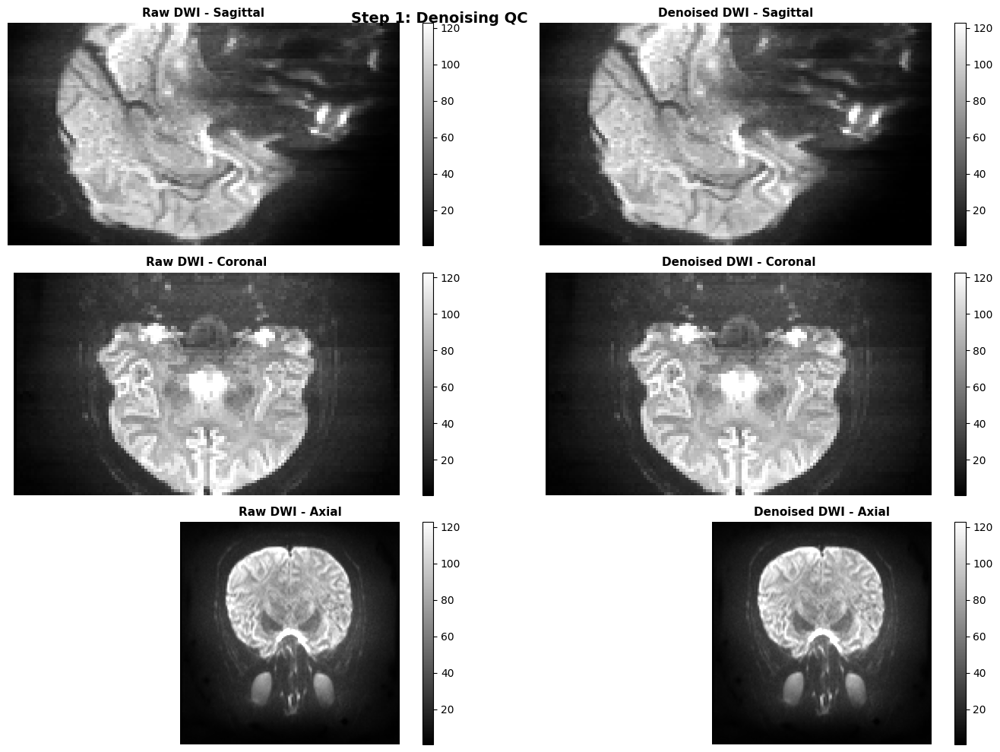


Noise Map Visualization


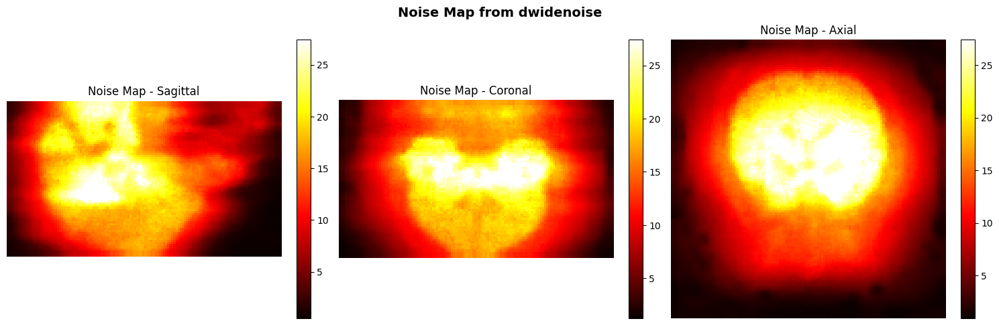


QC SUMMARY: Step 1: Denoising
  Snr Raw: 3.8776
  Snr Denoised: 3.8778
  Snr Improvement %: 4.4642e-03
  Mean Signal Raw: 27.7590
  Mean Signal Denoised: 27.7603
  Noise Std: 7.1587
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


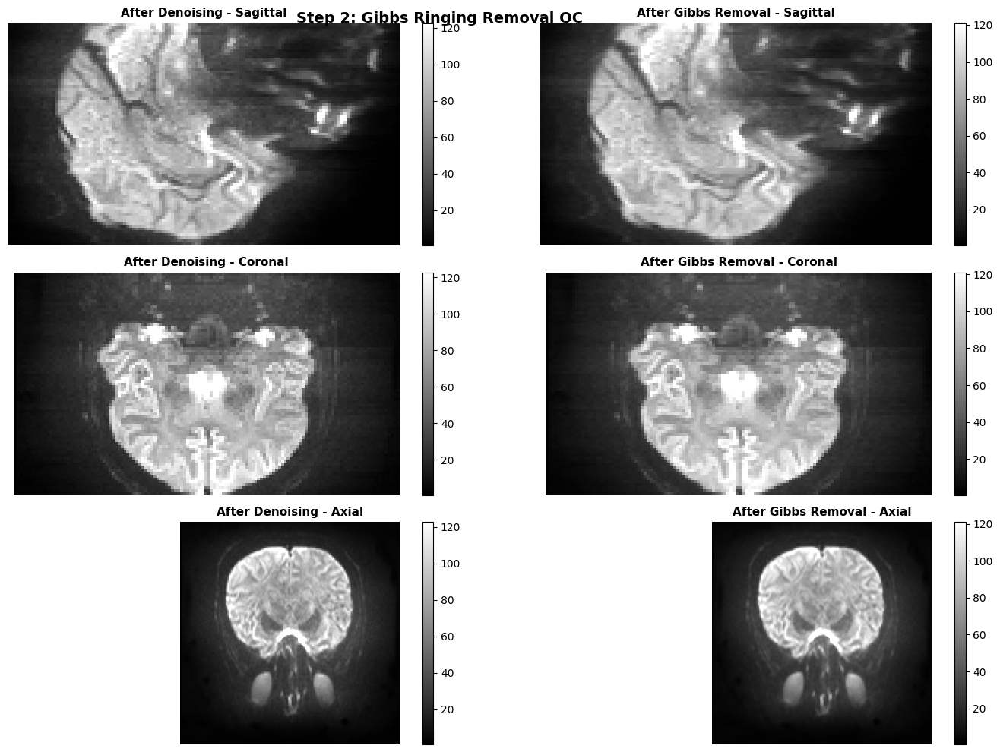


Edge Content Visualization (Gibbs ringing increases edge artifacts)


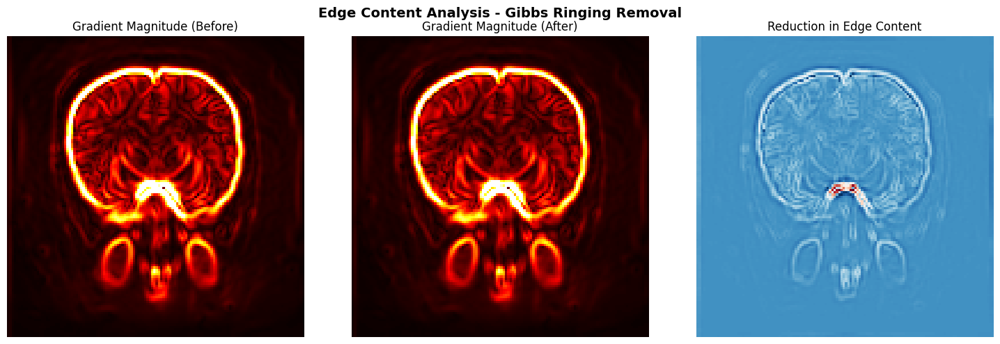


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


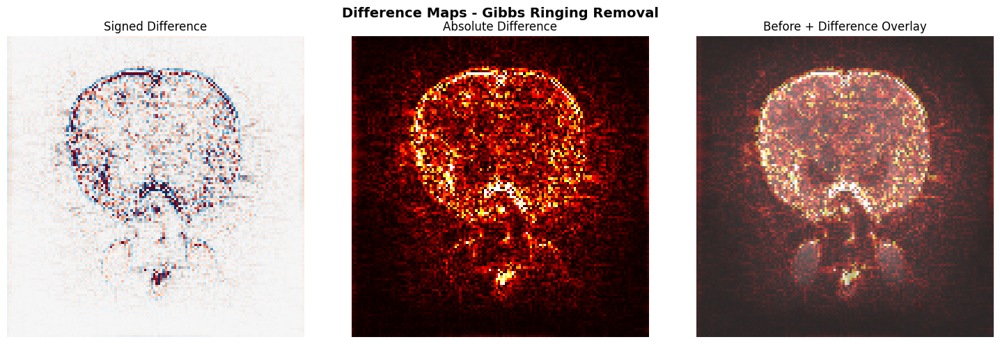


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 27.7603
  Mean Intensity After: 27.7500
  Std Intensity Before: 33.3314
  Std Intensity After: 33.1586
  Mean Gradient Before: 2.9268
  Mean Gradient After: 2.8805
  Gradient Reduction %: 1.5809
  High Freq Content Before: 10.9605
  High Freq Content After: 8.8762
  High Freq Reduction %: 19.0159
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 0.0102
  Std Difference: 1.0598
  Mean Abs Difference: 0.5262
  Max Abs Difference: 42.2177
  Voxels With Change: 60663


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


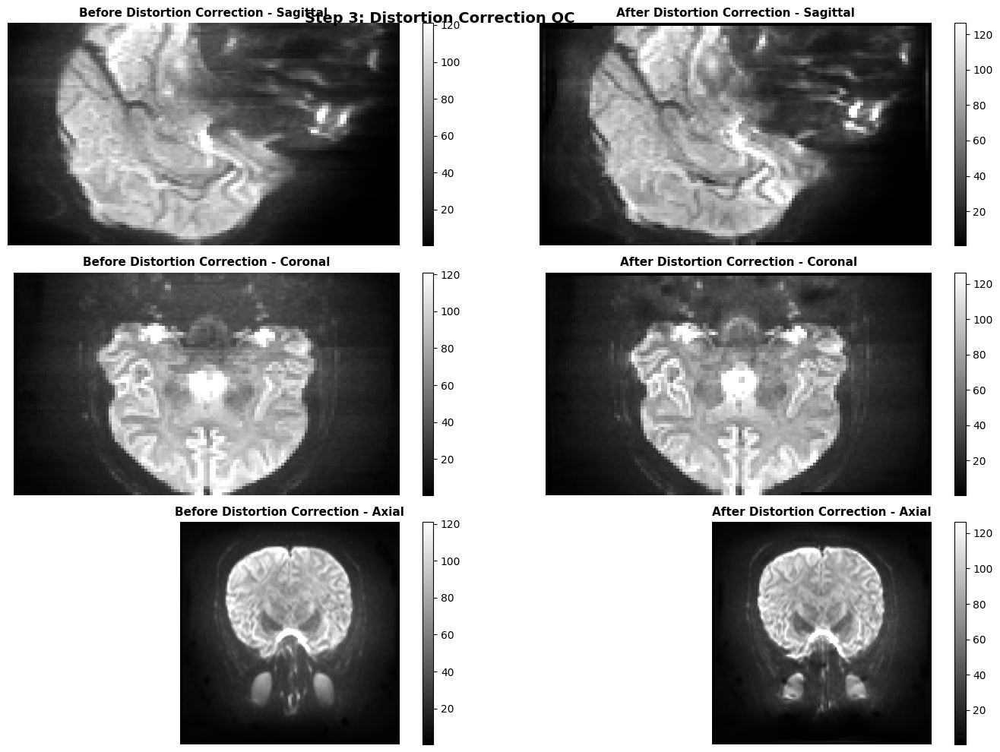


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


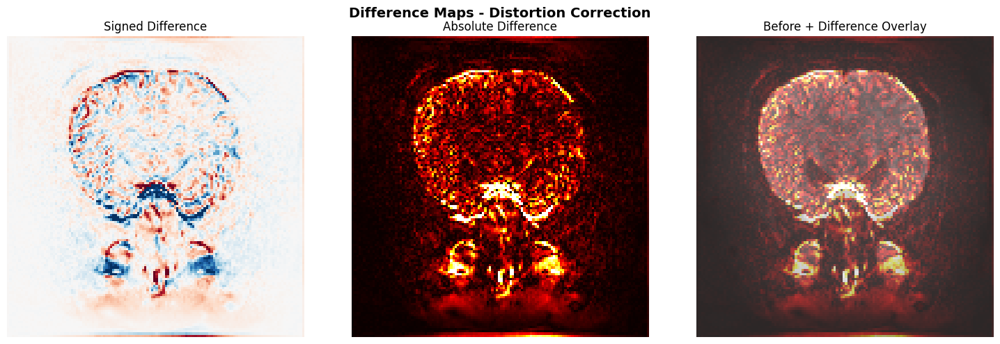


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 27.5463
  Mean Intensity After: 27.1106
  Std Intensity Before: 33.1118
  Std Intensity After: 34.1267
  Mean Difference: 0.4357
  Mean Abs Difference: 3.3292
  Max Abs Difference: 243.6290
  Voxels With Change: 61133


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


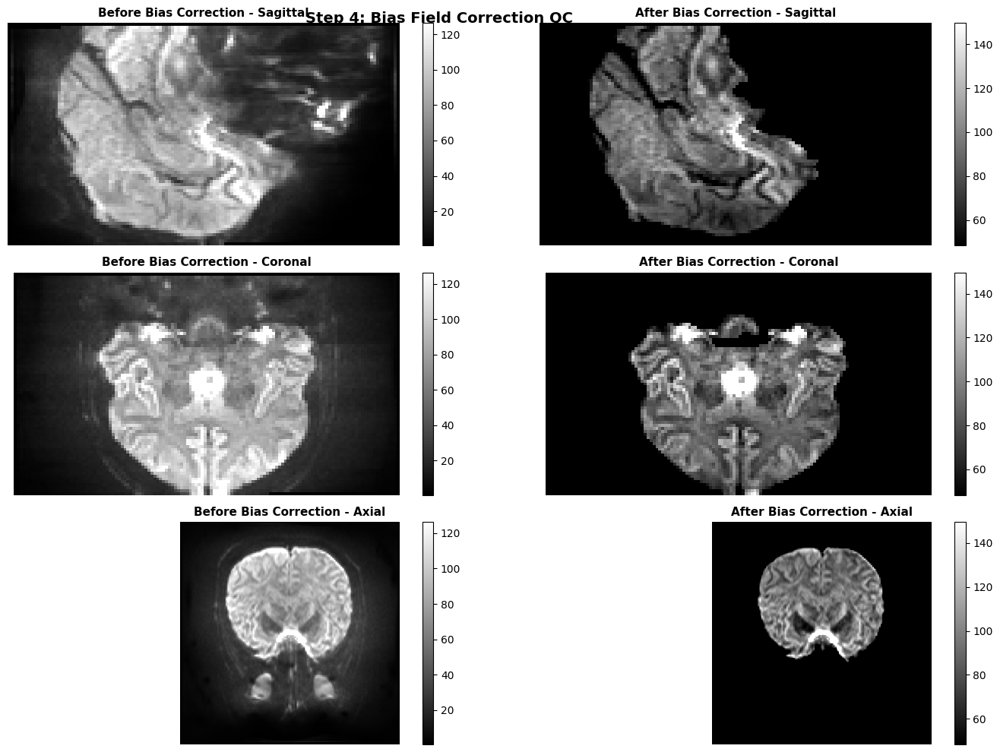


Difference Map (Before - After) - Shows where bias correction occurred


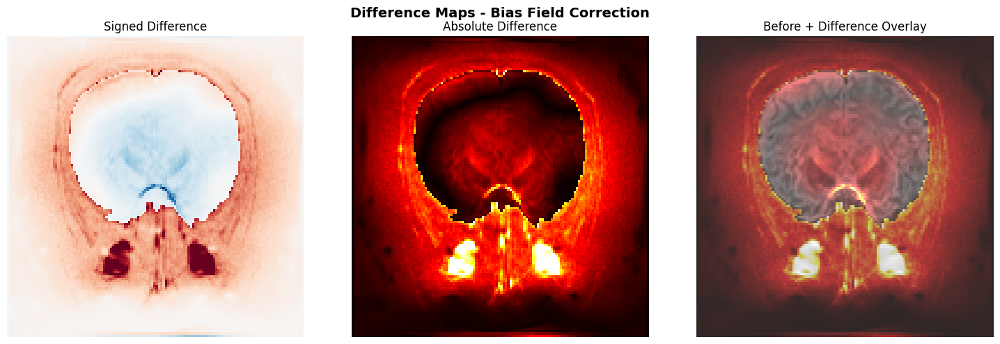


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 28.5436
  Mean Intensity After: 17.8813
  Std Intensity Before: 34.3531
  Std Intensity After: 37.1864
  Cv Before: 1.2035
  Cv After: 2.0796
  Cv Reduction %: -72.7934
  Mean Difference: 10.6622
  Mean Abs Difference: 12.2213
  Max Abs Difference: 344.4418
  Voxels With Change: 58173


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


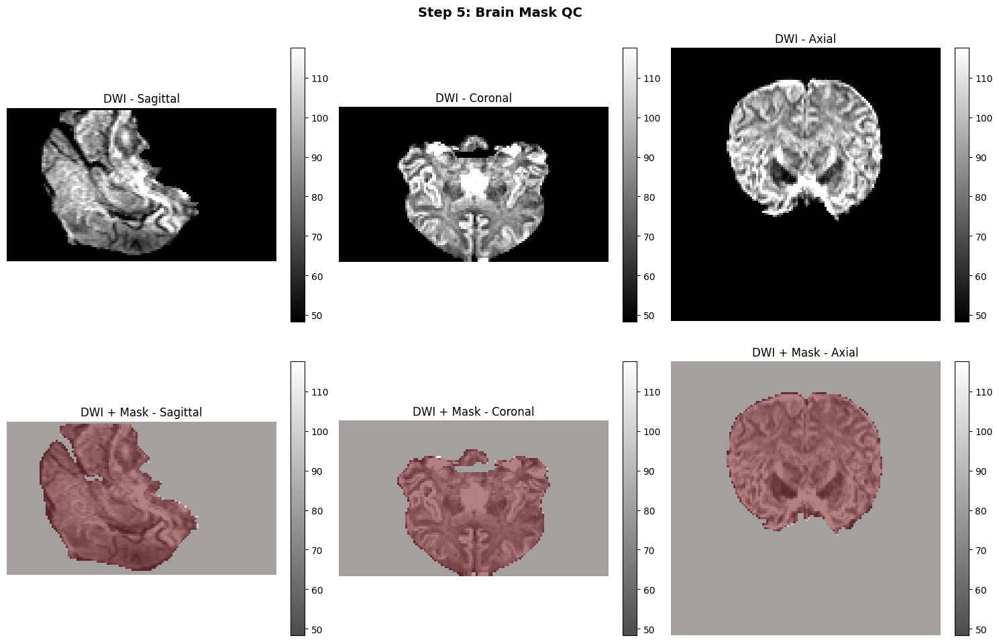


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.3307e+03
  Mask Voxels: 228178
  Coverage %: 104.3696
  Mean Intensity In Mask: 90.6569
  Mean Intensity Outside Mask: 60.3817


QC COMPLETE - See results above


In [ ]:
results_AF = comprehensive_step_qc('sub-AF')


COMPREHENSIVE STEP-BY-STEP QC: sub-CG

STEP 1: DENOISING QC



Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


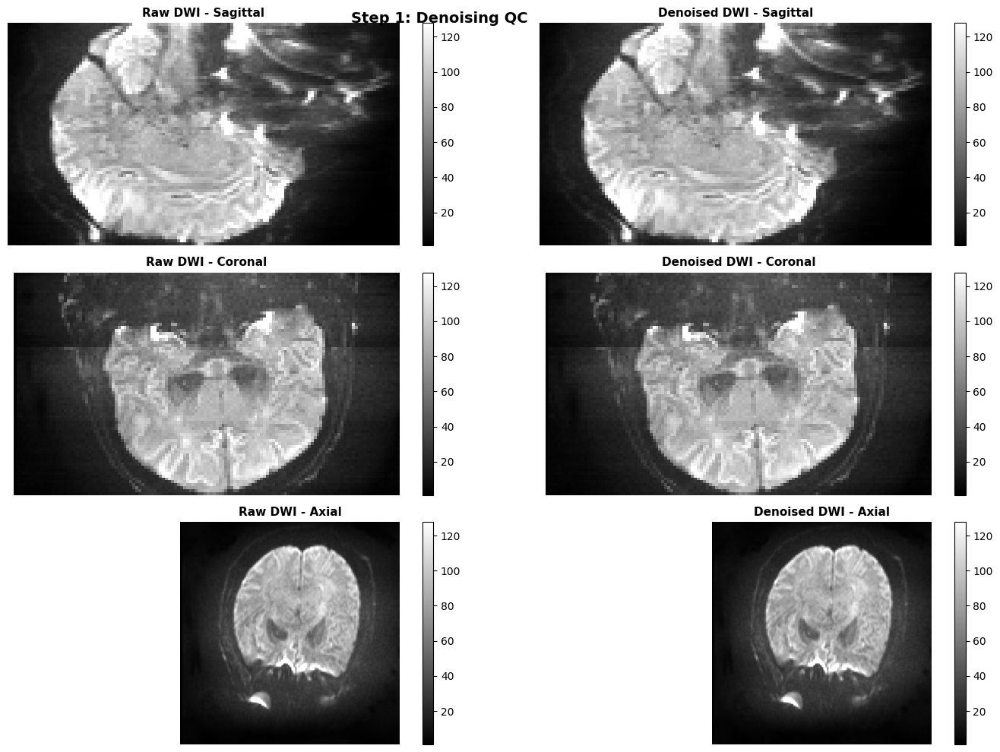


Noise Map Visualization


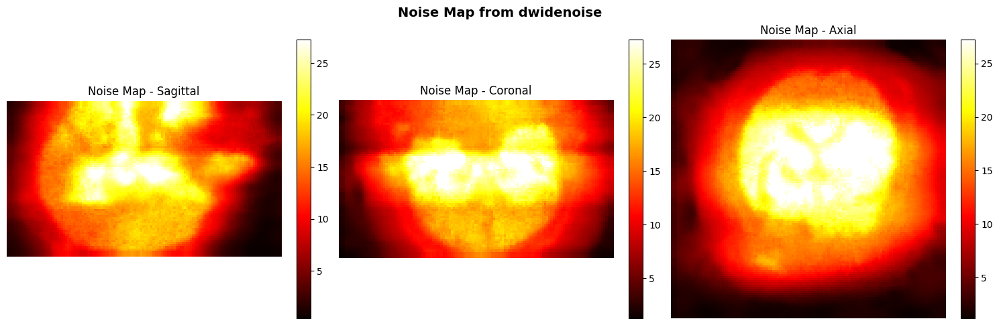


QC SUMMARY: Step 1: Denoising
  Snr Raw: 4.5355
  Snr Denoised: 4.5356
  Snr Improvement %: 2.4296e-03
  Mean Signal Raw: 31.4934
  Mean Signal Denoised: 31.4942
  Noise Std: 6.9438
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


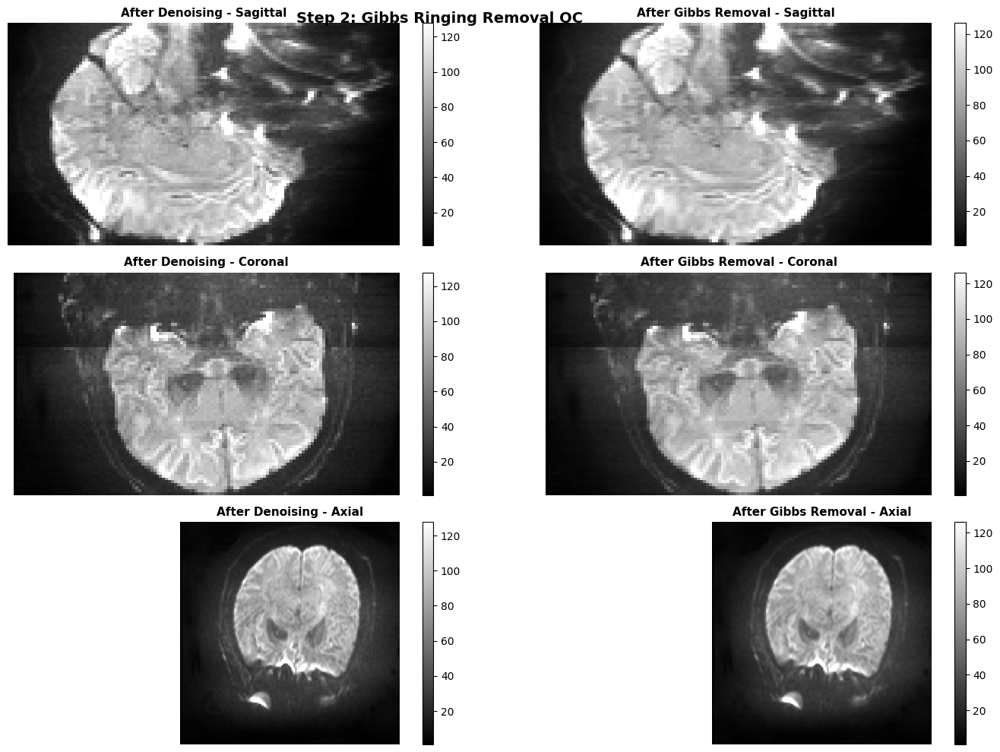


Edge Content Visualization (Gibbs ringing increases edge artifacts)


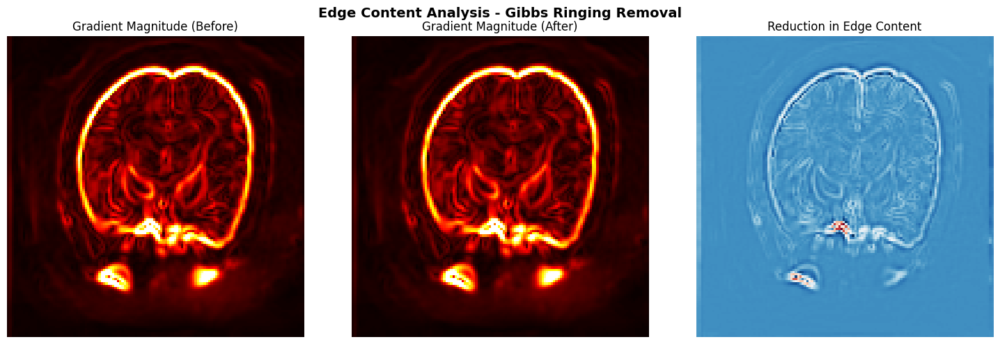


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


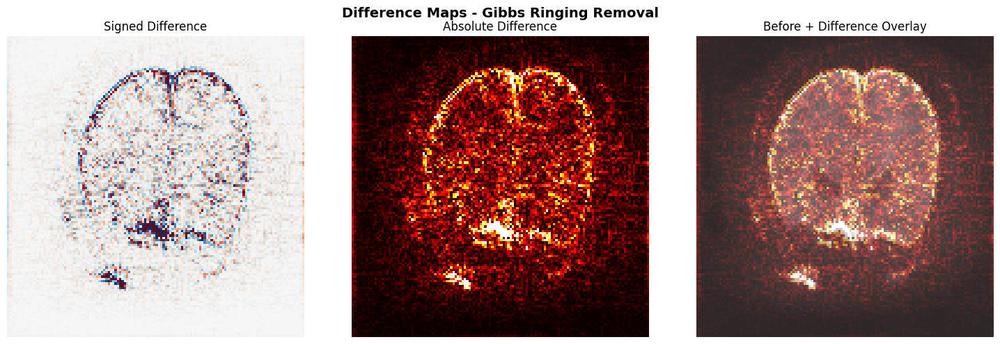


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 31.4942
  Mean Intensity After: 31.4803
  Std Intensity Before: 35.3026
  Std Intensity After: 35.0955
  Mean Gradient Before: 3.3295
  Mean Gradient After: 3.2760
  Gradient Reduction %: 1.6088
  High Freq Content Before: 12.9112
  High Freq Content After: 10.4694
  High Freq Reduction %: 18.9125
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 0.0139
  Std Difference: 1.2193
  Mean Abs Difference: 0.6159
  Max Abs Difference: 47.6300
  Voxels With Change: 60663


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


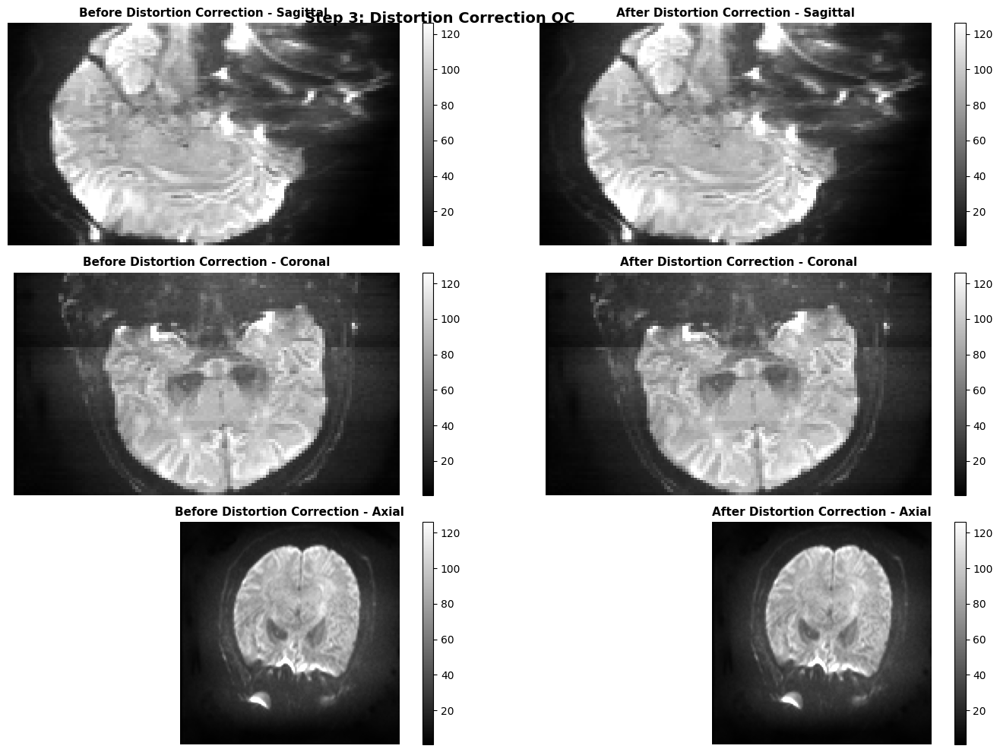


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


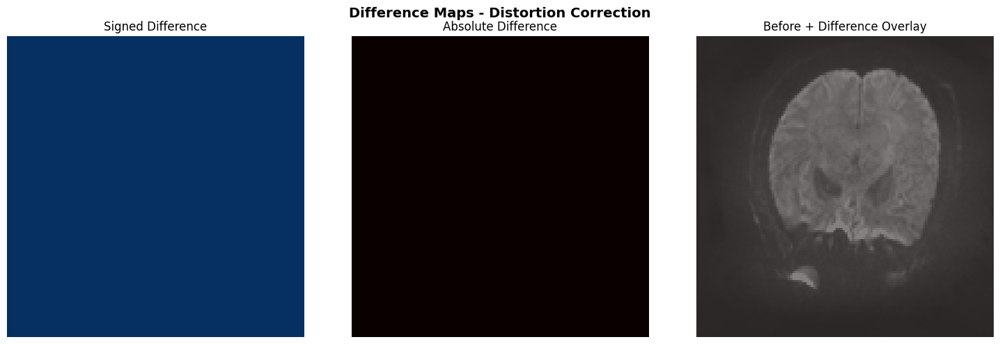


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 31.2516
  Mean Intensity After: 31.2516
  Std Intensity Before: 35.0566
  Std Intensity After: 35.0566
  Mean Difference: 0.0000e+00
  Mean Abs Difference: 0.0000e+00
  Max Abs Difference: 0.0000e+00
  Voxels With Change: 0


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


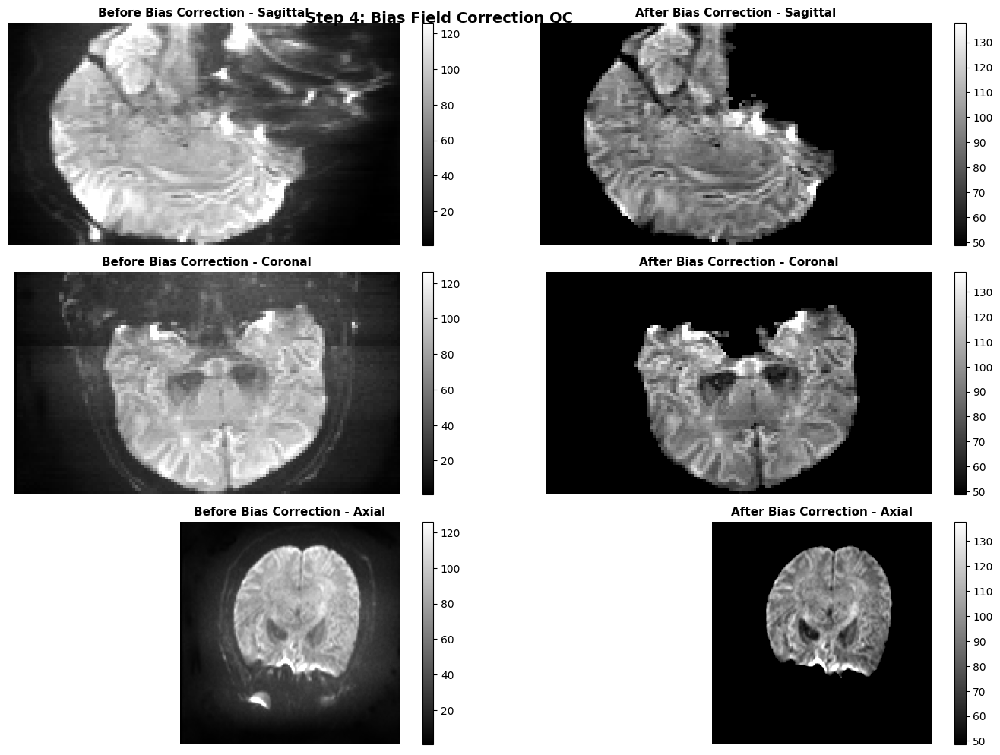


Difference Map (Before - After) - Shows where bias correction occurred


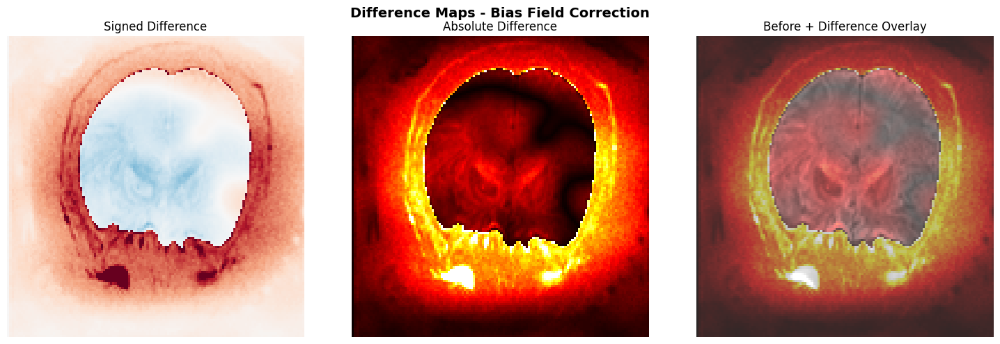


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 31.2516
  Mean Intensity After: 18.8807
  Std Intensity Before: 35.0566
  Std Intensity After: 38.4013
  Cv Before: 1.1218
  Cv After: 2.0339
  Cv Reduction %: -81.3137
  Mean Difference: 12.3709
  Mean Abs Difference: 13.8949
  Max Abs Difference: 316.6115
  Voxels With Change: 61133


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


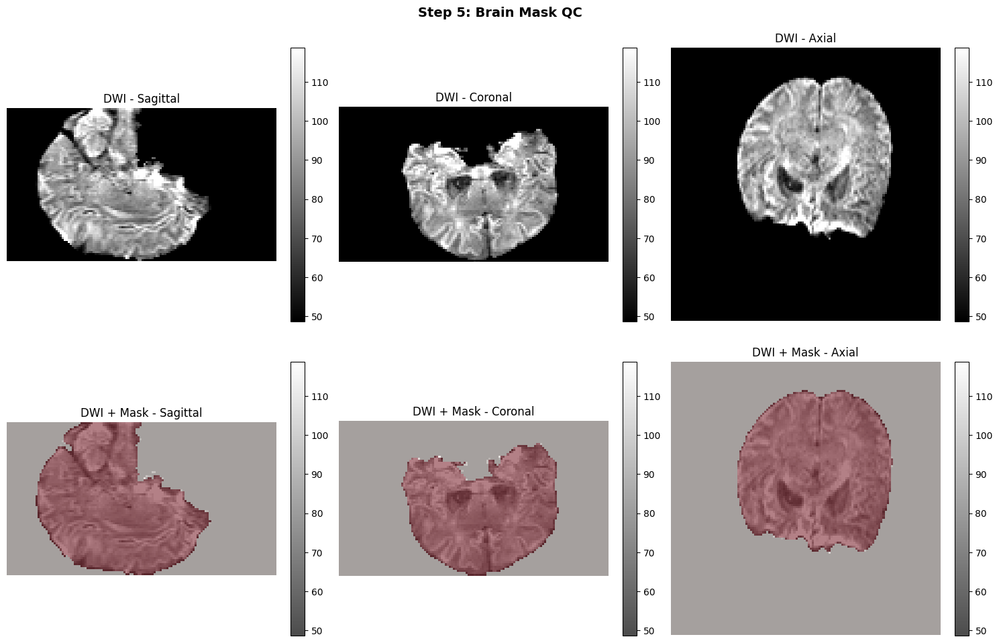


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.4305e+03
  Mask Voxels: 245277
  Coverage %: 104.7959
  Mean Intensity In Mask: 93.8325
  Mean Intensity Outside Mask: 63.5457


QC COMPLETE - See results above


In [ ]:
results_CG = comprehensive_step_qc('sub-CG')


COMPREHENSIVE STEP-BY-STEP QC: sub-DA

STEP 1: DENOISING QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


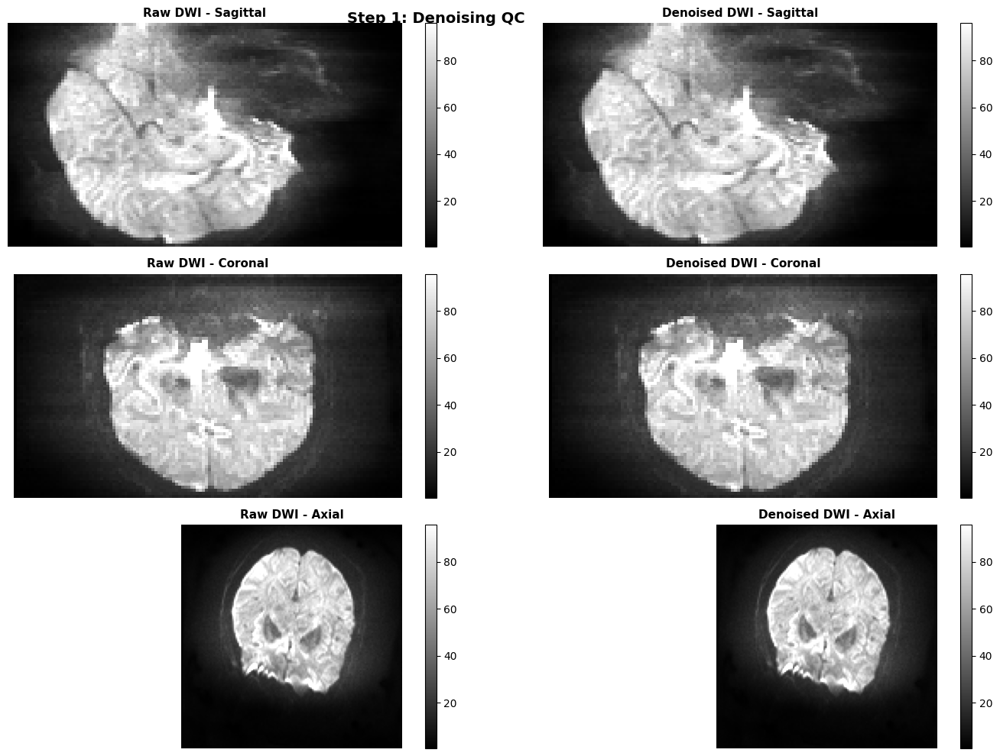


Noise Map Visualization


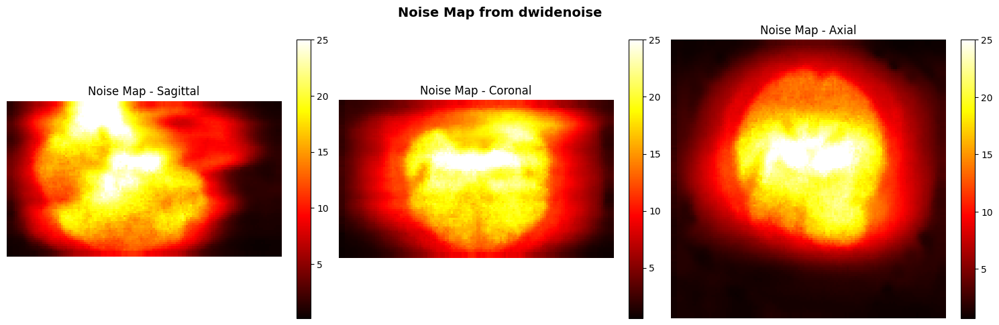


QC SUMMARY: Step 1: Denoising
  Snr Raw: 3.3200
  Snr Denoised: 3.3200
  Snr Improvement %: 2.5474e-03
  Mean Signal Raw: 21.1336
  Mean Signal Denoised: 21.1342
  Noise Std: 6.3656
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


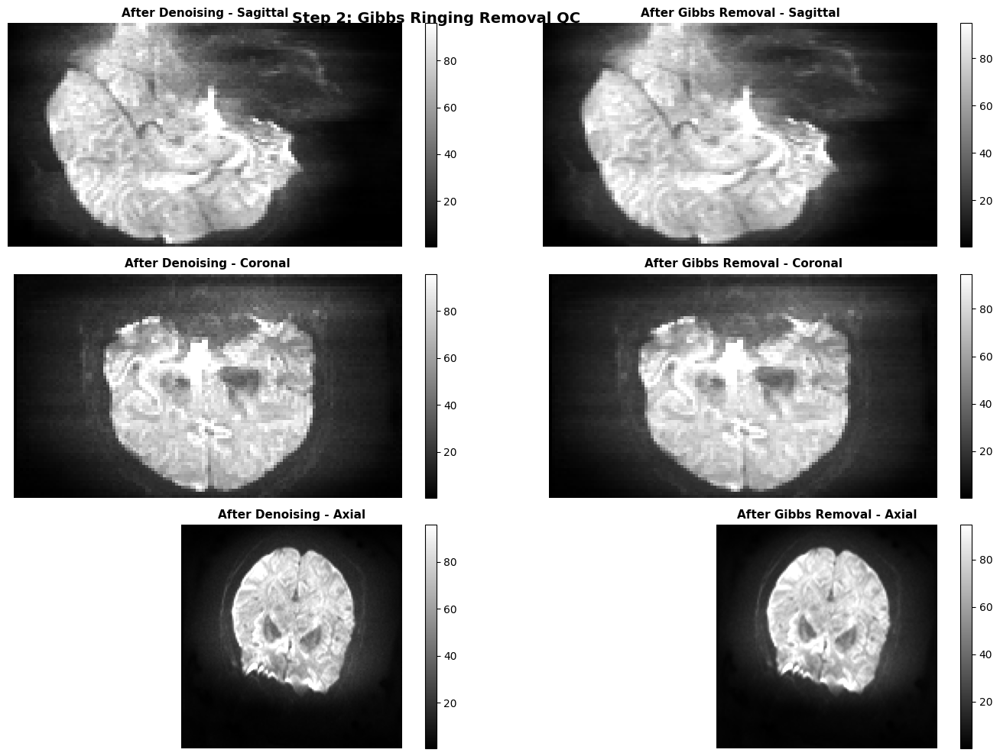


Edge Content Visualization (Gibbs ringing increases edge artifacts)


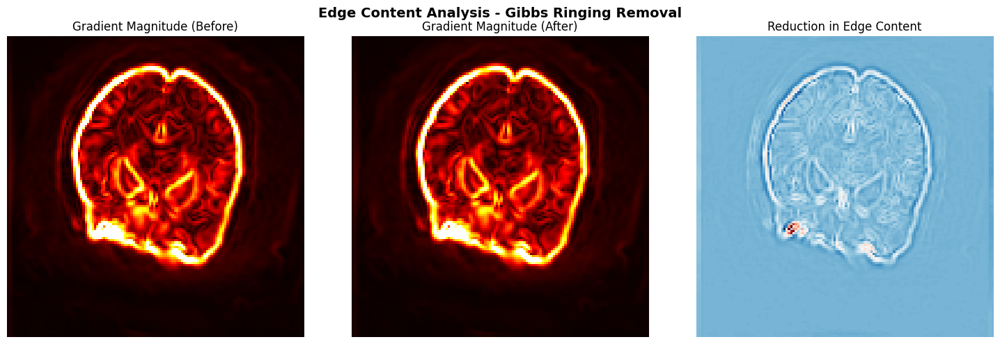


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


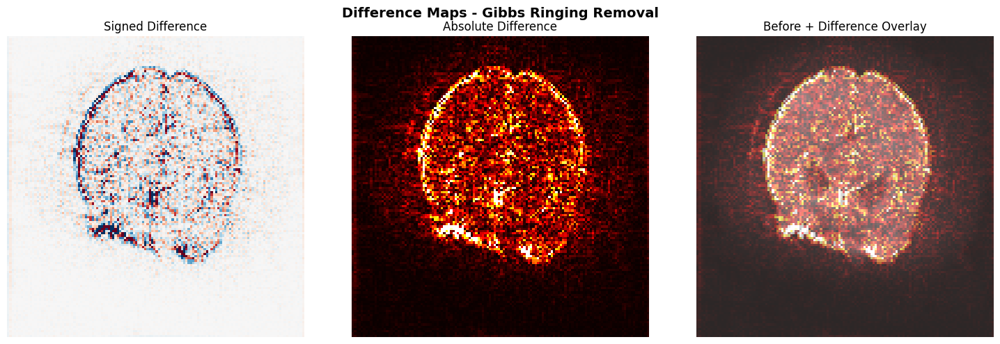


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 21.1342
  Mean Intensity After: 21.1293
  Std Intensity Before: 27.1916
  Std Intensity After: 27.0811
  Mean Gradient Before: 2.1091
  Mean Gradient After: 2.0829
  Gradient Reduction %: 1.2412
  High Freq Content Before: 7.8676
  High Freq Content After: 6.2912
  High Freq Reduction %: 20.0364
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 4.8354e-03
  Std Difference: 0.7883
  Mean Abs Difference: 0.3796
  Max Abs Difference: 35.8671
  Voxels With Change: 60657


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


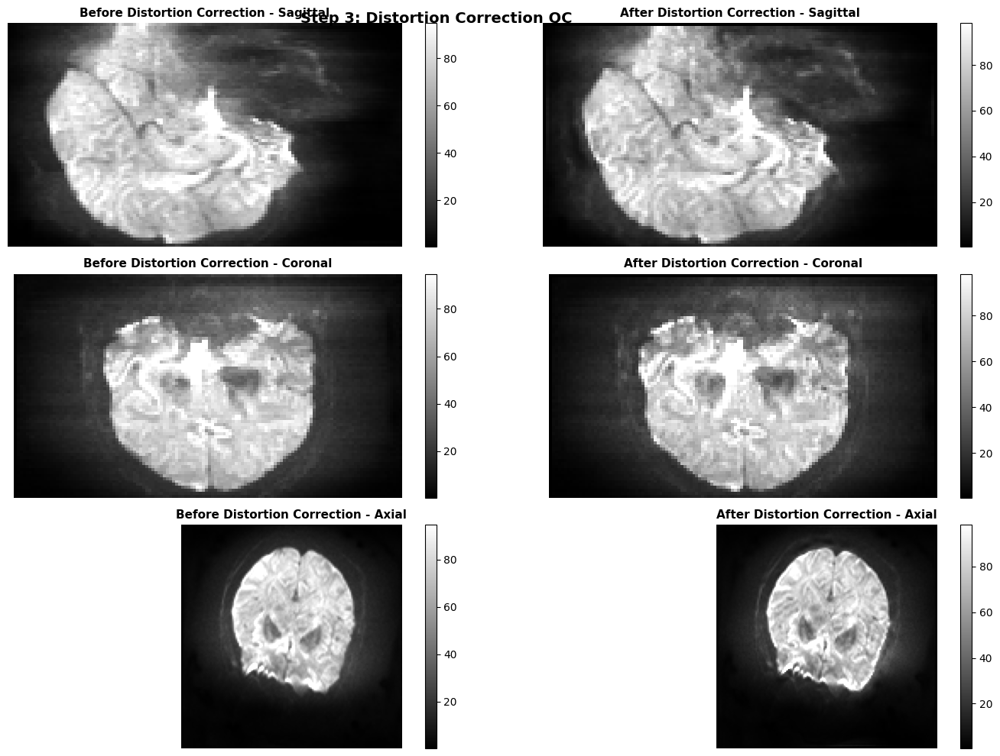


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


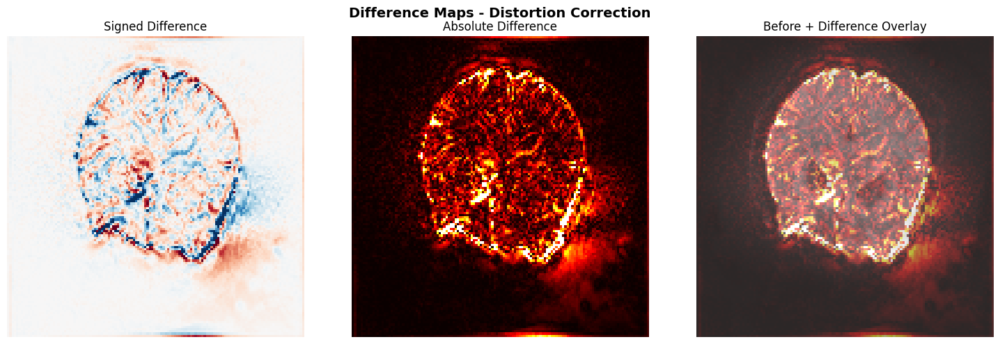


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 20.9724
  Mean Intensity After: 20.8053
  Std Intensity Before: 27.0342
  Std Intensity After: 27.6042
  Mean Difference: 0.1670
  Mean Abs Difference: 1.6783
  Max Abs Difference: 175.8046
  Voxels With Change: 61131


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


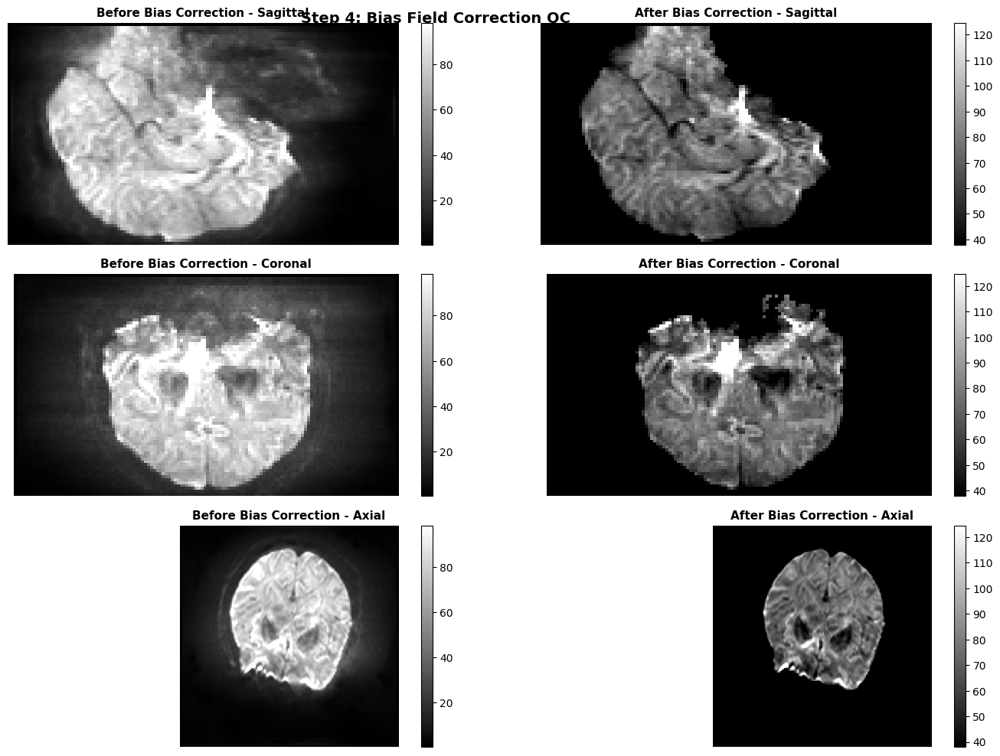


Difference Map (Before - After) - Shows where bias correction occurred


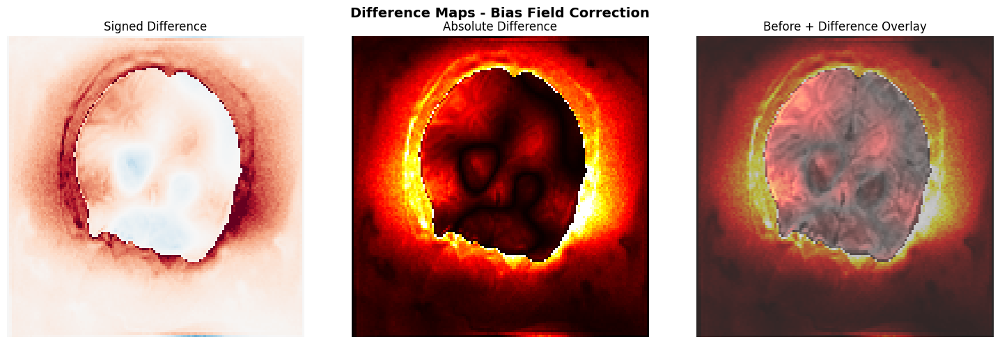


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 21.5414
  Mean Intensity After: 14.0275
  Std Intensity Before: 27.7906
  Std Intensity After: 29.9845
  Cv Before: 1.2901
  Cv After: 2.1376
  Cv Reduction %: -65.6885
  Mean Difference: 7.5139
  Mean Abs Difference: 8.4578
  Max Abs Difference: 179.0363
  Voxels With Change: 59071


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


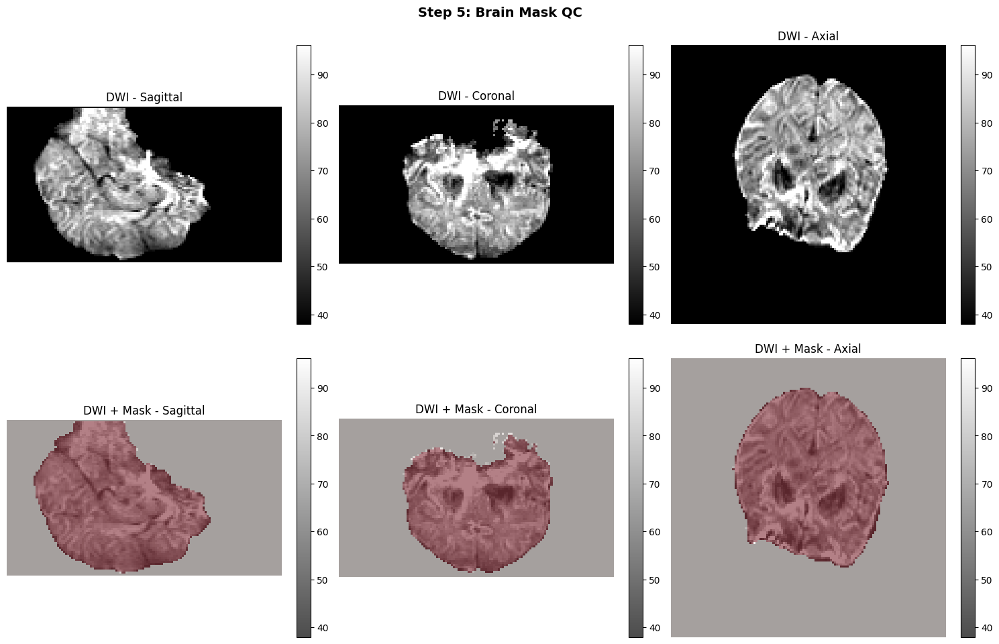


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.2933e+03
  Mask Voxels: 221753
  Coverage %: 104.6879
  Mean Intensity In Mask: 74.4551
  Mean Intensity Outside Mask: 50.4949


QC COMPLETE - See results above


In [ ]:
results_DA = comprehensive_step_qc('sub-DA')


COMPREHENSIVE STEP-BY-STEP QC: sub-DA2

STEP 1: DENOISING QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


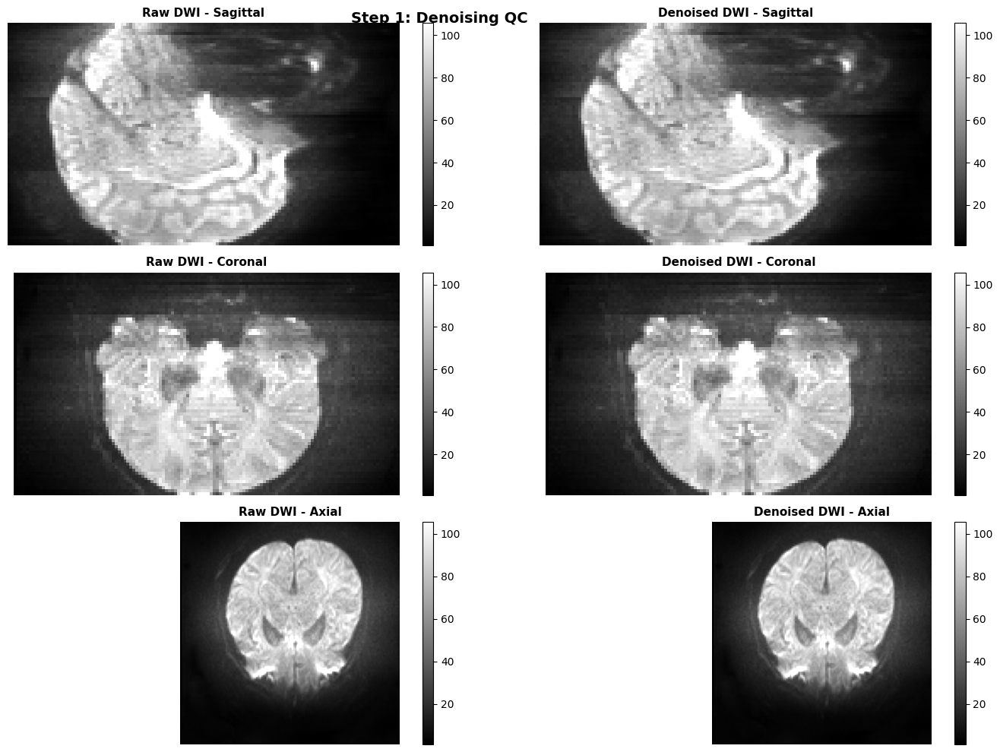


Noise Map Visualization


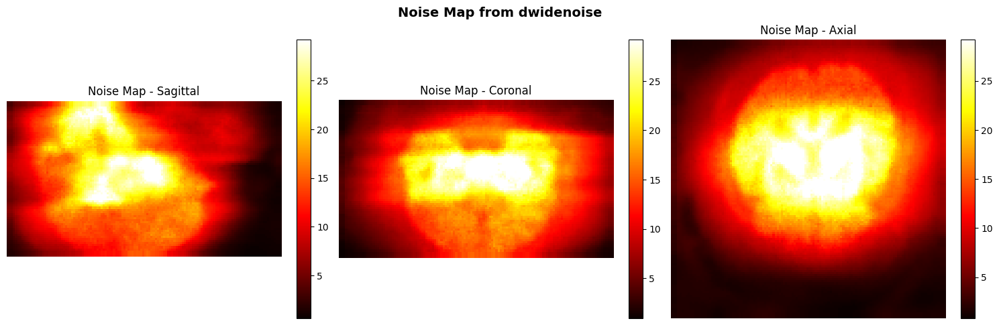


QC SUMMARY: Step 1: Denoising
  Snr Raw: 3.8934
  Snr Denoised: 3.8935
  Snr Improvement %: 3.2340e-03
  Mean Signal Raw: 27.8182
  Mean Signal Denoised: 27.8191
  Noise Std: 7.1450
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


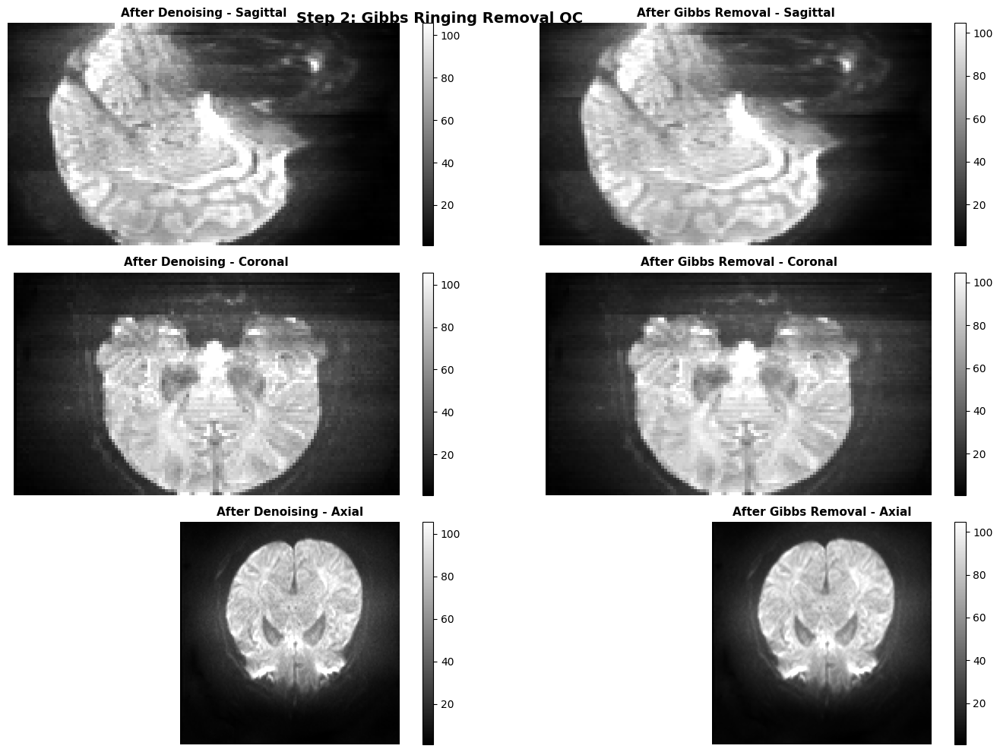


Edge Content Visualization (Gibbs ringing increases edge artifacts)


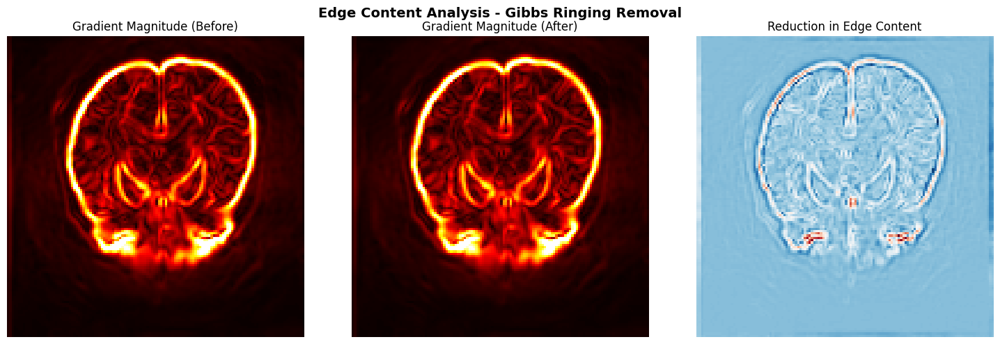


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


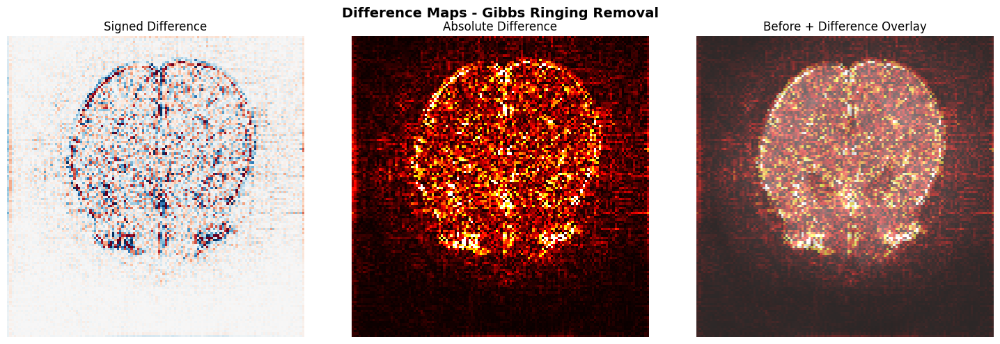


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 27.8191
  Mean Intensity After: 27.8100
  Std Intensity Before: 31.2110
  Std Intensity After: 31.0982
  Mean Gradient Before: 2.5837
  Mean Gradient After: 2.5532
  Gradient Reduction %: 1.1792
  High Freq Content Before: 9.3889
  High Freq Content After: 7.5572
  High Freq Reduction %: 19.5096
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 9.1095e-03
  Std Difference: 0.8460
  Mean Abs Difference: 0.4518
  Max Abs Difference: 57.0651
  Voxels With Change: 60663


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


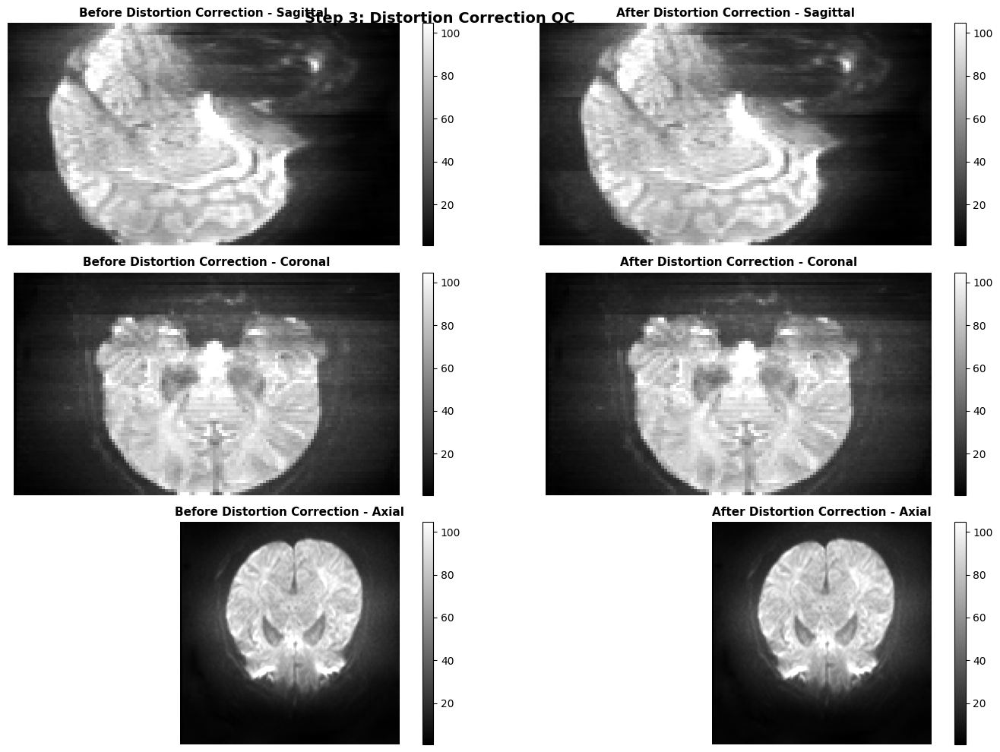


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


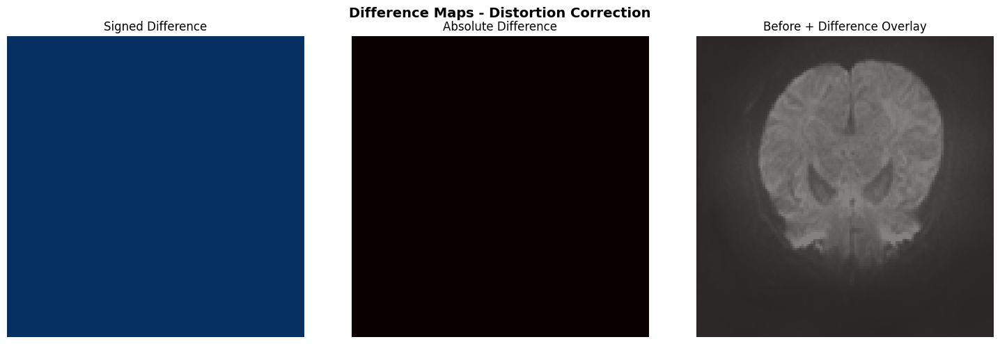


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 27.6083
  Mean Intensity After: 27.6083
  Std Intensity Before: 31.0629
  Std Intensity After: 31.0629
  Mean Difference: 0.0000e+00
  Mean Abs Difference: 0.0000e+00
  Max Abs Difference: 0.0000e+00
  Voxels With Change: 0


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


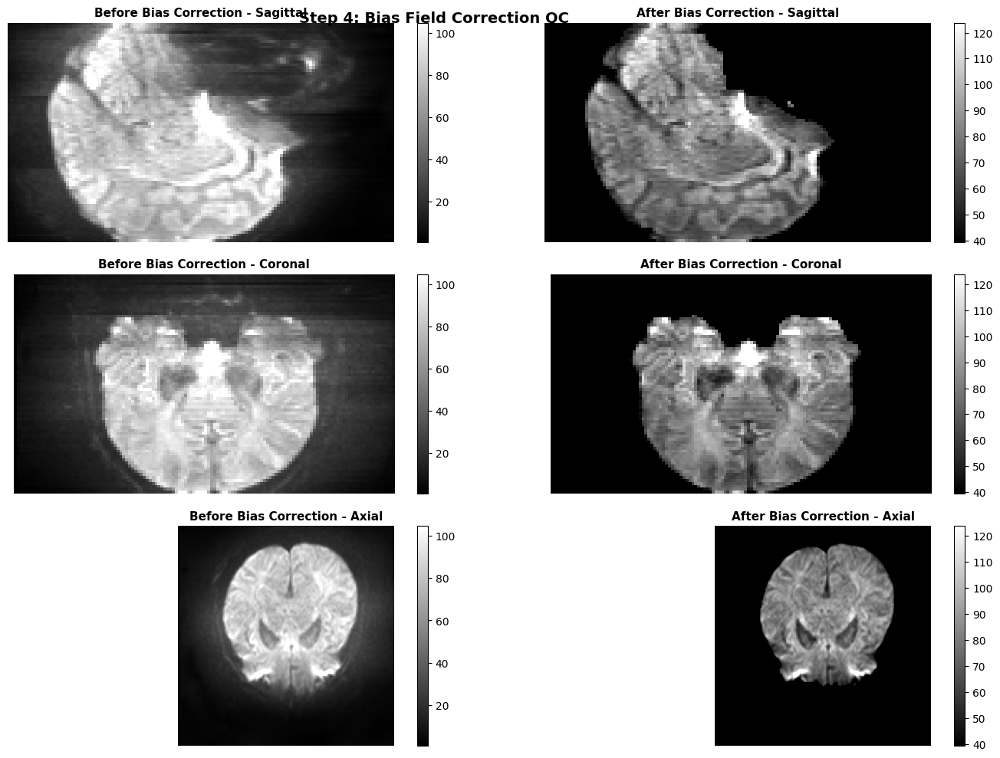


Difference Map (Before - After) - Shows where bias correction occurred


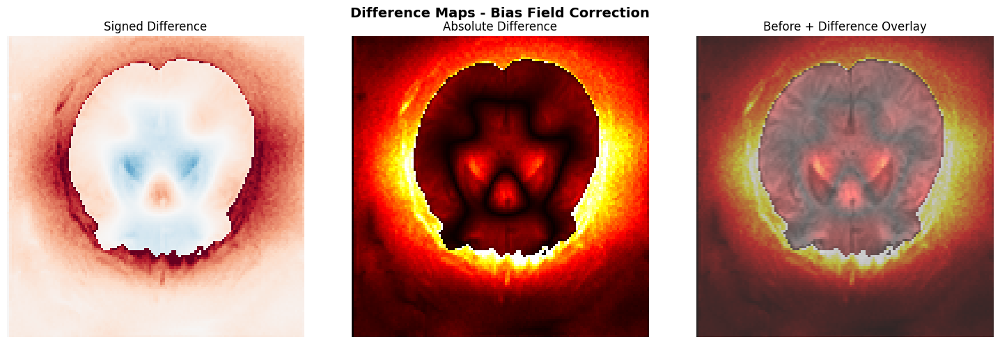


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 27.6083
  Mean Intensity After: 18.4329
  Std Intensity Before: 31.0629
  Std Intensity After: 34.9874
  Cv Before: 1.1251
  Cv After: 1.8981
  Cv Reduction %: -68.7008
  Mean Difference: 9.1755
  Mean Abs Difference: 10.7491
  Max Abs Difference: 148.0112
  Voxels With Change: 61133


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


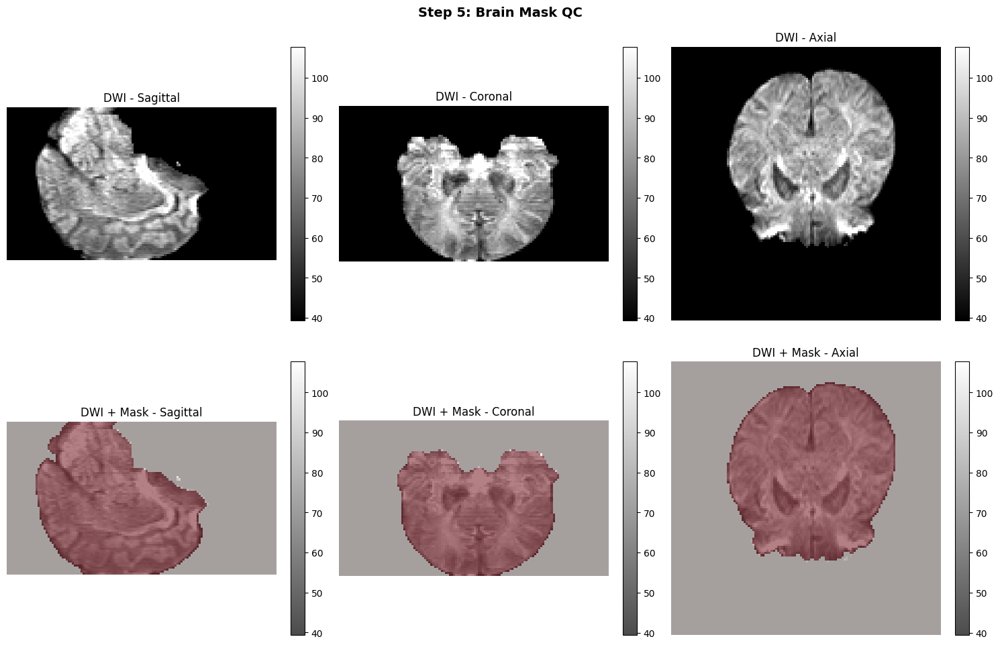


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.6135e+03
  Mask Voxels: 276657
  Coverage %: 104.8980
  Mean Intensity In Mask: 81.2750
  Mean Intensity Outside Mask: 53.6304


QC COMPLETE - See results above


In [35]:
results_DA2 = comprehensive_step_qc('sub-DA2')


COMPREHENSIVE STEP-BY-STEP QC: sub-FS

STEP 1: DENOISING QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


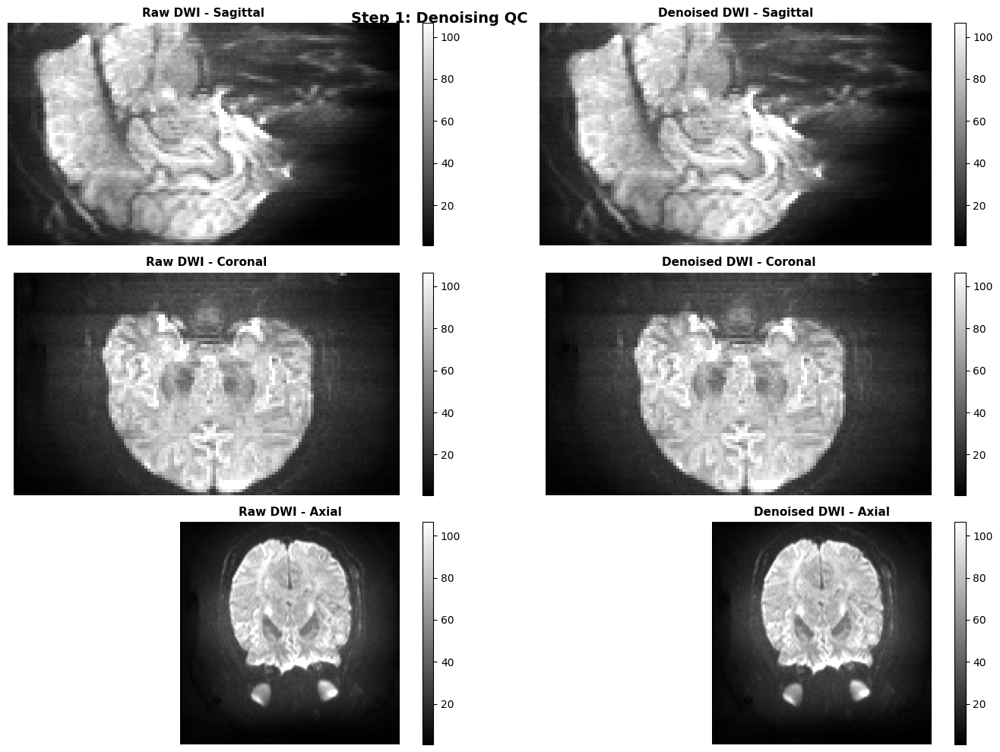


Noise Map Visualization


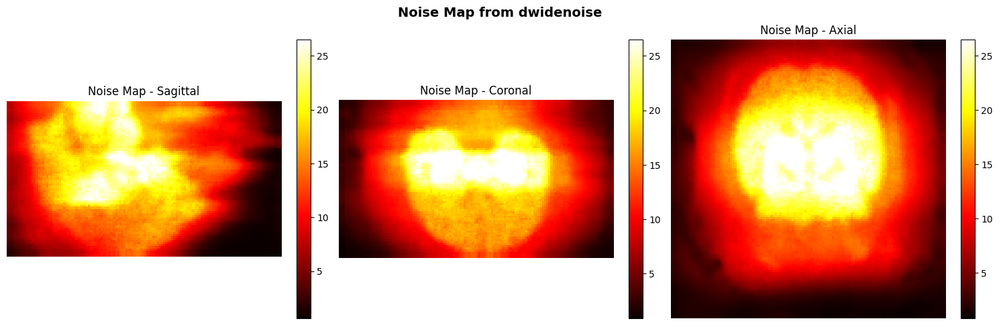


QC SUMMARY: Step 1: Denoising
  Snr Raw: 3.8942
  Snr Denoised: 3.8944
  Snr Improvement %: 5.5388e-03
  Mean Signal Raw: 26.7324
  Mean Signal Denoised: 26.7339
  Noise Std: 6.8646
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


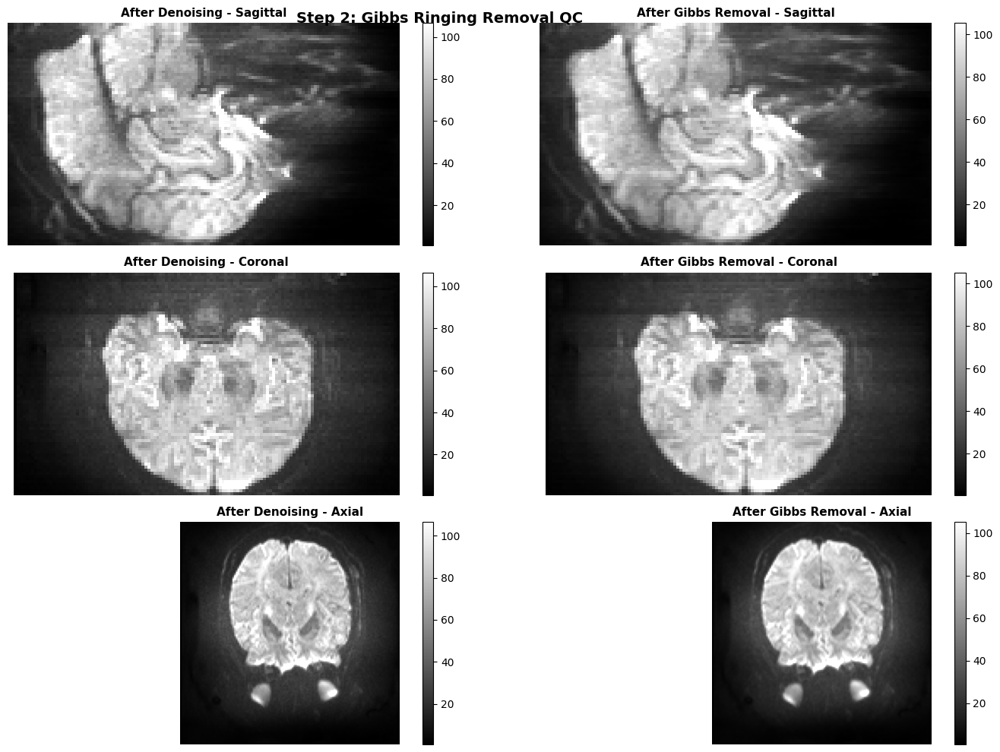


Edge Content Visualization (Gibbs ringing increases edge artifacts)


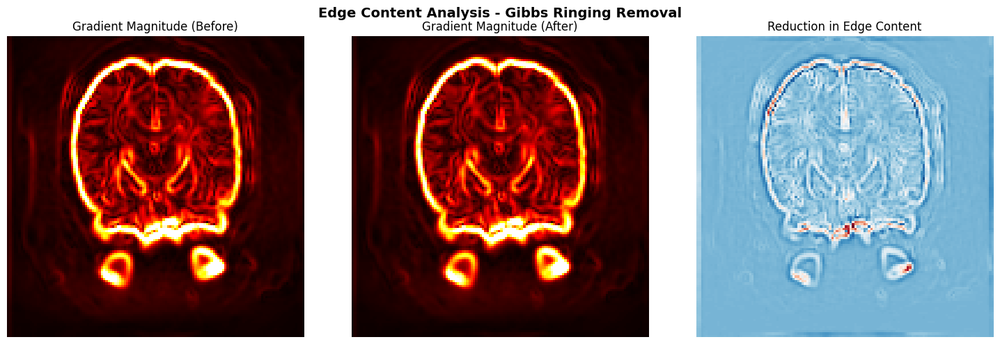


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


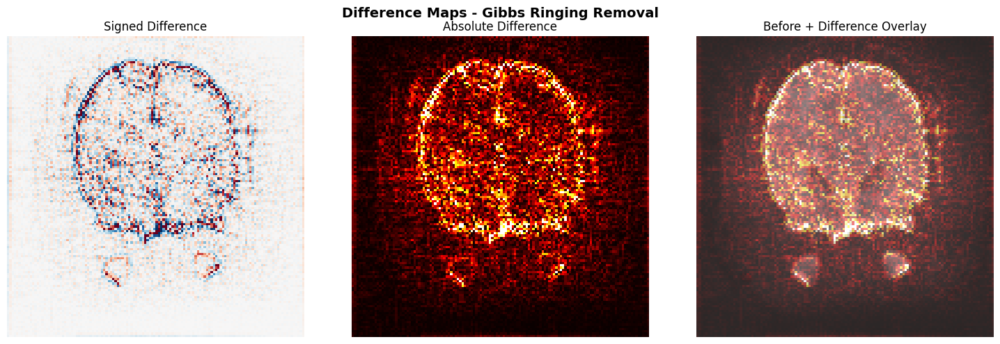


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 26.7339
  Mean Intensity After: 26.7269
  Std Intensity Before: 30.5571
  Std Intensity After: 30.4214
  Mean Gradient Before: 2.6555
  Mean Gradient After: 2.6179
  Gradient Reduction %: 1.4154
  High Freq Content Before: 9.8357
  High Freq Content After: 7.8924
  High Freq Reduction %: 19.7577
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 6.9848e-03
  Std Difference: 0.9320
  Mean Abs Difference: 0.4865
  Max Abs Difference: 33.1691
  Voxels With Change: 60663


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


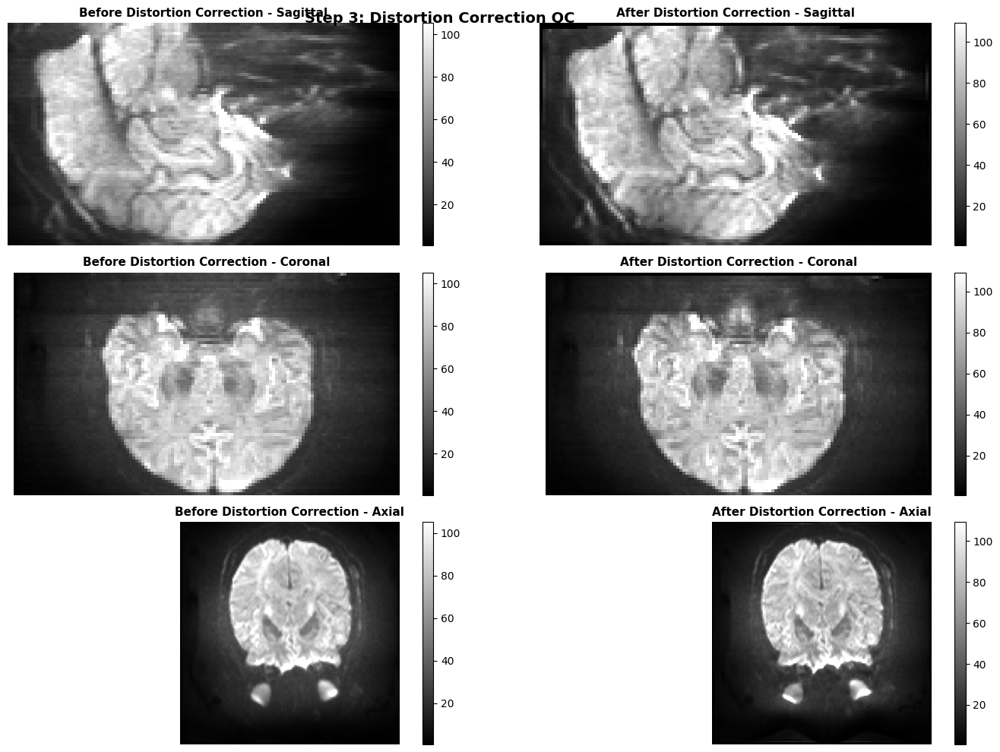


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


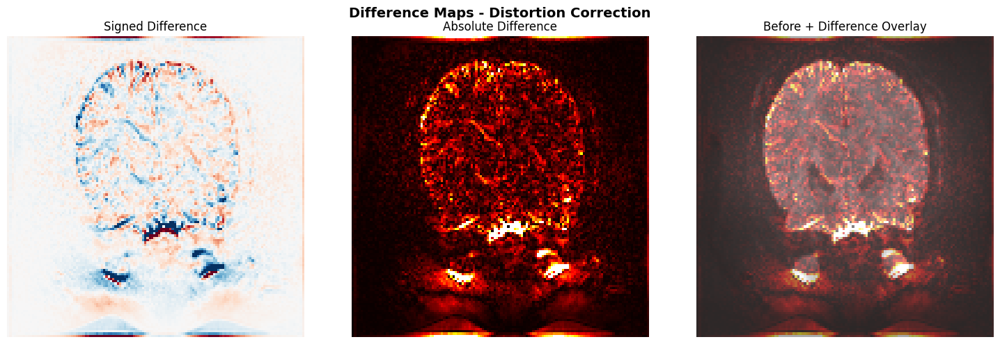


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 26.5314
  Mean Intensity After: 26.1582
  Std Intensity Before: 30.3854
  Std Intensity After: 31.1322
  Mean Difference: 0.3732
  Mean Abs Difference: 2.4451
  Max Abs Difference: 234.6780
  Voxels With Change: 61133


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


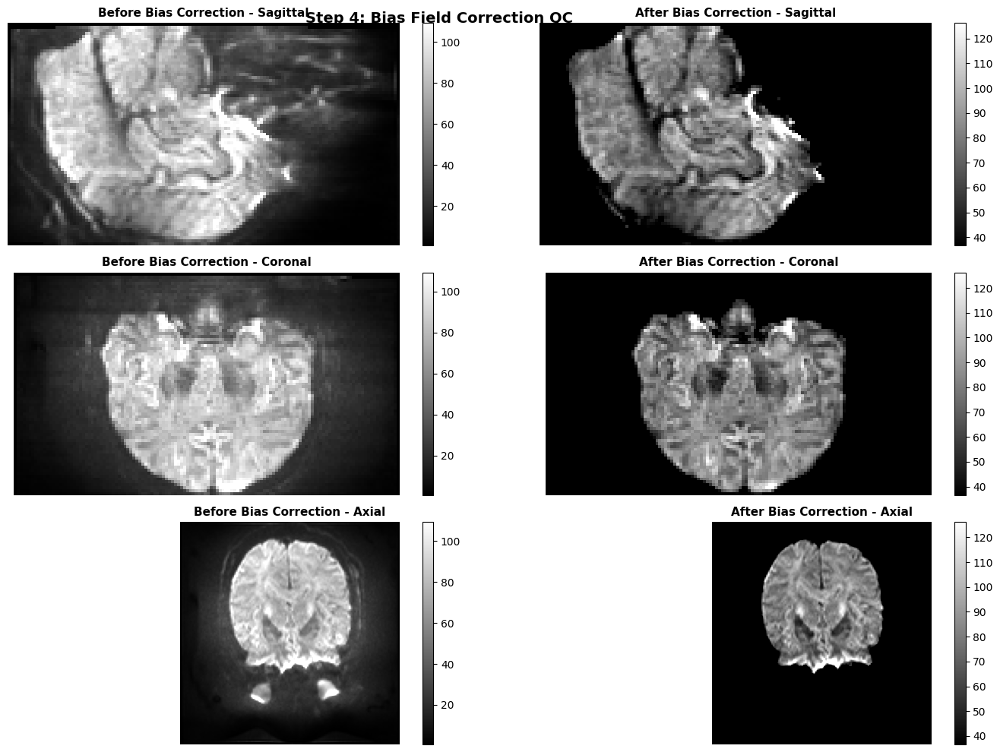


Difference Map (Before - After) - Shows where bias correction occurred


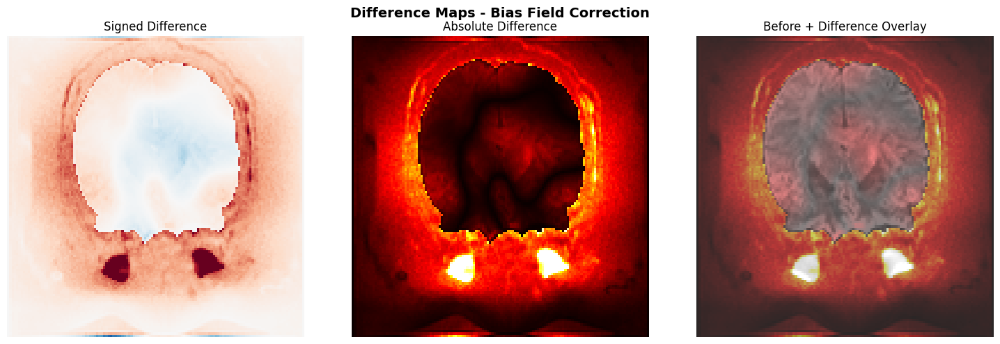


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 27.3574
  Mean Intensity After: 17.6751
  Std Intensity Before: 31.2621
  Std Intensity After: 34.3605
  Cv Before: 1.1427
  Cv After: 1.9440
  Cv Reduction %: -70.1190
  Mean Difference: 9.6822
  Mean Abs Difference: 10.6923
  Max Abs Difference: 530.6078
  Voxels With Change: 58548


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


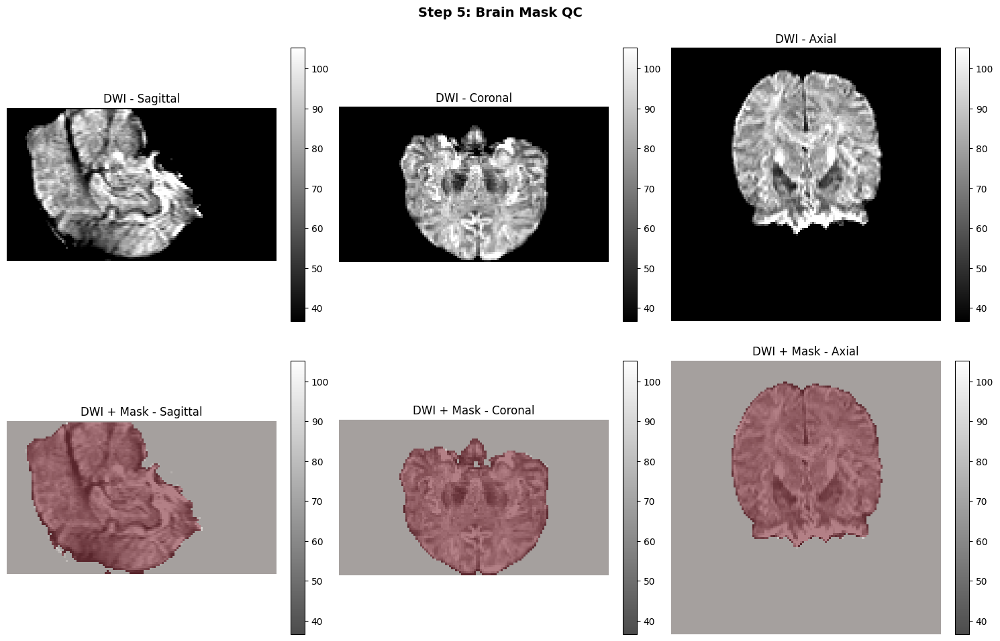


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.4870e+03
  Mask Voxels: 254966
  Coverage %: 104.5603
  Mean Intensity In Mask: 80.8353
  Mean Intensity Outside Mask: 50.4109


QC COMPLETE - See results above


In [36]:
results_FS = comprehensive_step_qc('sub-FS')


COMPREHENSIVE STEP-BY-STEP QC: sub-FSE

STEP 1: DENOISING QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


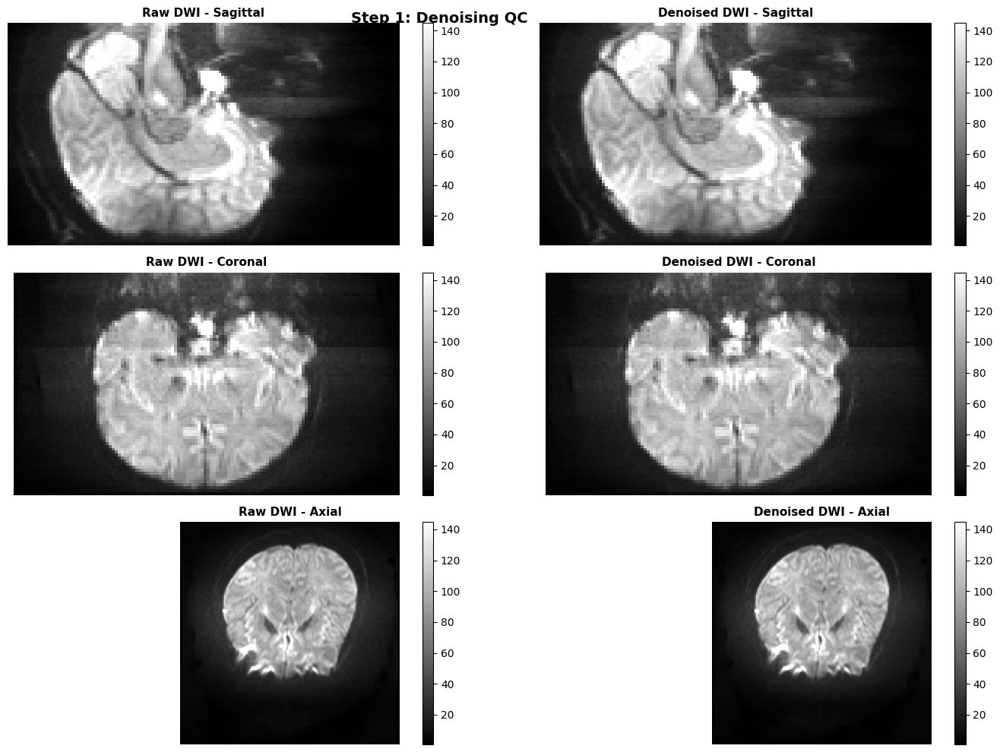


Noise Map Visualization


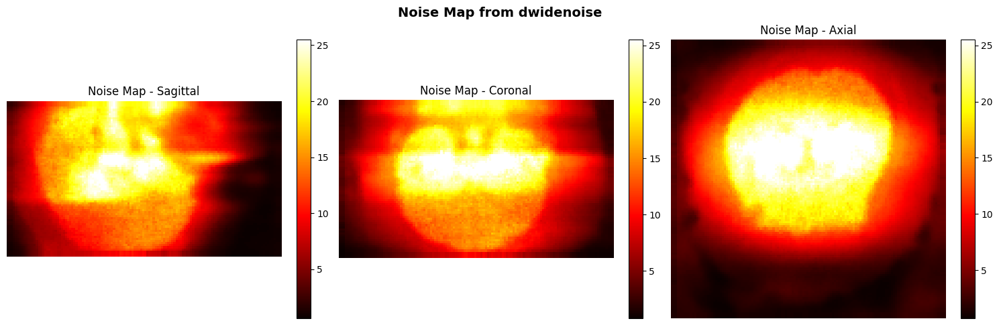


QC SUMMARY: Step 1: Denoising
  Snr Raw: 4.6797
  Snr Denoised: 4.6797
  Snr Improvement %: 1.1271e-03
  Mean Signal Raw: 30.2484
  Mean Signal Denoised: 30.2487
  Noise Std: 6.4638
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


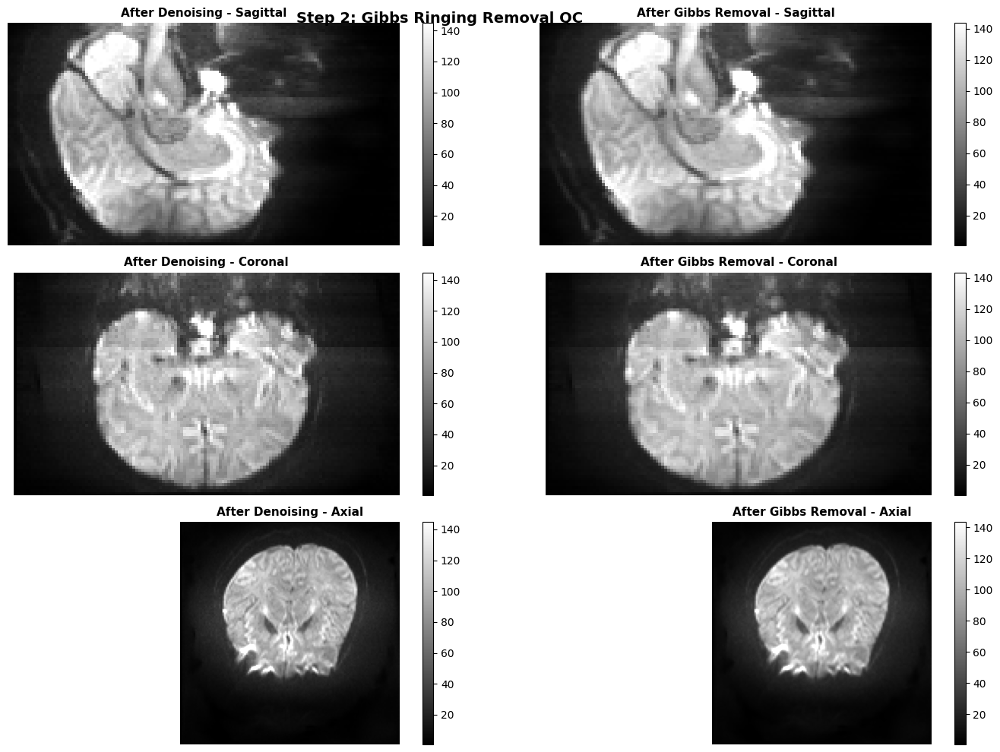


Edge Content Visualization (Gibbs ringing increases edge artifacts)


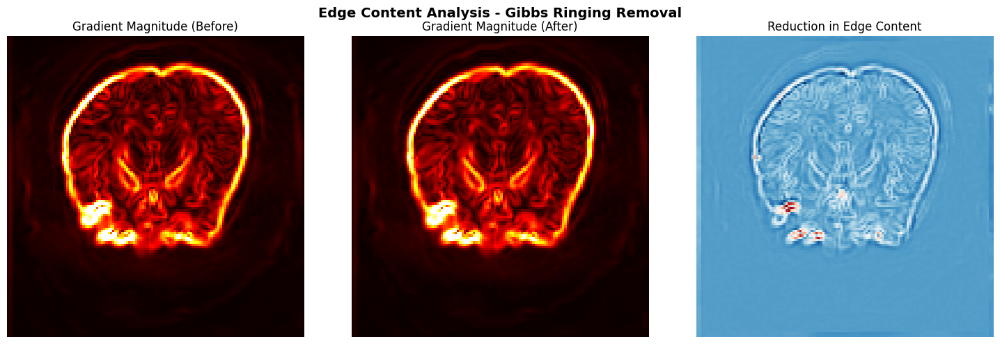


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


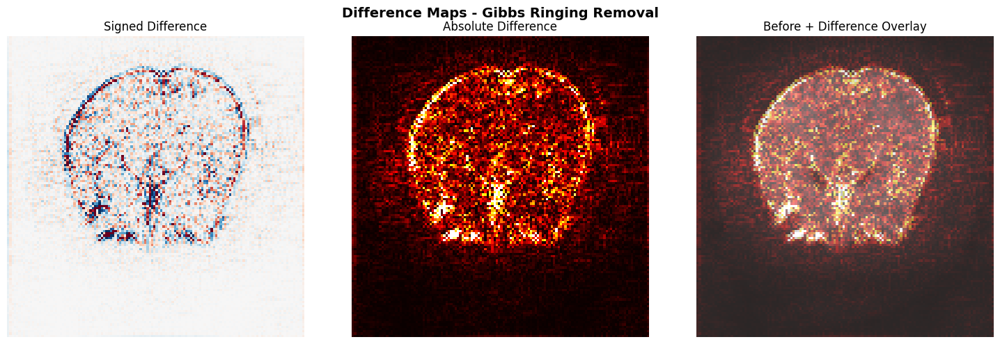


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 30.2487
  Mean Intensity After: 30.2354
  Std Intensity Before: 40.1417
  Std Intensity After: 39.9526
  Mean Gradient Before: 3.3479
  Mean Gradient After: 3.2968
  Gradient Reduction %: 1.5250
  High Freq Content Before: 10.3899
  High Freq Content After: 8.4290
  High Freq Reduction %: 18.8726
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 0.0133
  Std Difference: 1.1371
  Mean Abs Difference: 0.5208
  Max Abs Difference: 72.5151
  Voxels With Change: 60663


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


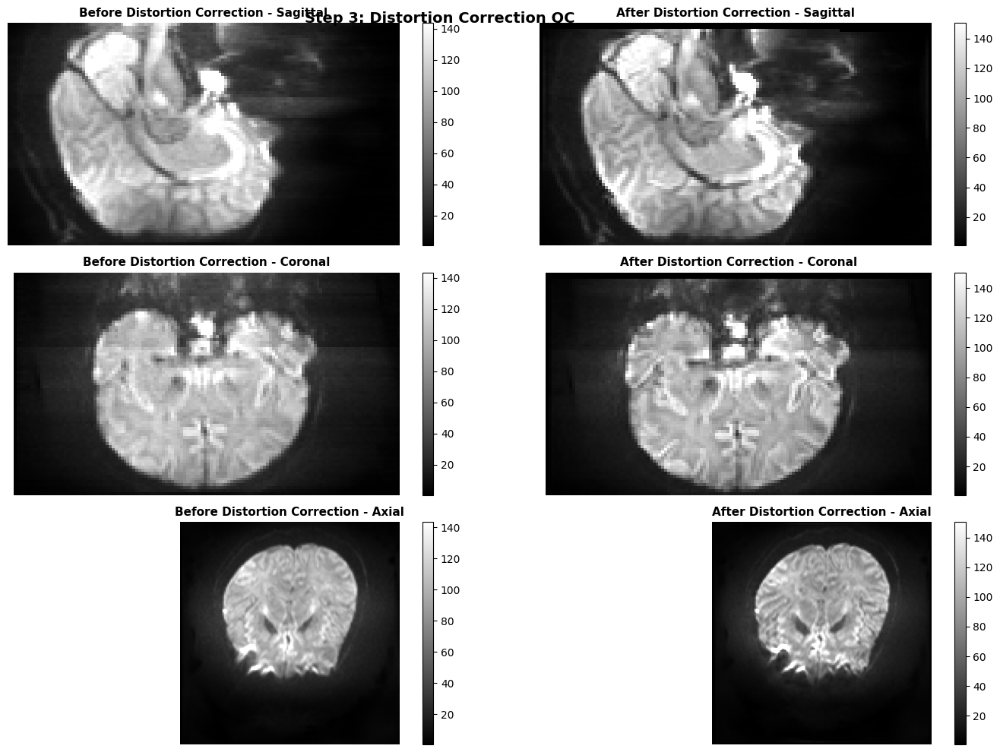


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


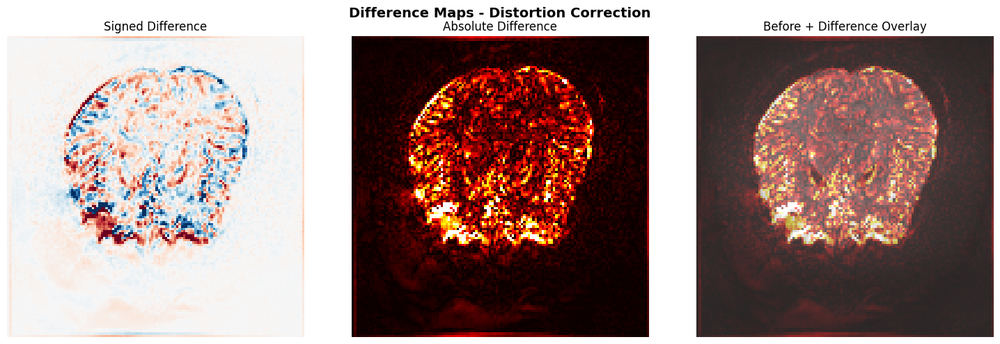


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 30.0129
  Mean Intensity After: 29.6108
  Std Intensity Before: 39.8788
  Std Intensity After: 40.9825
  Mean Difference: 0.4021
  Mean Abs Difference: 4.3624
  Max Abs Difference: 639.1129
  Voxels With Change: 61133


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


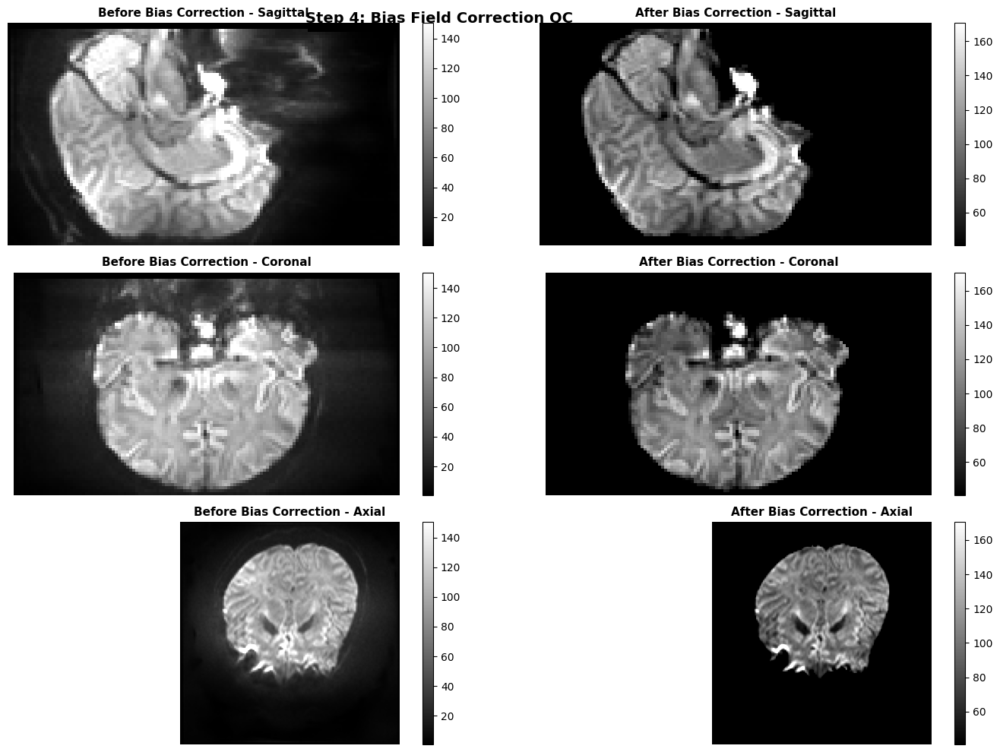


Difference Map (Before - After) - Shows where bias correction occurred


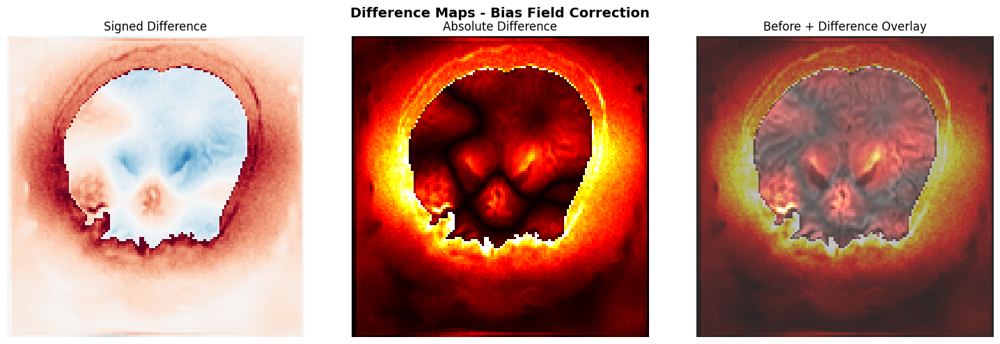


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 31.2505
  Mean Intensity After: 22.1035
  Std Intensity Before: 41.4568
  Std Intensity After: 44.0001
  Cv Before: 1.3266
  Cv After: 1.9906
  Cv Reduction %: -50.0560
  Mean Difference: 9.1470
  Mean Abs Difference: 10.7702
  Max Abs Difference: 415.9238
  Voxels With Change: 57977


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


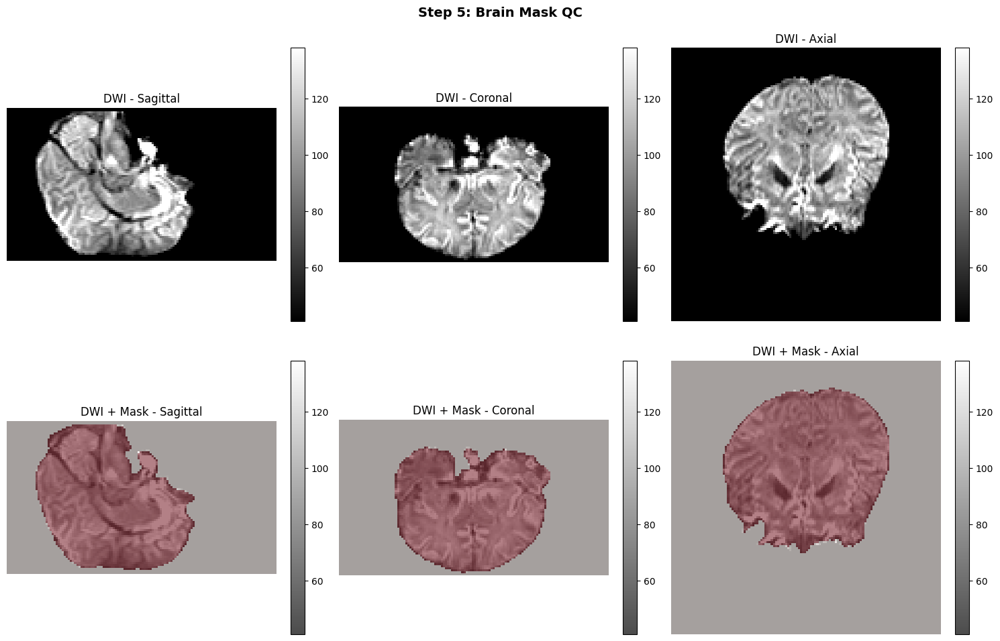


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.4365e+03
  Mask Voxels: 246316
  Coverage %: 104.4128
  Mean Intensity In Mask: 103.6408
  Mean Intensity Outside Mask: 50.4485


QC COMPLETE - See results above


In [ ]:
results_FSE = comprehensive_step_qc('sub-FSE')


COMPREHENSIVE STEP-BY-STEP QC: sub-GL

STEP 1: DENOISING QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


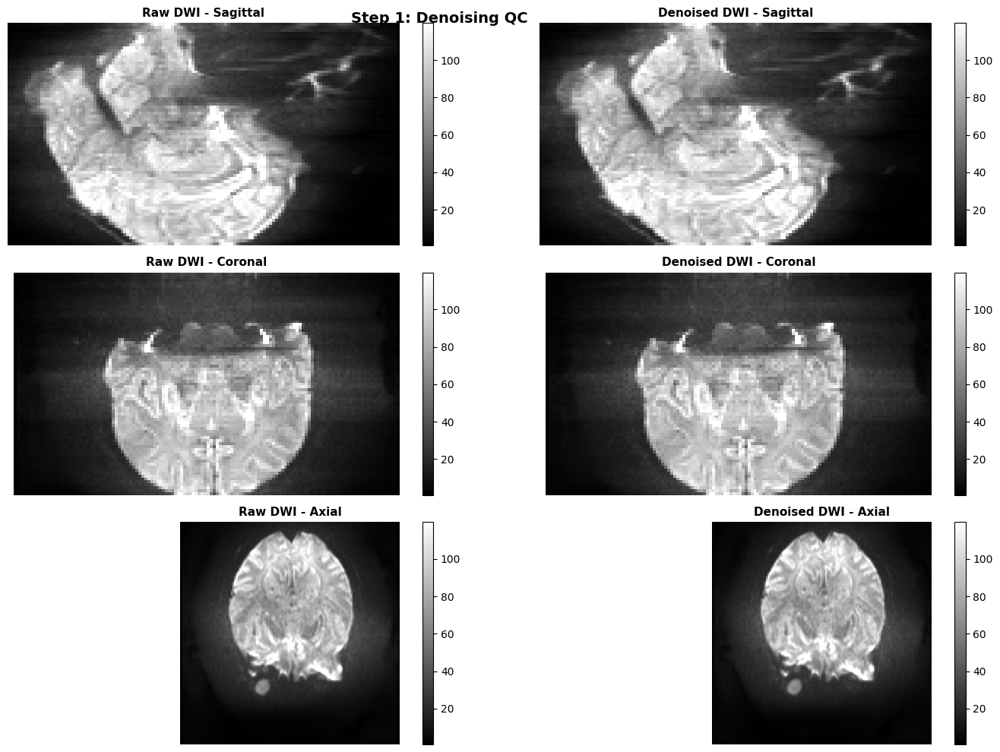


Noise Map Visualization


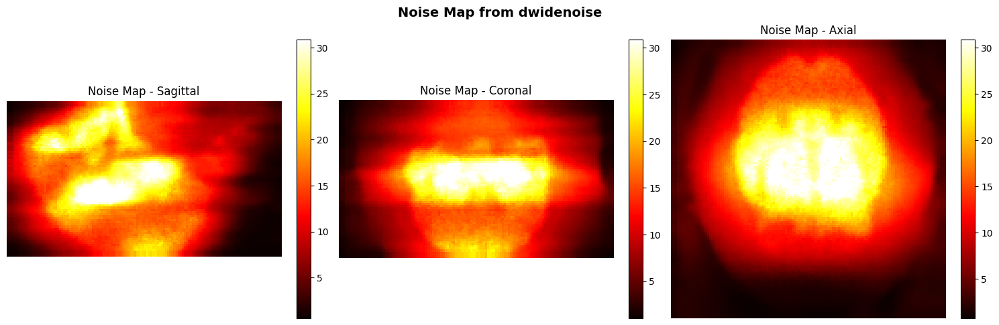


QC SUMMARY: Step 1: Denoising
  Snr Raw: 3.7501
  Snr Denoised: 3.7502
  Snr Improvement %: 4.6815e-03
  Mean Signal Raw: 27.5781
  Mean Signal Denoised: 27.5794
  Noise Std: 7.3541
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


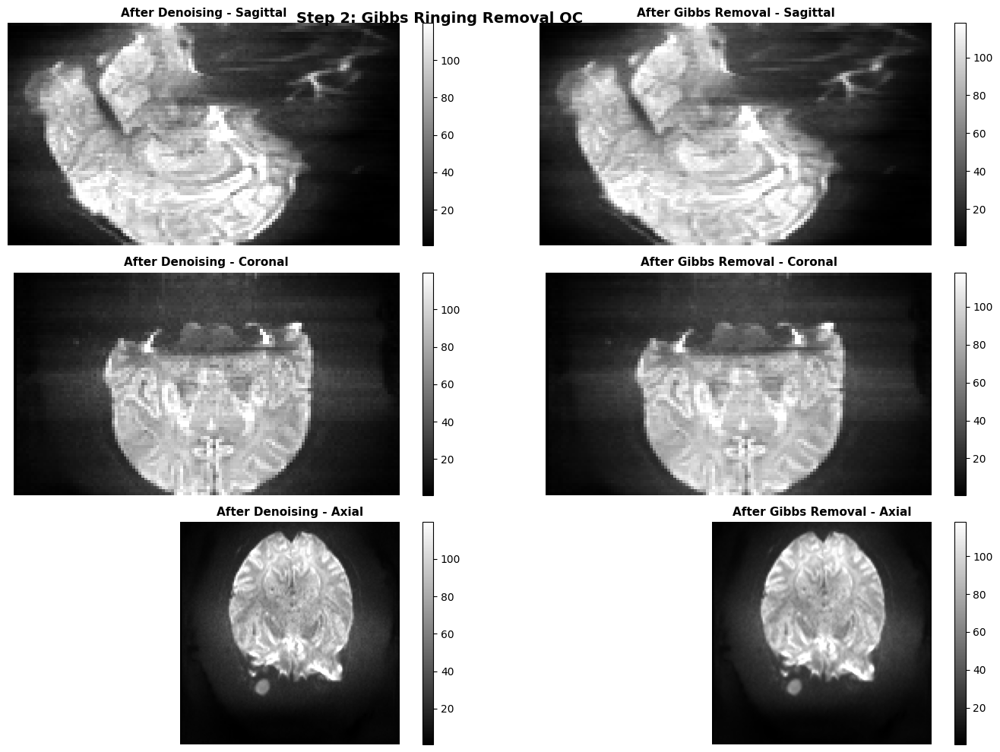


Edge Content Visualization (Gibbs ringing increases edge artifacts)


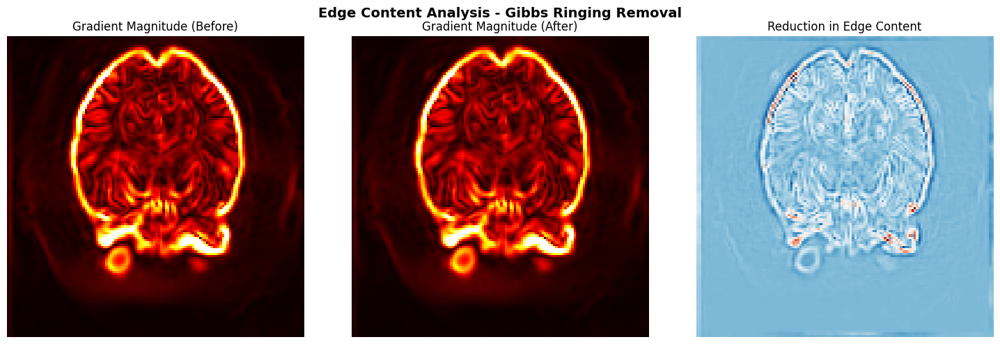


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


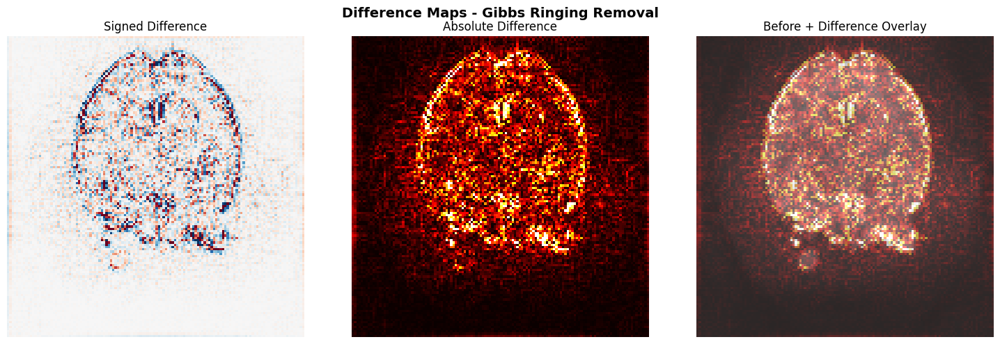


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 27.5794
  Mean Intensity After: 27.5693
  Std Intensity Before: 34.0738
  Std Intensity After: 33.9159
  Mean Gradient Before: 2.8402
  Mean Gradient After: 2.8006
  Gradient Reduction %: 1.3940
  High Freq Content Before: 10.6491
  High Freq Content After: 8.6079
  High Freq Reduction %: 19.1676
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 0.0101
  Std Difference: 1.0501
  Mean Abs Difference: 0.5145
  Max Abs Difference: 55.7950
  Voxels With Change: 60647


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


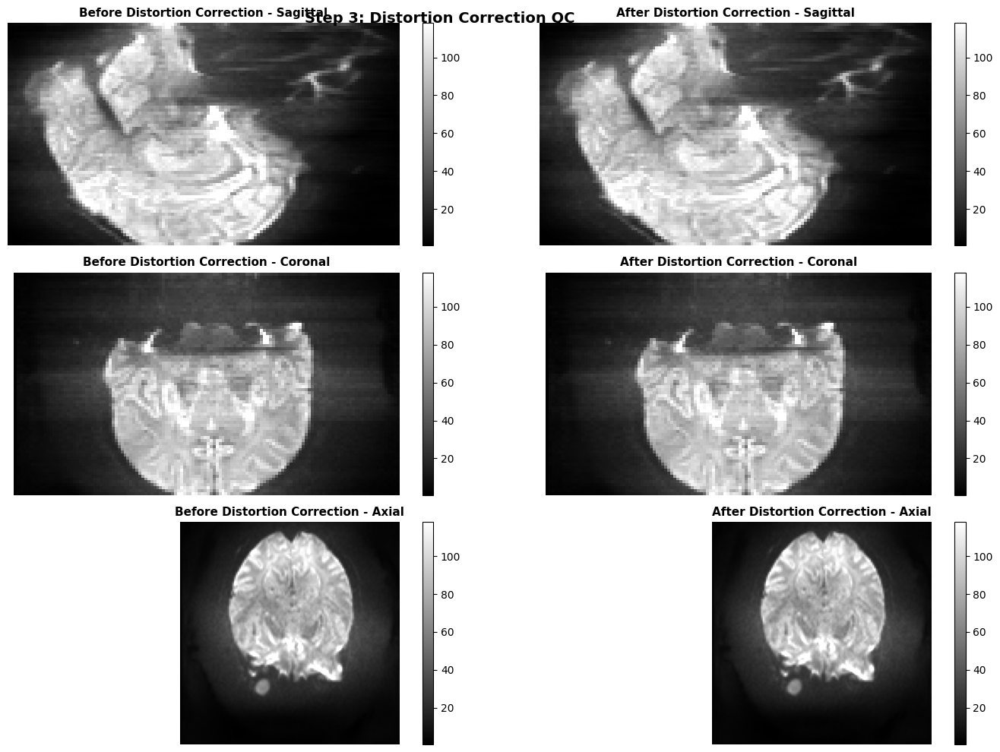


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


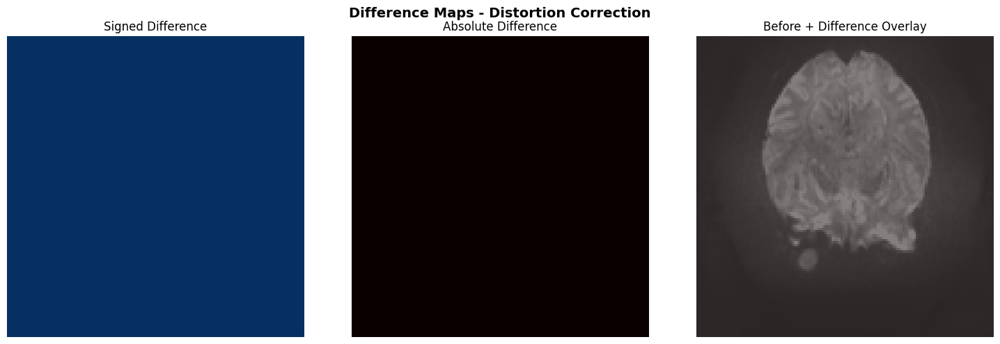


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 27.3606
  Mean Intensity After: 27.3606
  Std Intensity Before: 33.8611
  Std Intensity After: 33.8611
  Mean Difference: 0.0000e+00
  Mean Abs Difference: 0.0000e+00
  Max Abs Difference: 0.0000e+00
  Voxels With Change: 0


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


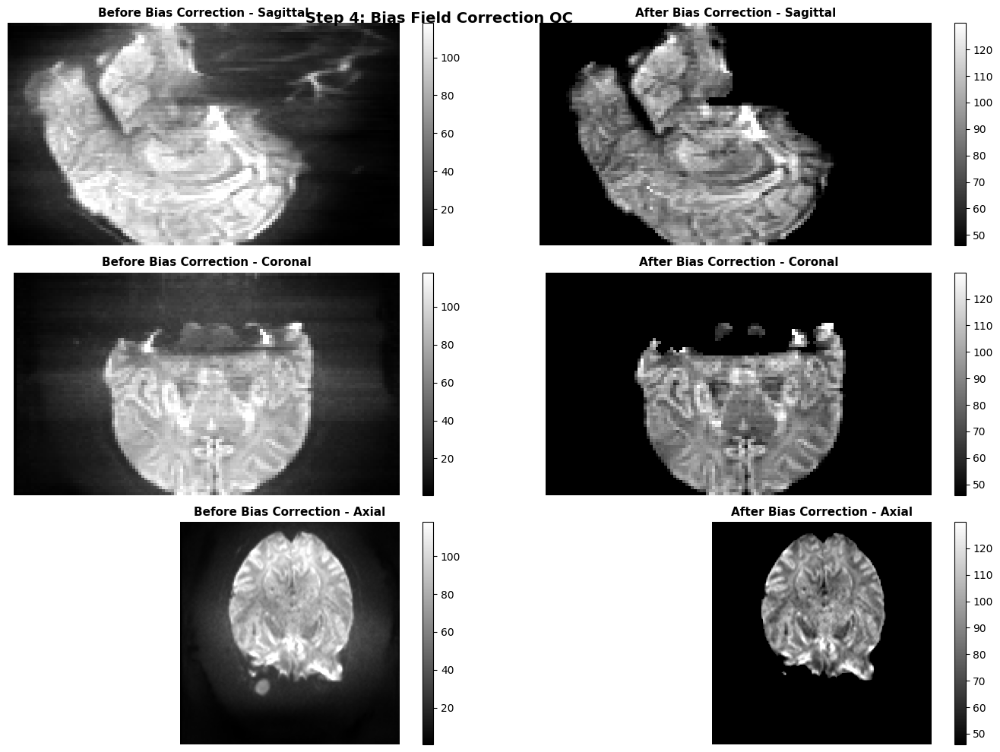


Difference Map (Before - After) - Shows where bias correction occurred


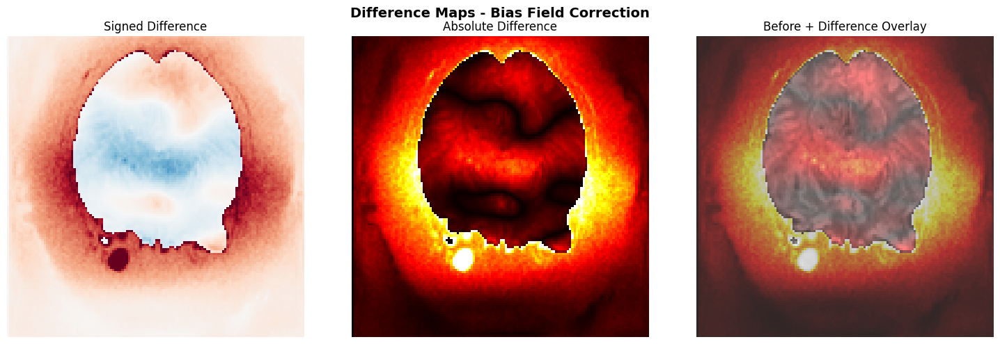


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 27.3606
  Mean Intensity After: 18.2439
  Std Intensity Before: 33.8611
  Std Intensity After: 36.7720
  Cv Before: 1.2376
  Cv After: 2.0156
  Cv Reduction %: -62.8635
  Mean Difference: 9.1167
  Mean Abs Difference: 10.4225
  Max Abs Difference: 216.8308
  Voxels With Change: 61133


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


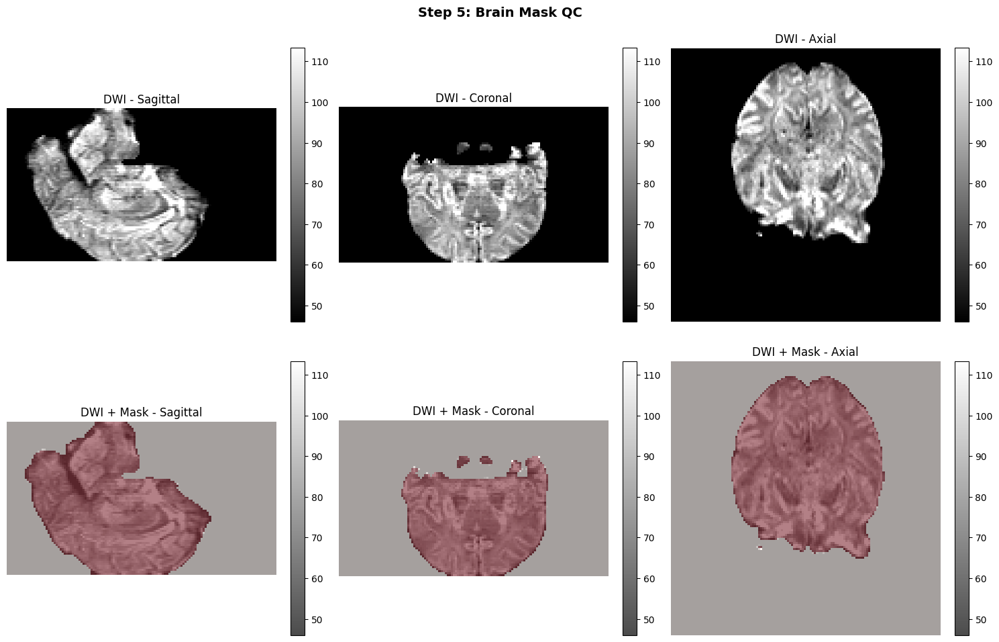


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.4515e+03
  Mask Voxels: 248880
  Coverage %: 104.8167
  Mean Intensity In Mask: 89.3778
  Mean Intensity Outside Mask: 58.0397


QC COMPLETE - See results above


In [38]:
results_GL = comprehensive_step_qc('sub-GL')


COMPREHENSIVE STEP-BY-STEP QC: sub-KJ

STEP 1: DENOISING QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


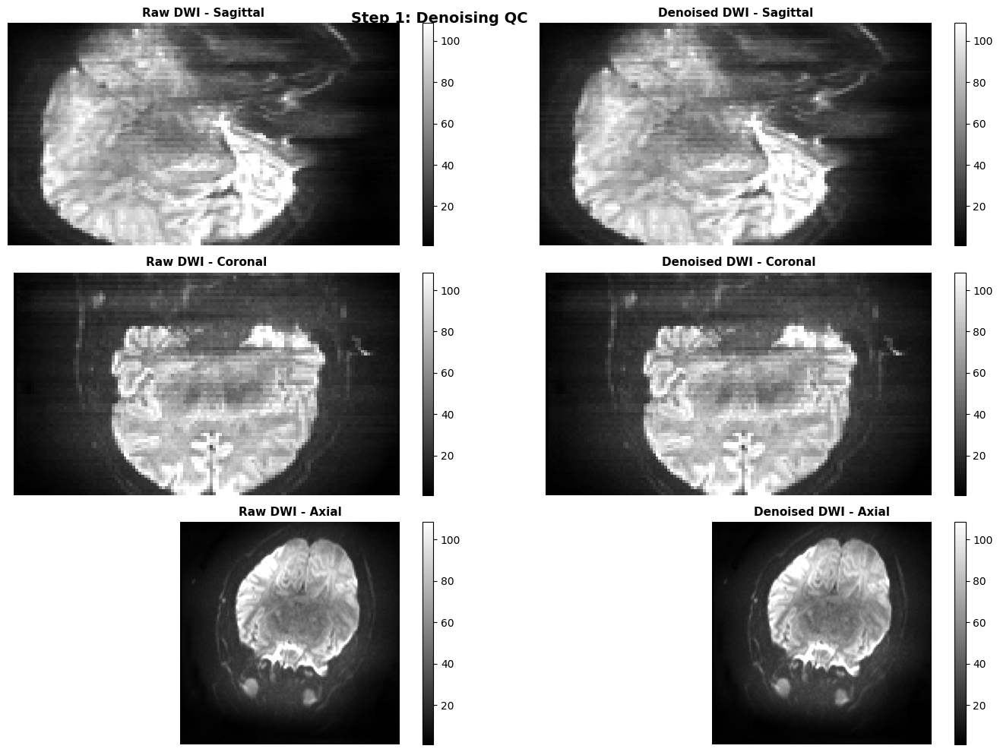


Noise Map Visualization


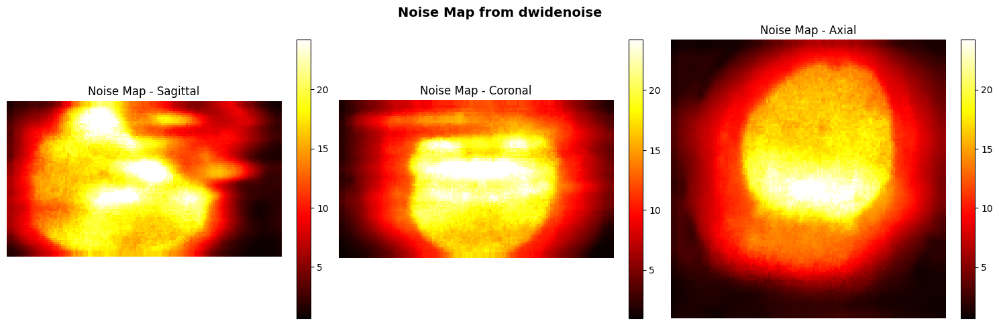


QC SUMMARY: Step 1: Denoising
  Snr Raw: 4.0611
  Snr Denoised: 4.0615
  Snr Improvement %: 0.0107
  Mean Signal Raw: 26.0298
  Mean Signal Denoised: 26.0326
  Noise Std: 6.4096
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


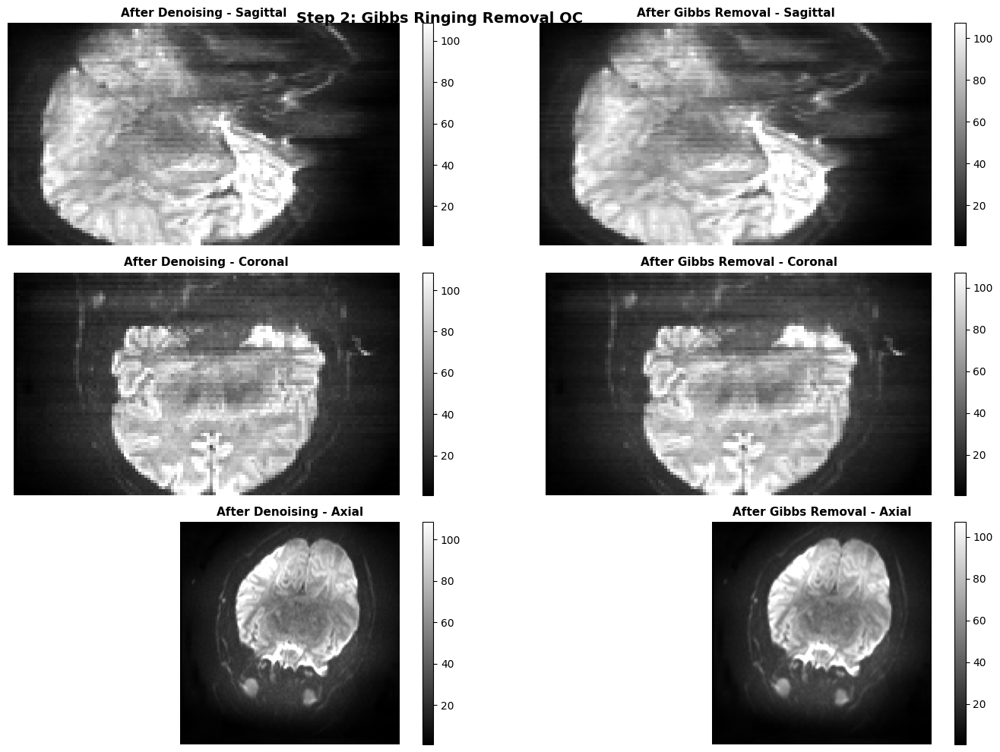


Edge Content Visualization (Gibbs ringing increases edge artifacts)


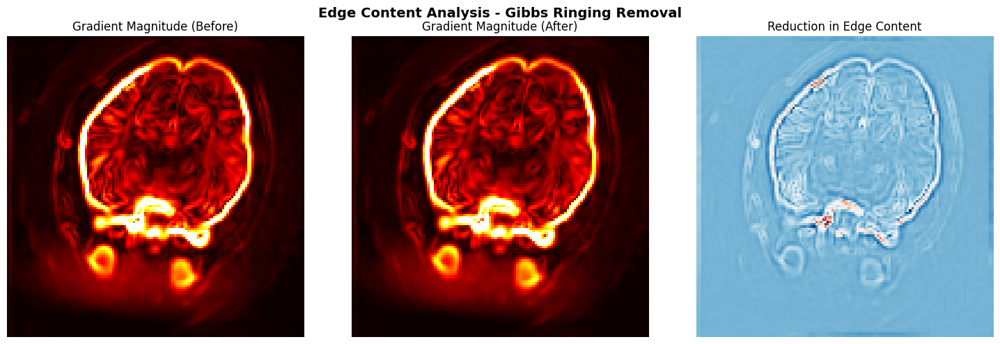


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


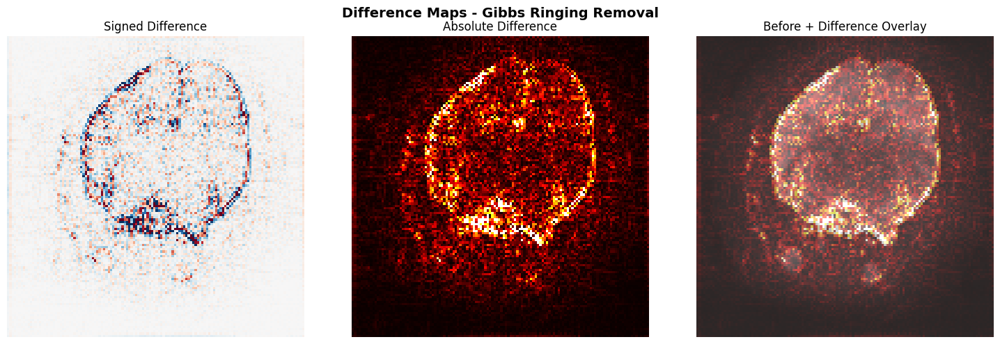


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 26.0326
  Mean Intensity After: 26.0282
  Std Intensity Before: 30.1434
  Std Intensity After: 30.0087
  Mean Gradient Before: 2.7152
  Mean Gradient After: 2.6799
  Gradient Reduction %: 1.3008
  High Freq Content Before: 9.8749
  High Freq Content After: 8.1324
  High Freq Reduction %: 17.6465
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 4.4286e-03
  Std Difference: 0.8936
  Mean Abs Difference: 0.4515
  Max Abs Difference: 41.9533
  Voxels With Change: 60611


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


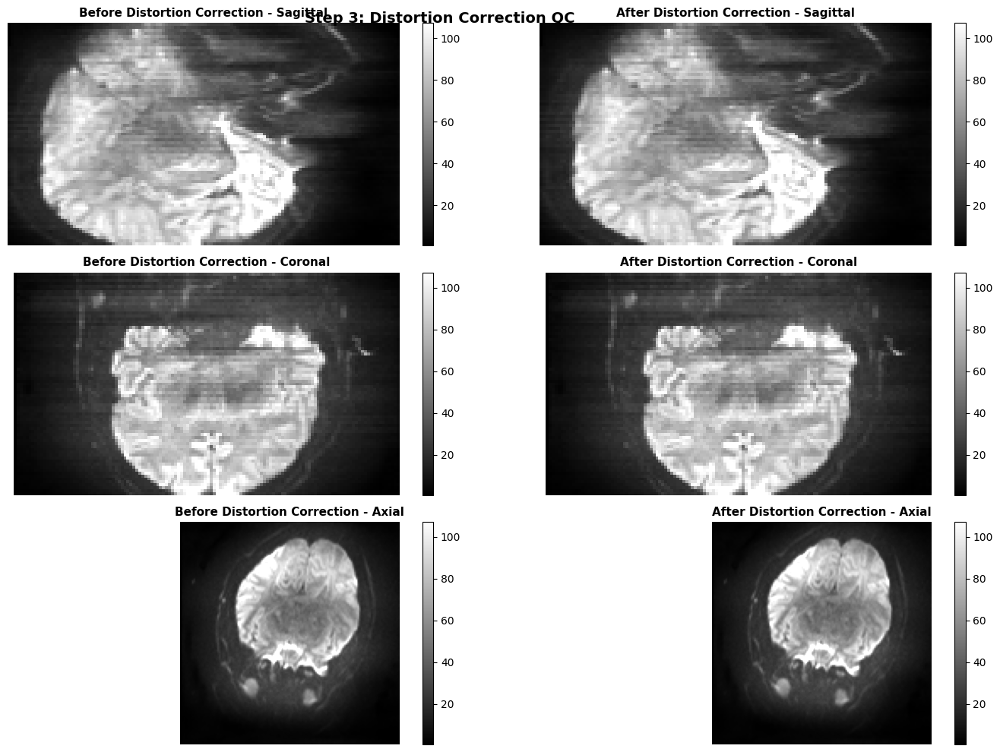


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


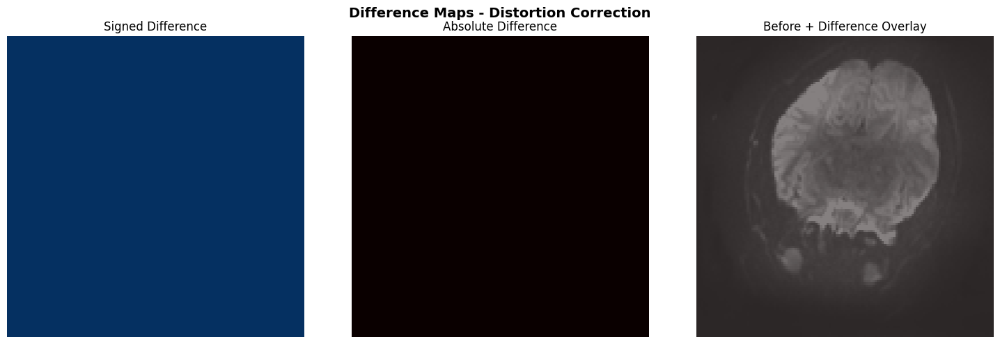


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 25.8175
  Mean Intensity After: 25.8175
  Std Intensity Before: 29.9664
  Std Intensity After: 29.9664
  Mean Difference: 0.0000e+00
  Mean Abs Difference: 0.0000e+00
  Max Abs Difference: 0.0000e+00
  Voxels With Change: 0


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


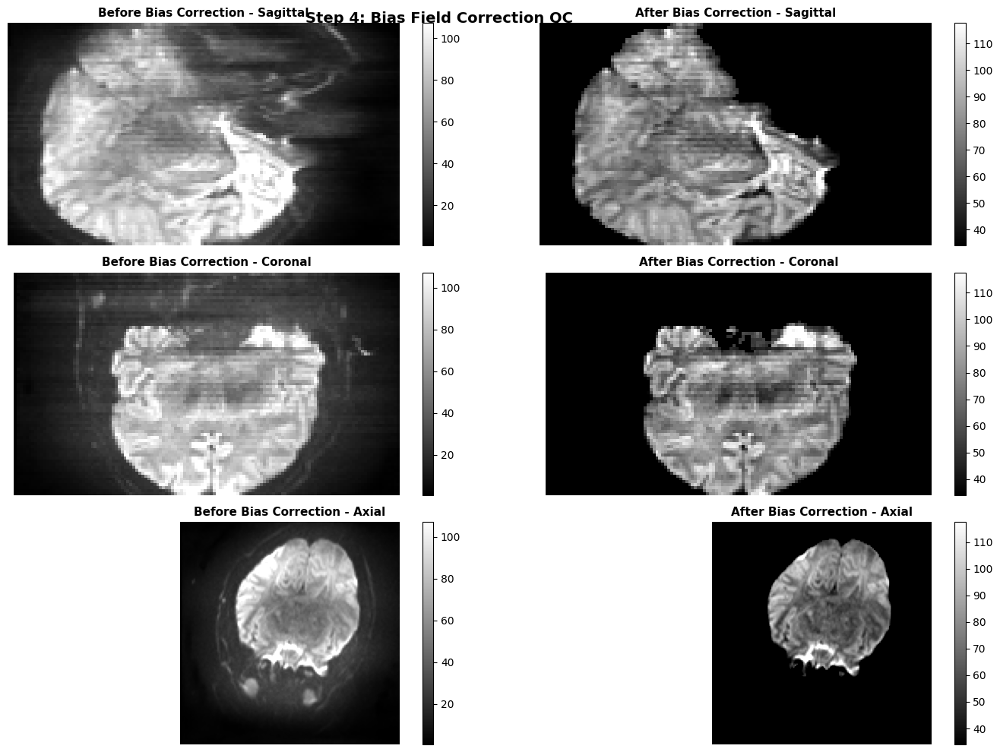


Difference Map (Before - After) - Shows where bias correction occurred


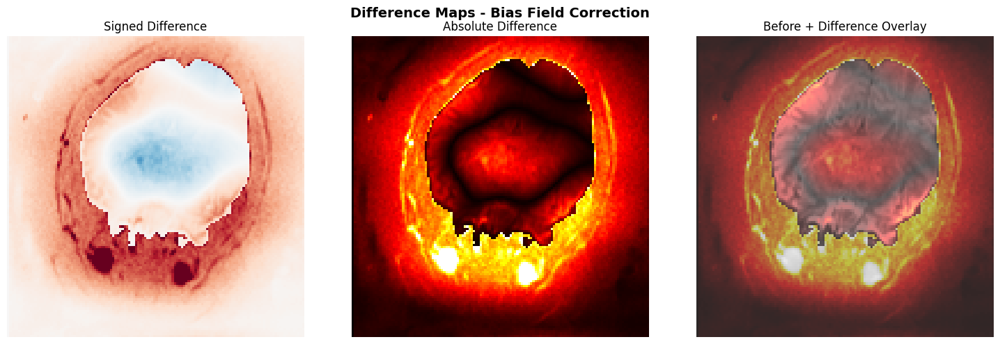


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 25.8175
  Mean Intensity After: 16.4685
  Std Intensity Before: 29.9664
  Std Intensity After: 32.7933
  Cv Before: 1.1607
  Cv After: 1.9913
  Cv Reduction %: -71.5575
  Mean Difference: 9.3489
  Mean Abs Difference: 10.5796
  Max Abs Difference: 259.5803
  Voxels With Change: 61133


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


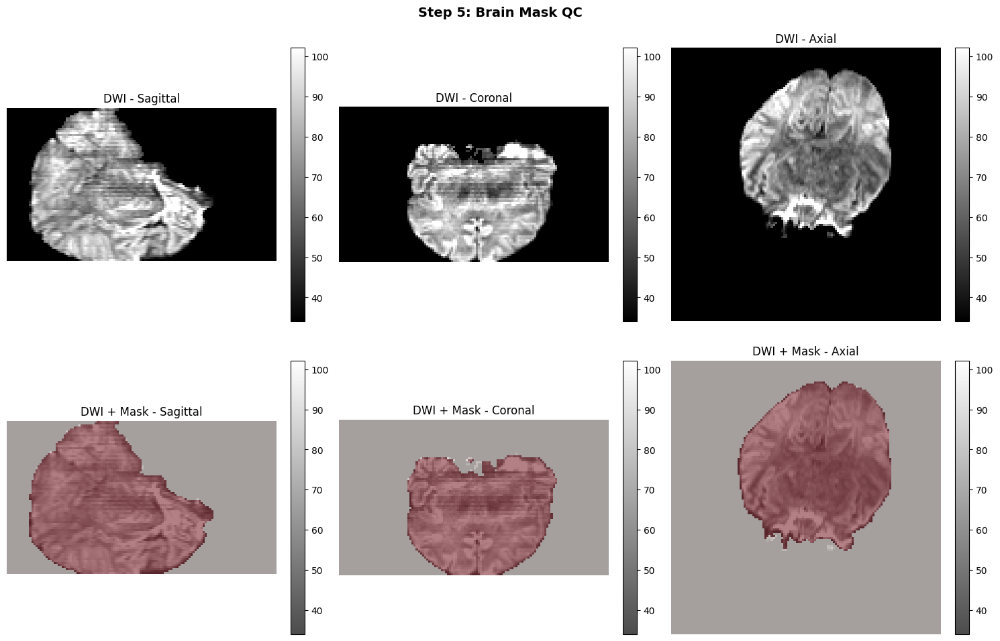


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.4878e+03
  Mask Voxels: 255111
  Coverage %: 104.4300
  Mean Intensity In Mask: 78.5857
  Mean Intensity Outside Mask: 42.8077


QC COMPLETE - See results above


In [39]:
results_KJ = comprehensive_step_qc('sub-KJ')


COMPREHENSIVE STEP-BY-STEP QC: sub-LL

STEP 1: DENOISING QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


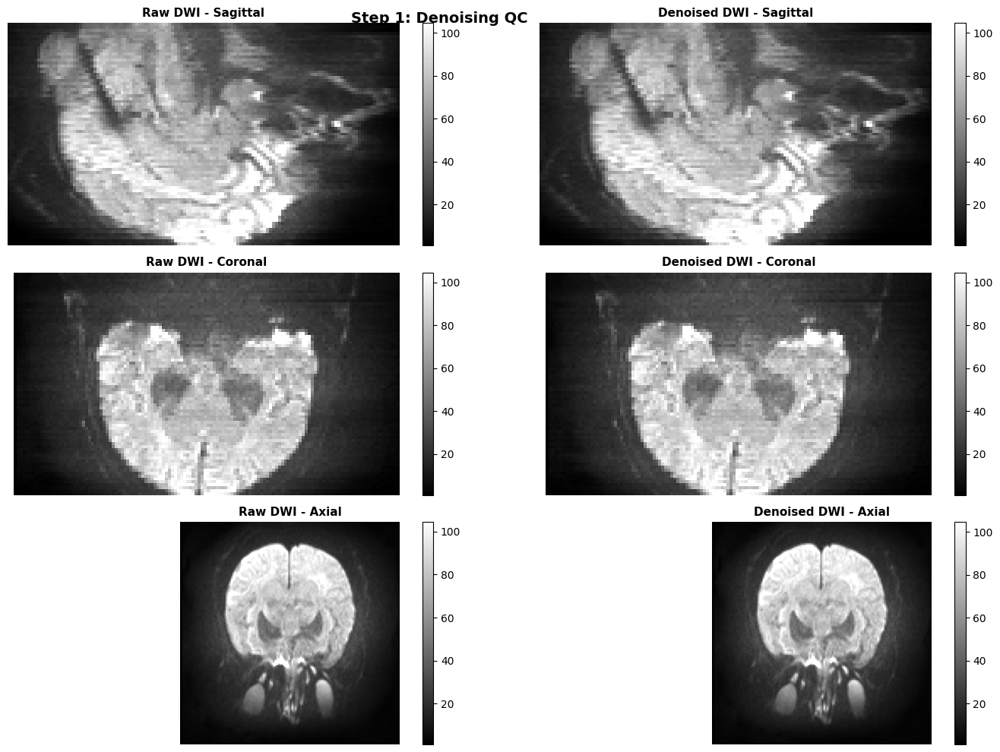


Noise Map Visualization


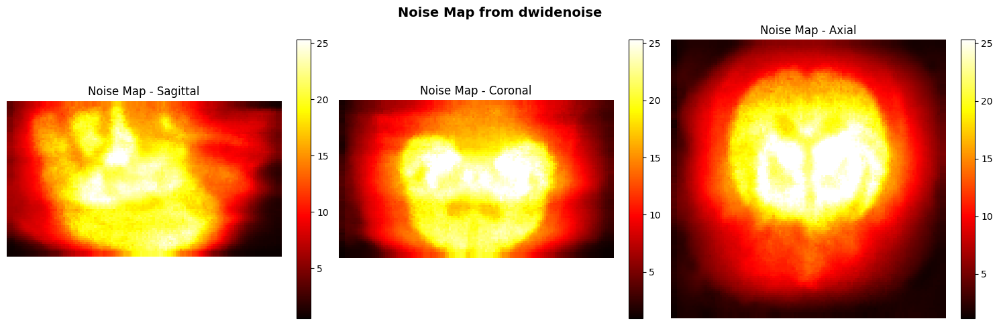


QC SUMMARY: Step 1: Denoising
  Snr Raw: 4.0583
  Snr Denoised: 4.0587
  Snr Improvement %: 7.9256e-03
  Mean Signal Raw: 27.3074
  Mean Signal Denoised: 27.3096
  Noise Std: 6.7287
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


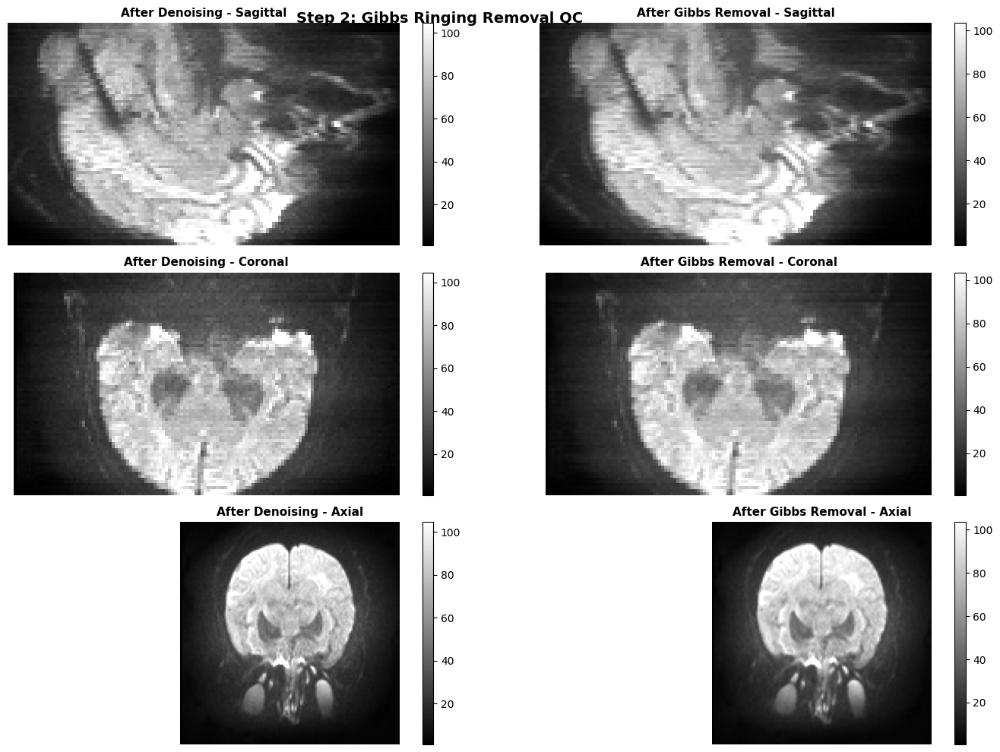


Edge Content Visualization (Gibbs ringing increases edge artifacts)


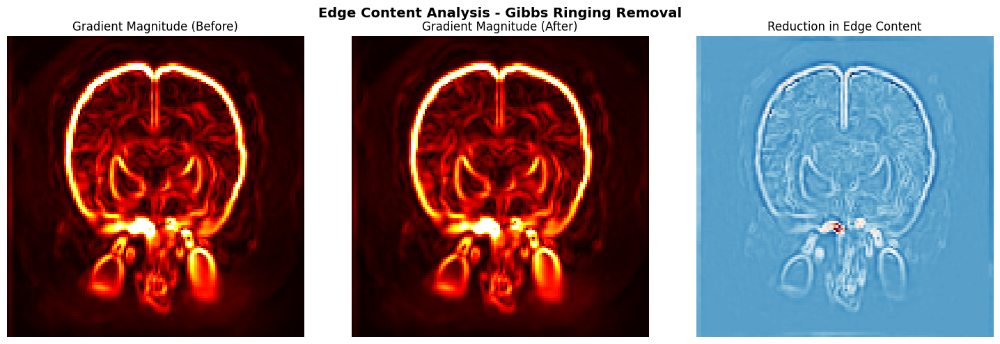


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


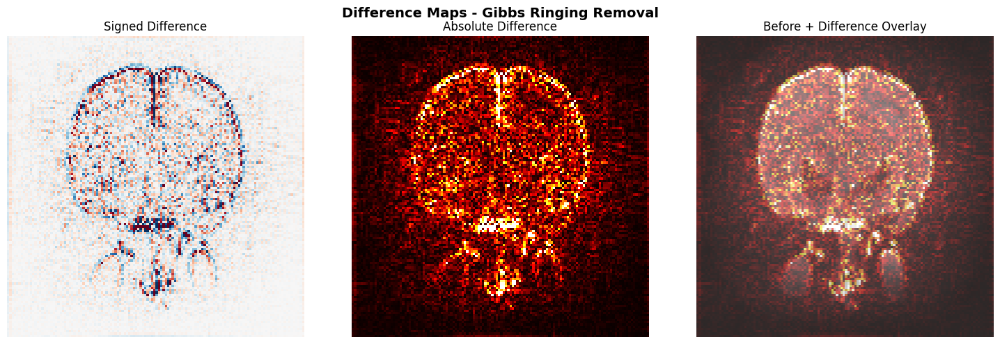


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 27.3096
  Mean Intensity After: 27.3034
  Std Intensity Before: 29.5949
  Std Intensity After: 29.4831
  Mean Gradient Before: 2.5449
  Mean Gradient After: 2.5139
  Gradient Reduction %: 1.2167
  High Freq Content Before: 9.8935
  High Freq Content After: 8.0766
  High Freq Reduction %: 18.3641
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 6.1571e-03
  Std Difference: 0.8389
  Mean Abs Difference: 0.4596
  Max Abs Difference: 36.4048
  Voxels With Change: 60663


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


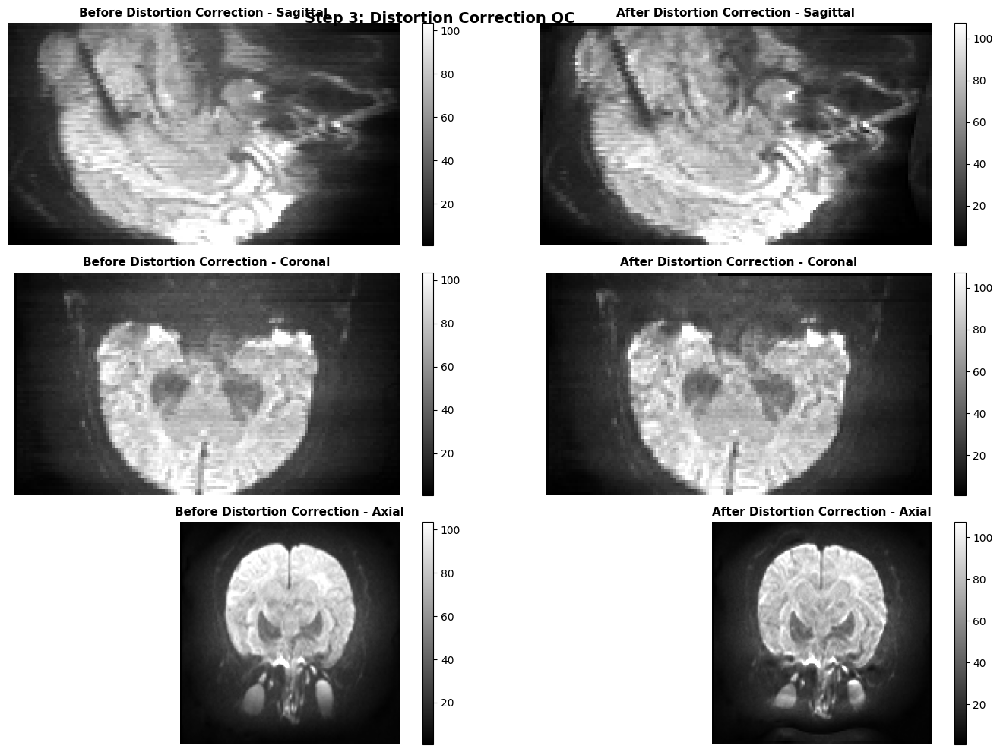


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


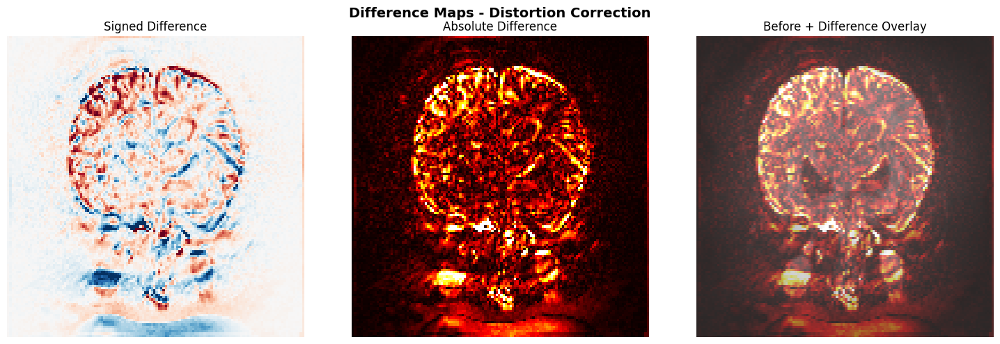


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 27.1050
  Mean Intensity After: 27.1044
  Std Intensity Before: 29.4558
  Std Intensity After: 30.2218
  Mean Difference: 5.6495e-04
  Mean Abs Difference: 2.5877
  Max Abs Difference: 250.6522
  Voxels With Change: 61133


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


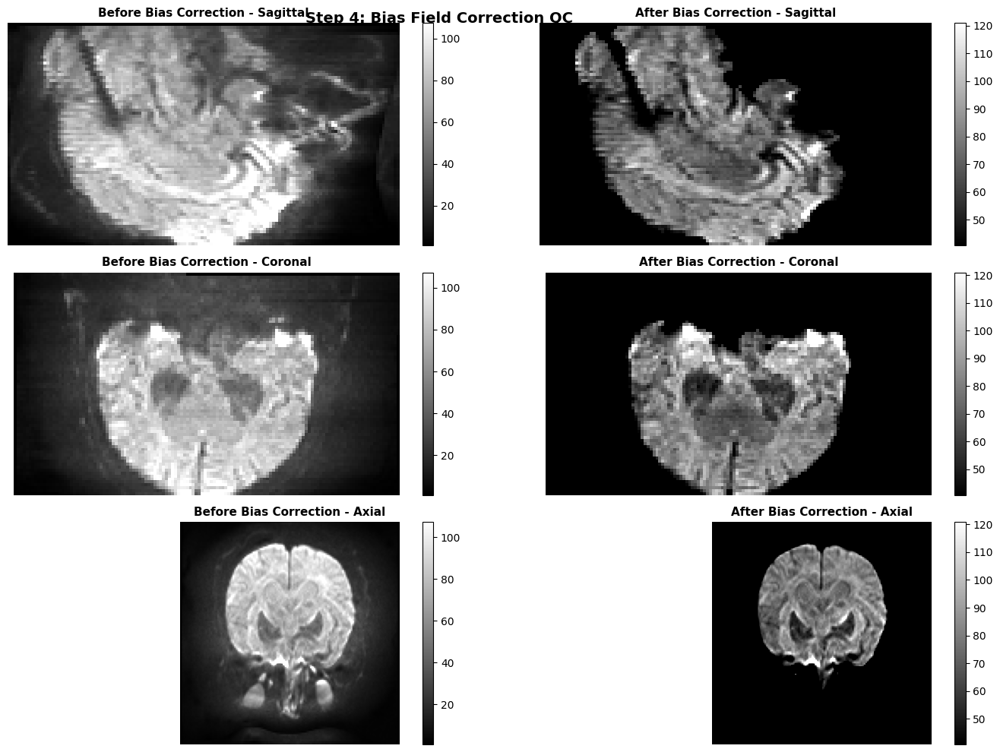


Difference Map (Before - After) - Shows where bias correction occurred


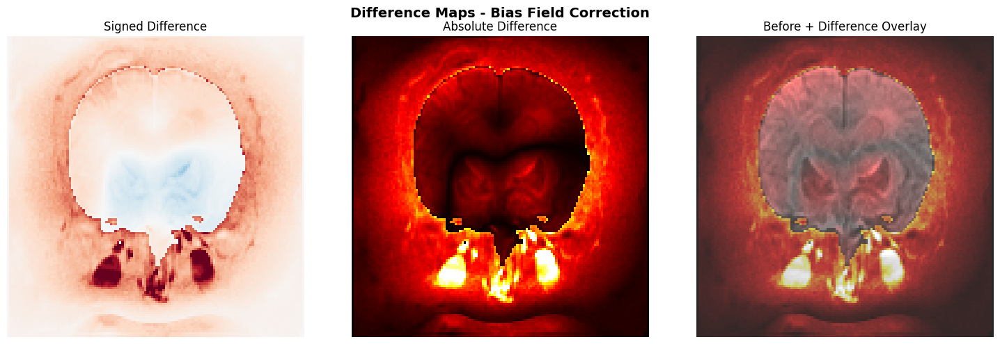


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 27.8050
  Mean Intensity After: 17.2863
  Std Intensity Before: 30.2933
  Std Intensity After: 33.5988
  Cv Before: 1.0895
  Cv After: 1.9437
  Cv Reduction %: -78.4017
  Mean Difference: 10.5187
  Mean Abs Difference: 12.0973
  Max Abs Difference: 373.4138
  Voxels With Change: 59587


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


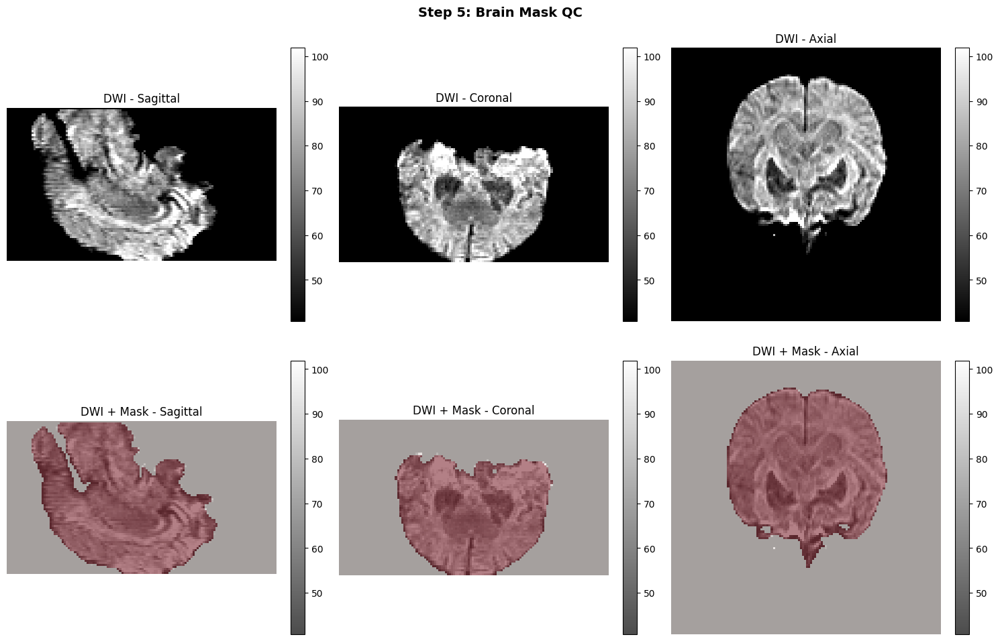


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.5075e+03
  Mask Voxels: 258486
  Coverage %: 104.5216
  Mean Intensity In Mask: 79.3547
  Mean Intensity Outside Mask: 48.3010


QC COMPLETE - See results above


In [40]:
results_LL = comprehensive_step_qc('sub-LL')


COMPREHENSIVE STEP-BY-STEP QC: sub-MF

STEP 1: DENOISING QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


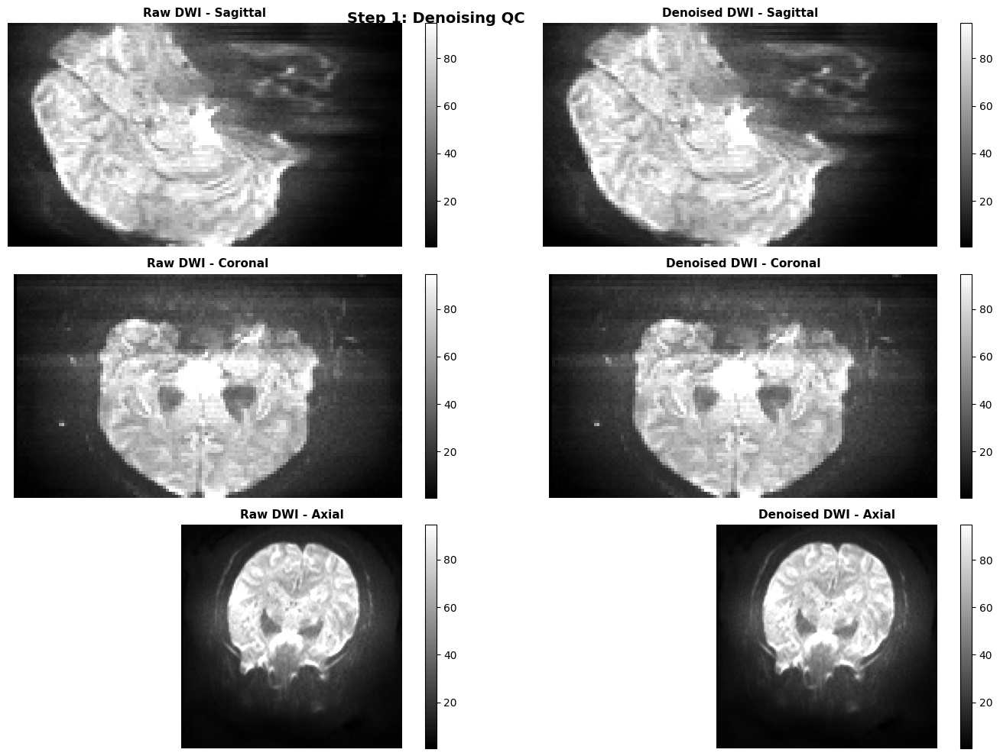


Noise Map Visualization


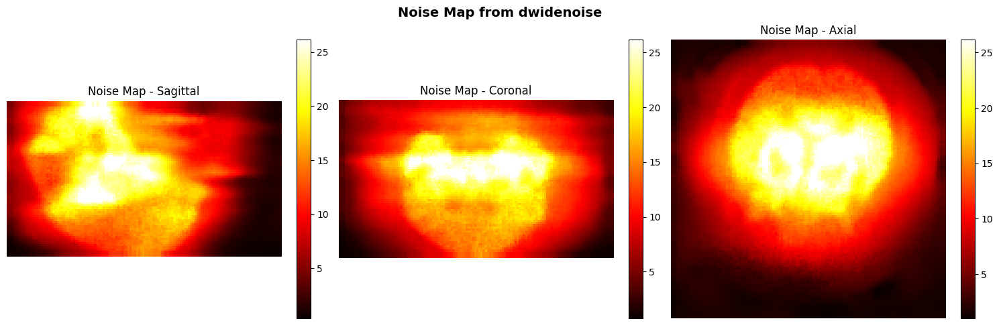


QC SUMMARY: Step 1: Denoising
  Snr Raw: 3.7594
  Snr Denoised: 3.7597
  Snr Improvement %: 9.1522e-03
  Mean Signal Raw: 24.8652
  Mean Signal Denoised: 24.8675
  Noise Std: 6.6141
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


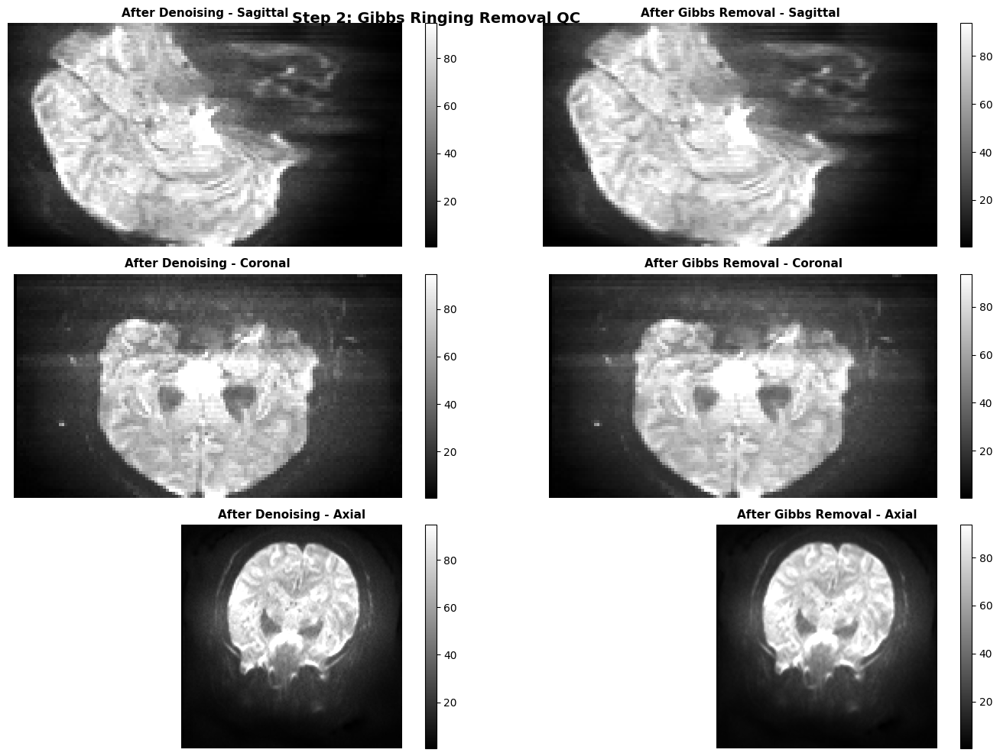


Edge Content Visualization (Gibbs ringing increases edge artifacts)


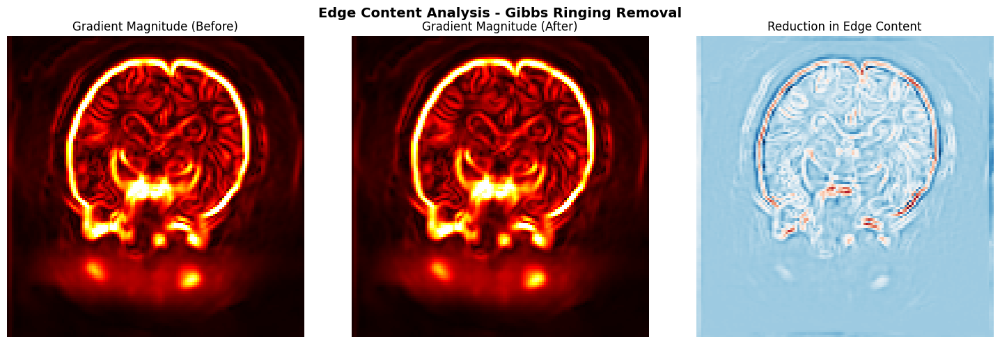


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


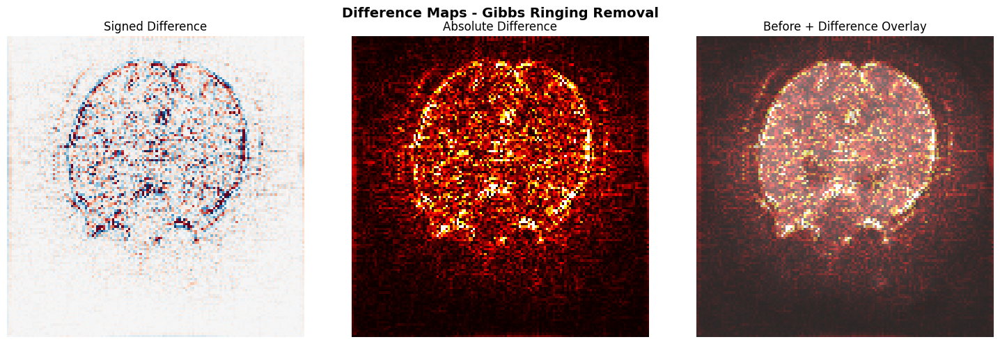


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 24.8675
  Mean Intensity After: 24.8592
  Std Intensity Before: 27.3953
  Std Intensity After: 27.2981
  Mean Gradient Before: 2.4060
  Mean Gradient After: 2.3748
  Gradient Reduction %: 1.2950
  High Freq Content Before: 8.4672
  High Freq Content After: 6.8160
  High Freq Reduction %: 19.5003
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 8.2857e-03
  Std Difference: 0.7317
  Mean Abs Difference: 0.4096
  Max Abs Difference: 34.2086
  Voxels With Change: 60662


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


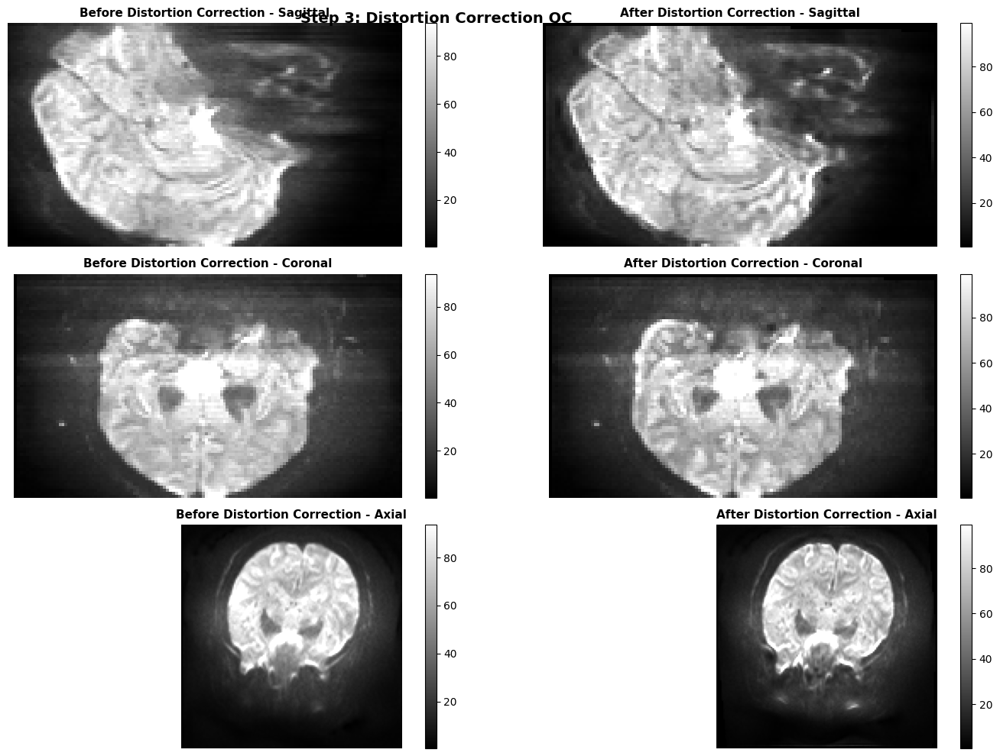


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


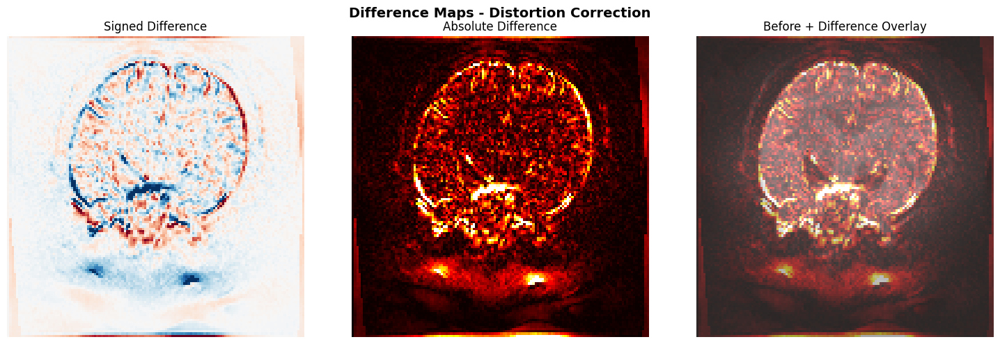


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 24.6772
  Mean Intensity After: 24.3785
  Std Intensity Before: 27.2711
  Std Intensity After: 28.3151
  Mean Difference: 0.2986
  Mean Abs Difference: 2.5700
  Max Abs Difference: 212.6374
  Voxels With Change: 61133


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


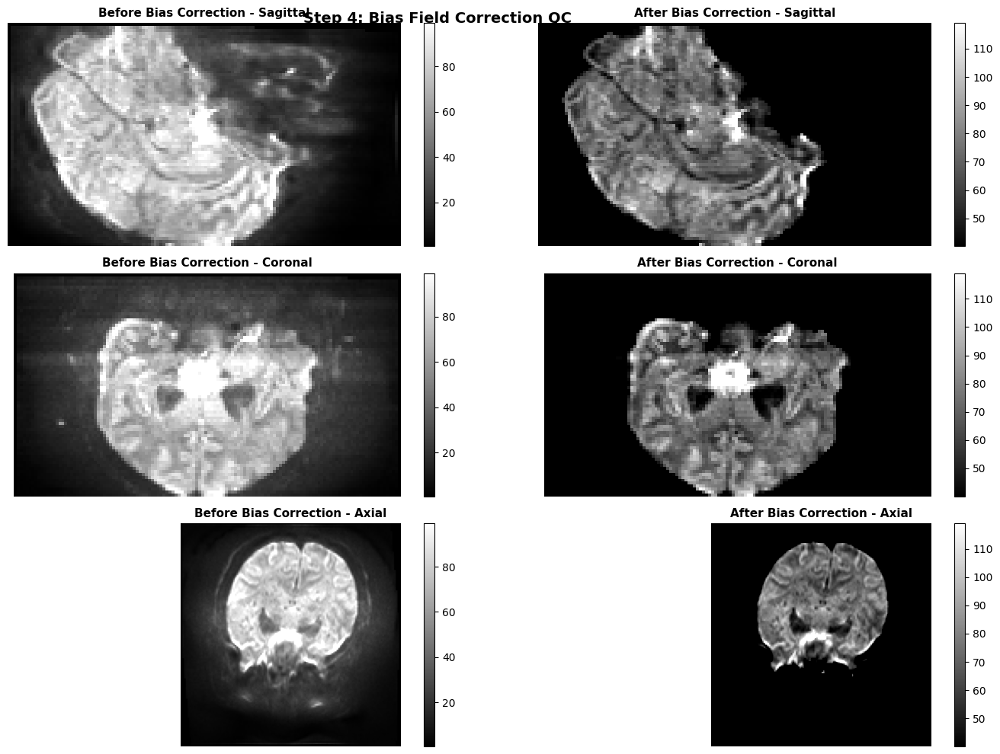


Difference Map (Before - After) - Shows where bias correction occurred


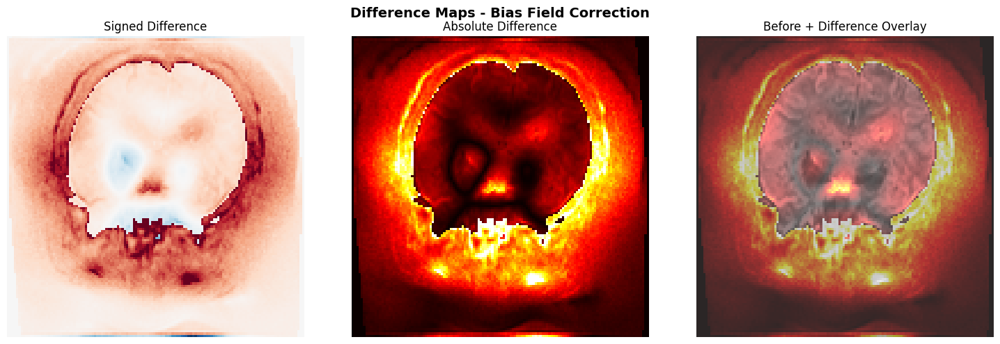


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 26.0023
  Mean Intensity After: 16.3602
  Std Intensity Before: 28.4692
  Std Intensity After: 31.6727
  Cv Before: 1.0949
  Cv After: 1.9360
  Cv Reduction %: -76.8201
  Mean Difference: 9.6421
  Mean Abs Difference: 10.6859
  Max Abs Difference: 417.3794
  Voxels With Change: 57384


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


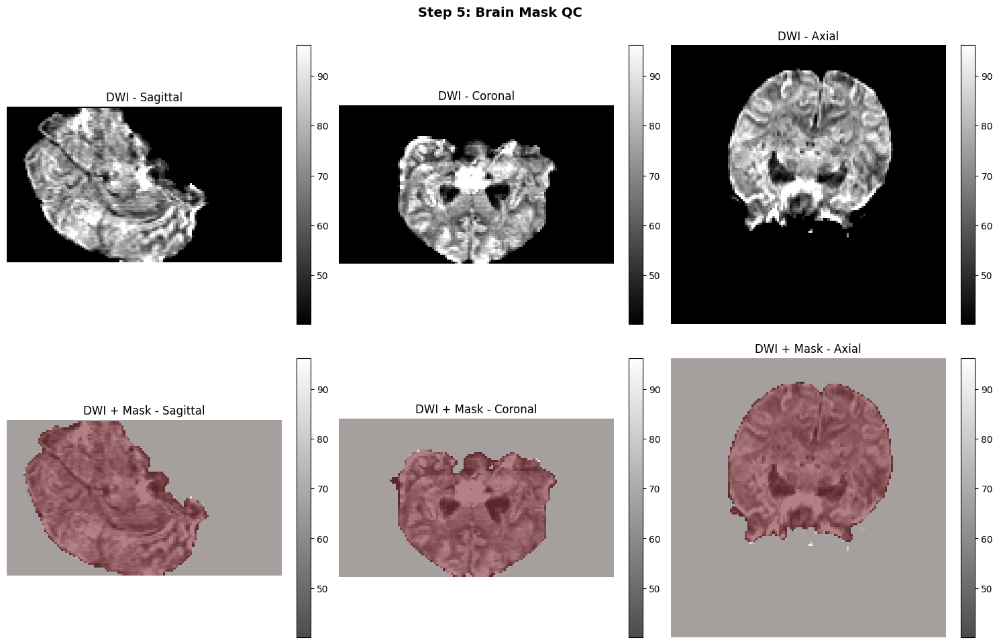


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.4677e+03
  Mask Voxels: 251671
  Coverage %: 104.6606
  Mean Intensity In Mask: 74.3279
  Mean Intensity Outside Mask: 48.3721


QC COMPLETE - See results above


In [41]:
results_MF = comprehensive_step_qc('sub-MF')


COMPREHENSIVE STEP-BY-STEP QC: sub-PB

STEP 1: DENOISING QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


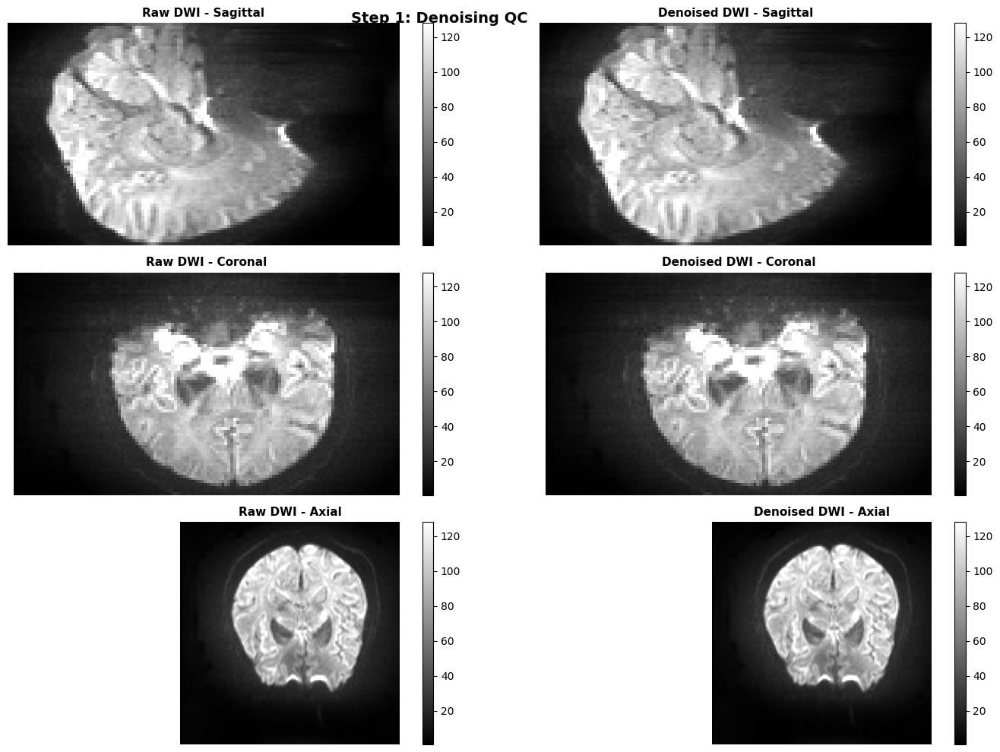


Noise Map Visualization


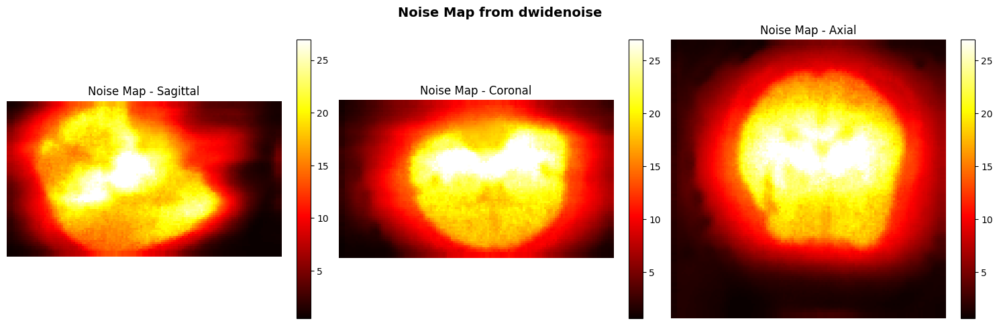


QC SUMMARY: Step 1: Denoising
  Snr Raw: 3.9729
  Snr Denoised: 3.9731
  Snr Improvement %: 2.9281e-03
  Mean Signal Raw: 28.2195
  Mean Signal Denoised: 28.2203
  Noise Std: 7.1029
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


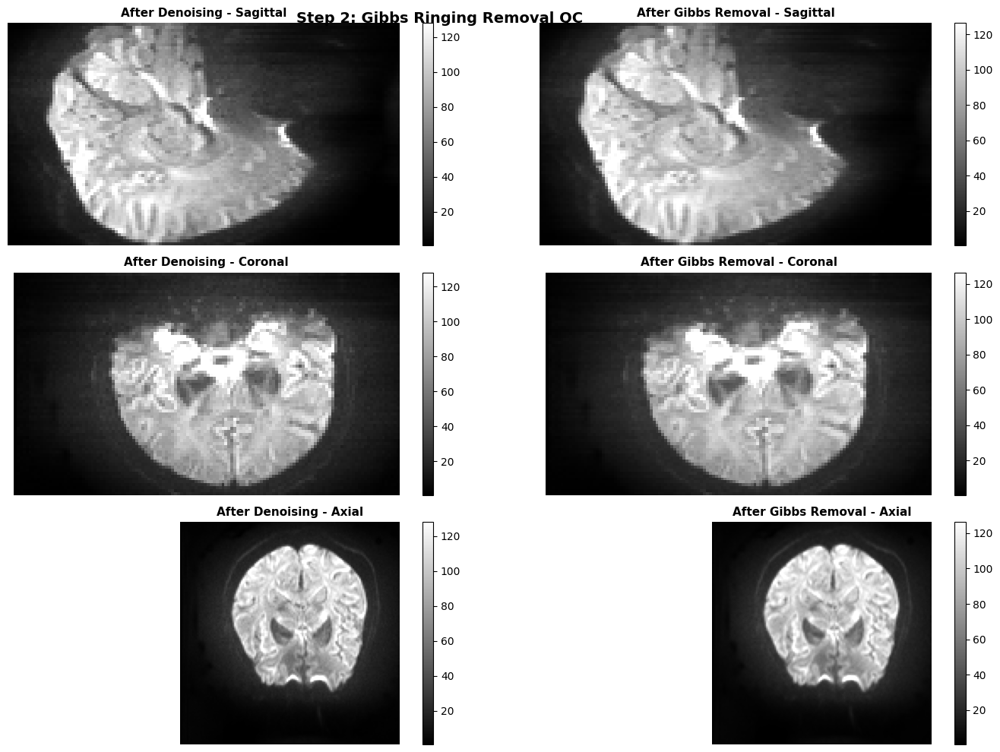


Edge Content Visualization (Gibbs ringing increases edge artifacts)


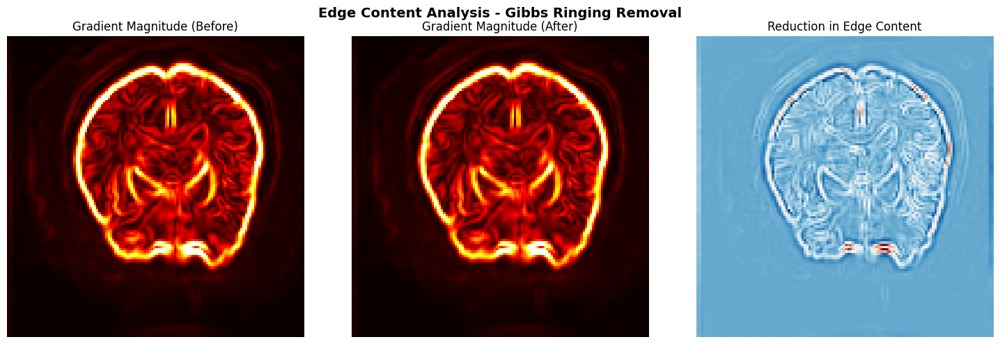


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


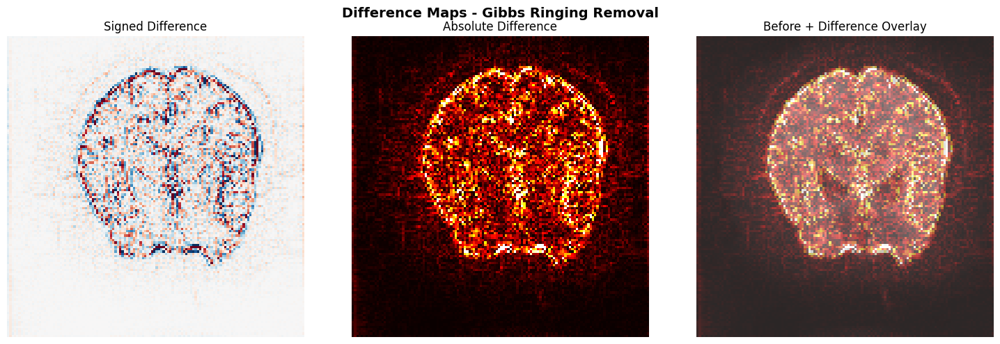


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 28.2203
  Mean Intensity After: 28.2097
  Std Intensity Before: 36.5458
  Std Intensity After: 36.3858
  Mean Gradient Before: 2.9966
  Mean Gradient After: 2.9545
  Gradient Reduction %: 1.4045
  High Freq Content Before: 10.5234
  High Freq Content After: 8.5623
  High Freq Reduction %: 18.6357
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 0.0106
  Std Difference: 1.0294
  Mean Abs Difference: 0.4900
  Max Abs Difference: 46.9053
  Voxels With Change: 60662


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


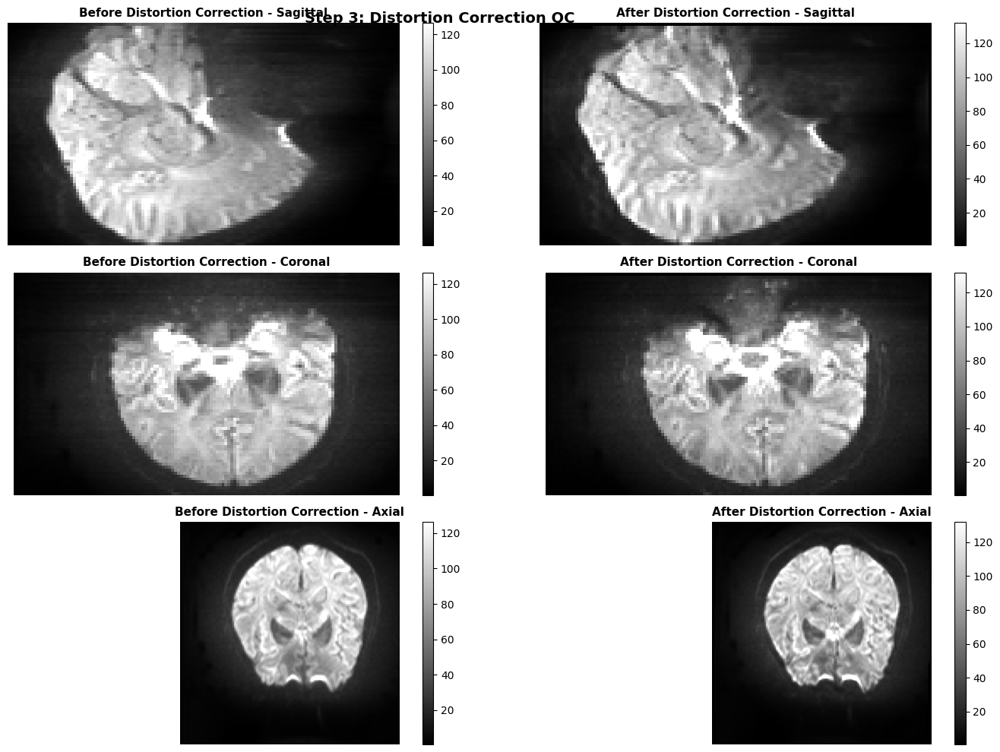


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


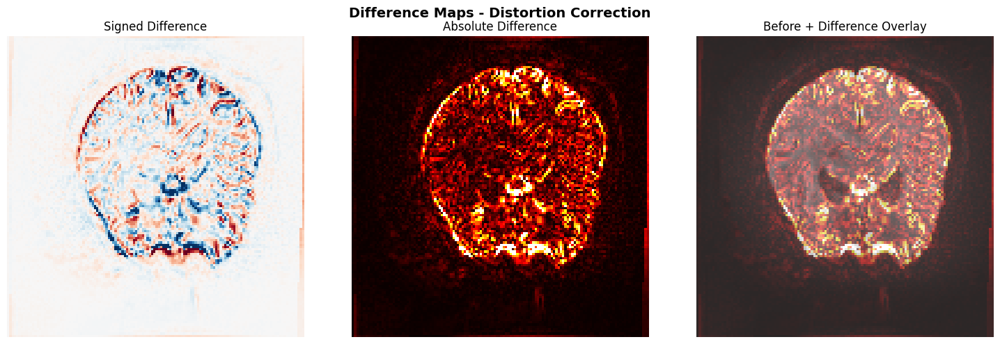


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 28.0016
  Mean Intensity After: 27.7793
  Std Intensity Before: 36.3225
  Std Intensity After: 37.4006
  Mean Difference: 0.2223
  Mean Abs Difference: 2.7721
  Max Abs Difference: 324.7745
  Voxels With Change: 61133


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


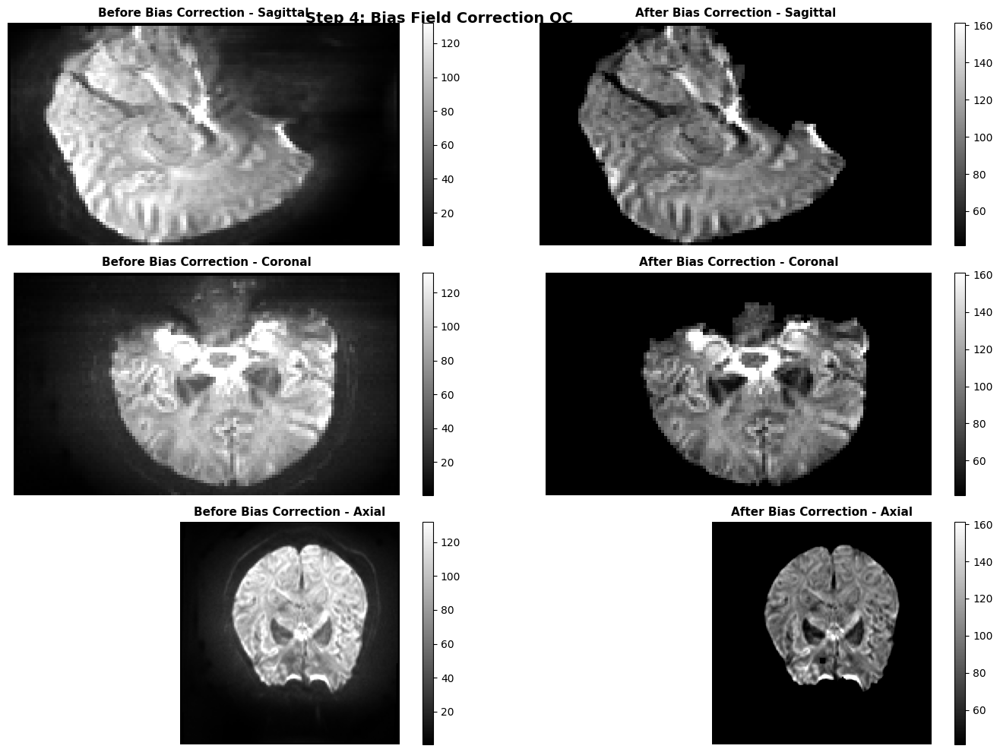


Difference Map (Before - After) - Shows where bias correction occurred


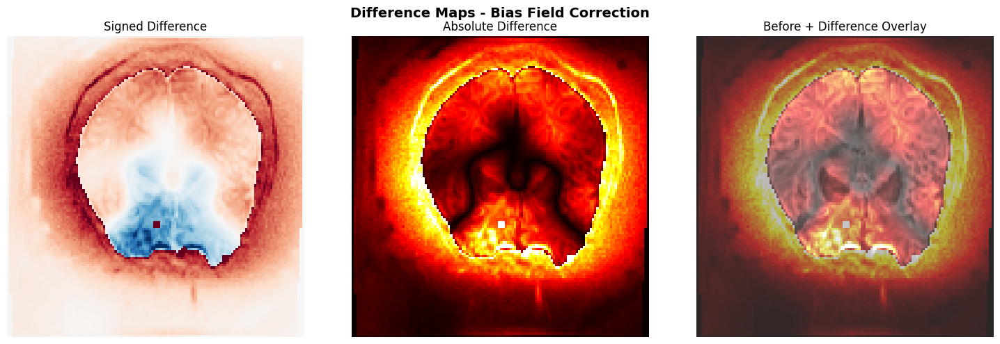


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 29.1227
  Mean Intensity After: 20.5707
  Std Intensity Before: 37.7749
  Std Intensity After: 40.6457
  Cv Before: 1.2971
  Cv After: 1.9759
  Cv Reduction %: -52.3330
  Mean Difference: 8.5520
  Mean Abs Difference: 10.1530
  Max Abs Difference: 334.7126
  Voxels With Change: 58319


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


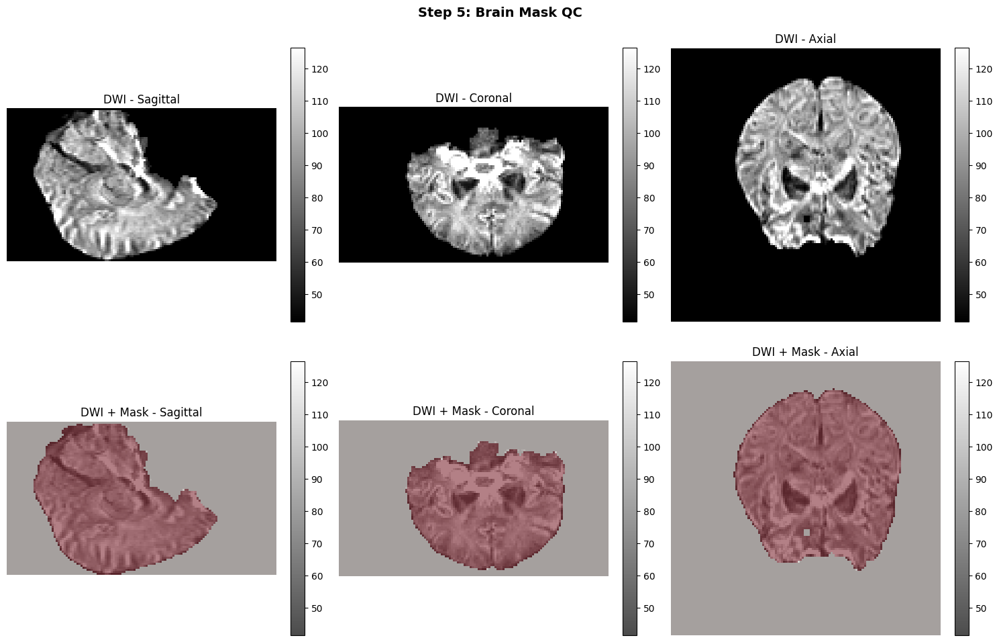


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.4651e+03
  Mask Voxels: 251220
  Coverage %: 104.6999
  Mean Intensity In Mask: 95.2096
  Mean Intensity Outside Mask: 55.1440


QC COMPLETE - See results above


In [42]:
results_PB = comprehensive_step_qc('sub-PB')


COMPREHENSIVE STEP-BY-STEP QC: sub-PM

STEP 1: DENOISING QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


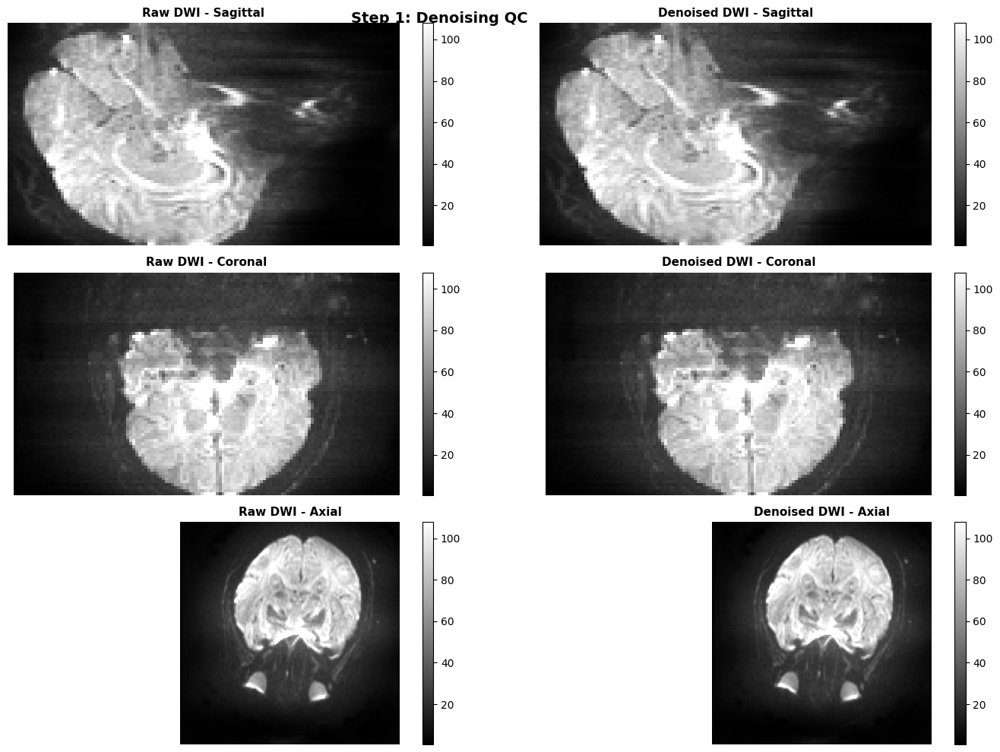


Noise Map Visualization


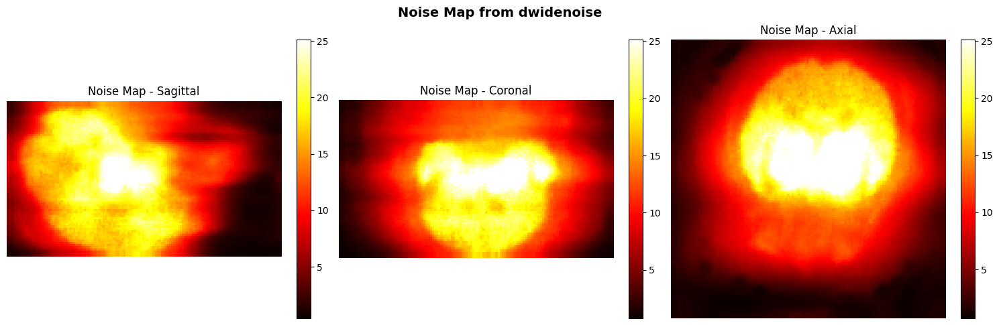


QC SUMMARY: Step 1: Denoising
  Snr Raw: 3.6768
  Snr Denoised: 3.6768
  Snr Improvement %: 1.2523e-03
  Mean Signal Raw: 24.1093
  Mean Signal Denoised: 24.1096
  Noise Std: 6.5572
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


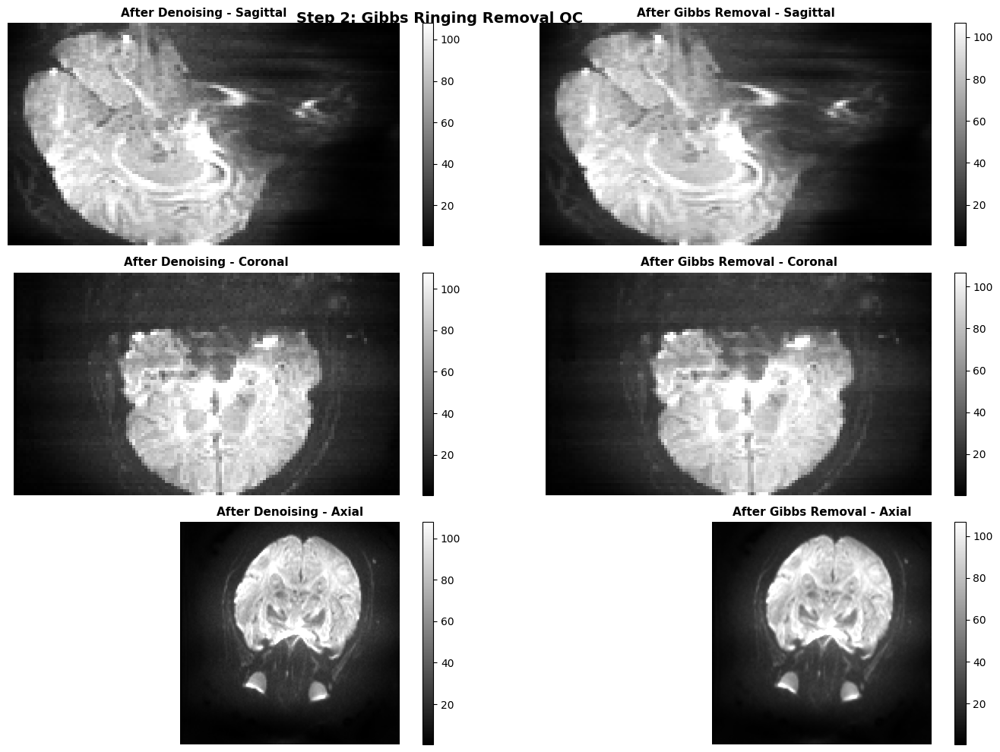


Edge Content Visualization (Gibbs ringing increases edge artifacts)


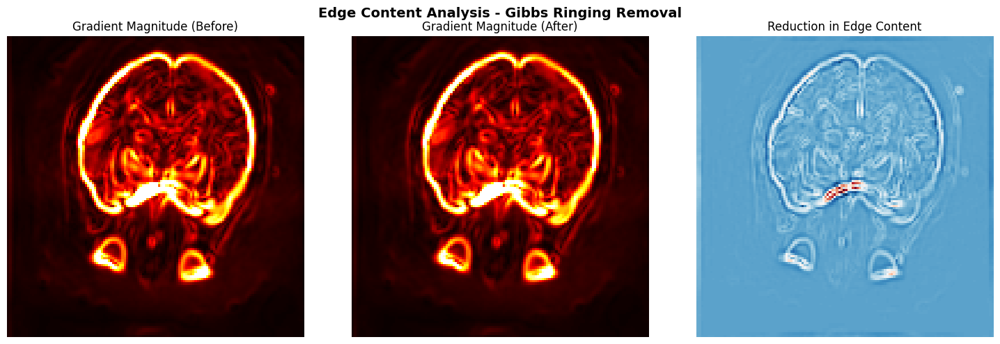


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


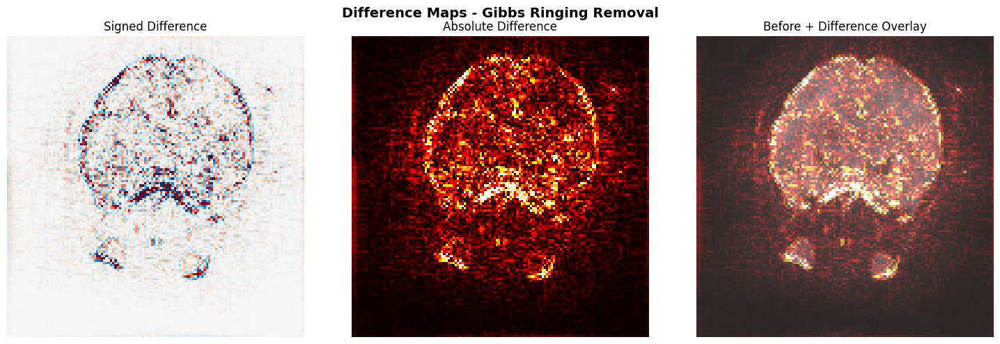


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 24.1096
  Mean Intensity After: 24.1028
  Std Intensity Before: 30.2873
  Std Intensity After: 30.1579
  Mean Gradient Before: 2.3767
  Mean Gradient After: 2.3472
  Gradient Reduction %: 1.2410
  High Freq Content Before: 8.8632
  High Freq Content After: 7.0835
  High Freq Reduction %: 20.0797
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 6.7947e-03
  Std Difference: 0.8930
  Mean Abs Difference: 0.4326
  Max Abs Difference: 52.8437
  Voxels With Change: 60663


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


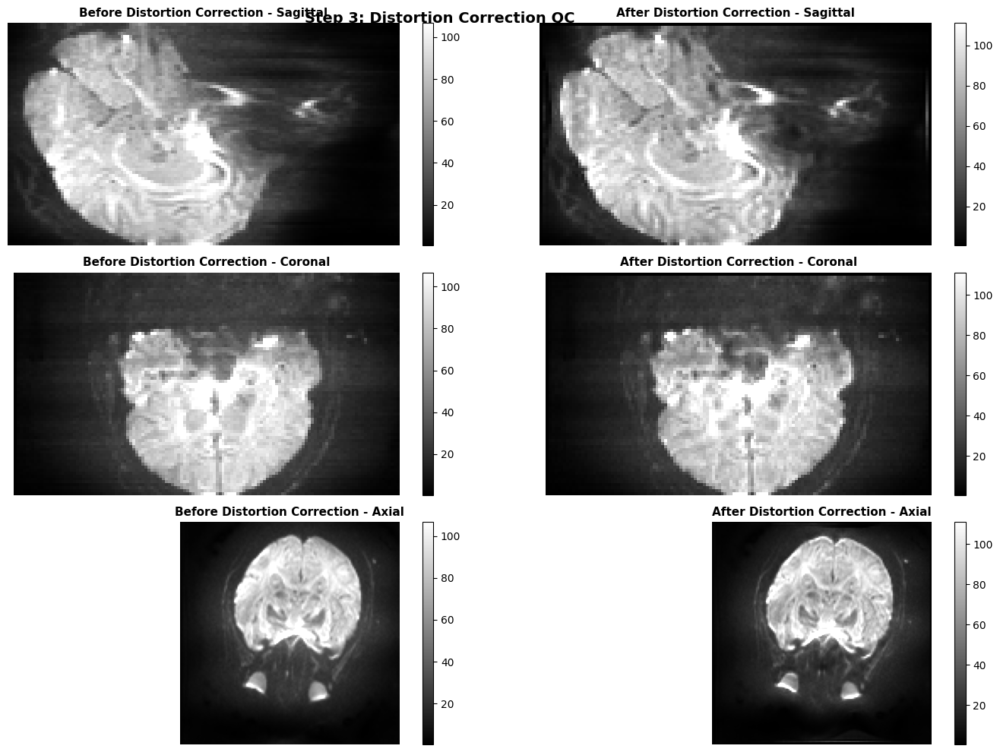


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


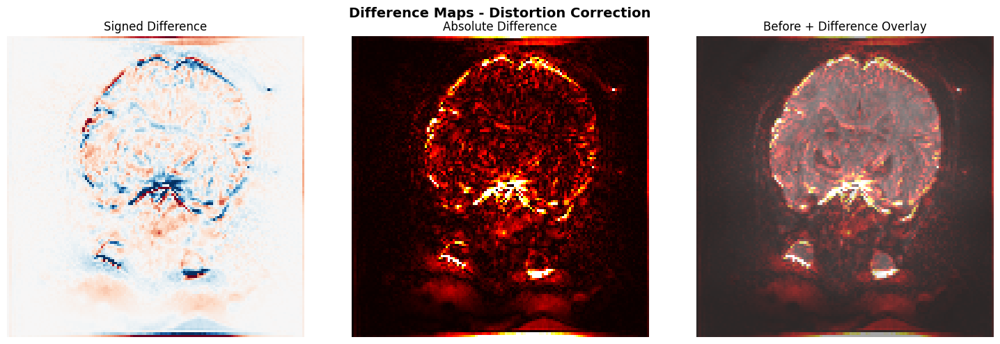


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 23.9256
  Mean Intensity After: 23.7343
  Std Intensity Before: 30.1090
  Std Intensity After: 31.0705
  Mean Difference: 0.1914
  Mean Abs Difference: 1.9968
  Max Abs Difference: 297.9852
  Voxels With Change: 61133


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


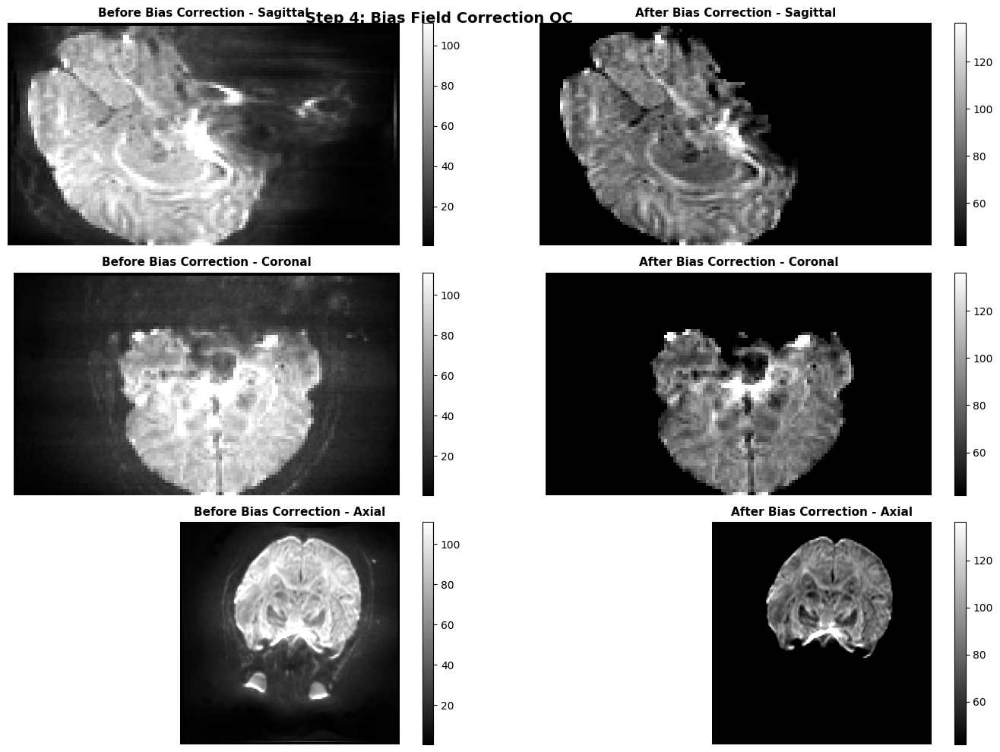


Difference Map (Before - After) - Shows where bias correction occurred


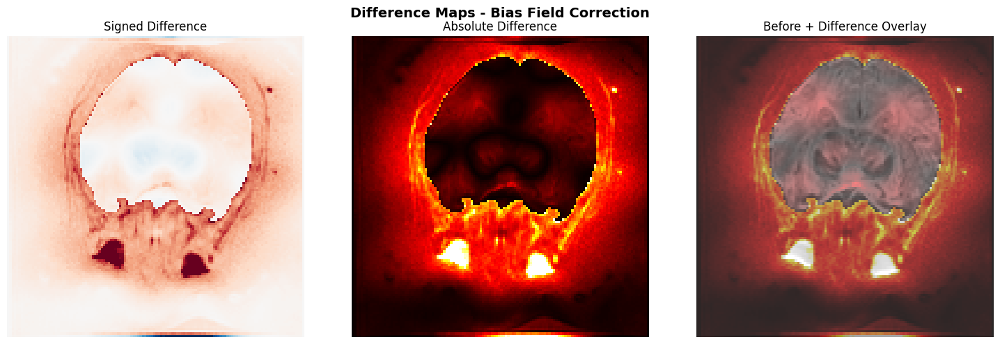


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 24.6392
  Mean Intensity After: 15.5802
  Std Intensity Before: 31.1668
  Std Intensity After: 33.5711
  Cv Before: 1.2649
  Cv After: 2.1547
  Cv Reduction %: -70.3441
  Mean Difference: 9.0590
  Mean Abs Difference: 10.1870
  Max Abs Difference: 390.4598
  Voxels With Change: 59065


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


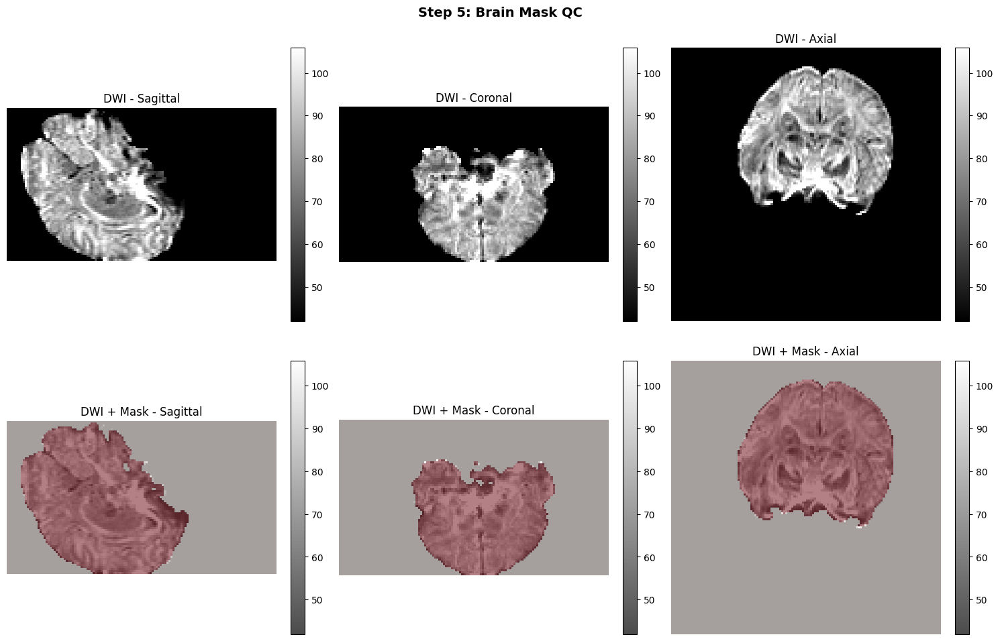


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.2730e+03
  Mask Voxels: 218272
  Coverage %: 104.6612
  Mean Intensity In Mask: 84.0066
  Mean Intensity Outside Mask: 54.5749


QC COMPLETE - See results above


In [43]:
results_PM = comprehensive_step_qc('sub-PM')


COMPREHENSIVE STEP-BY-STEP QC: sub-PO

STEP 1: DENOISING QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


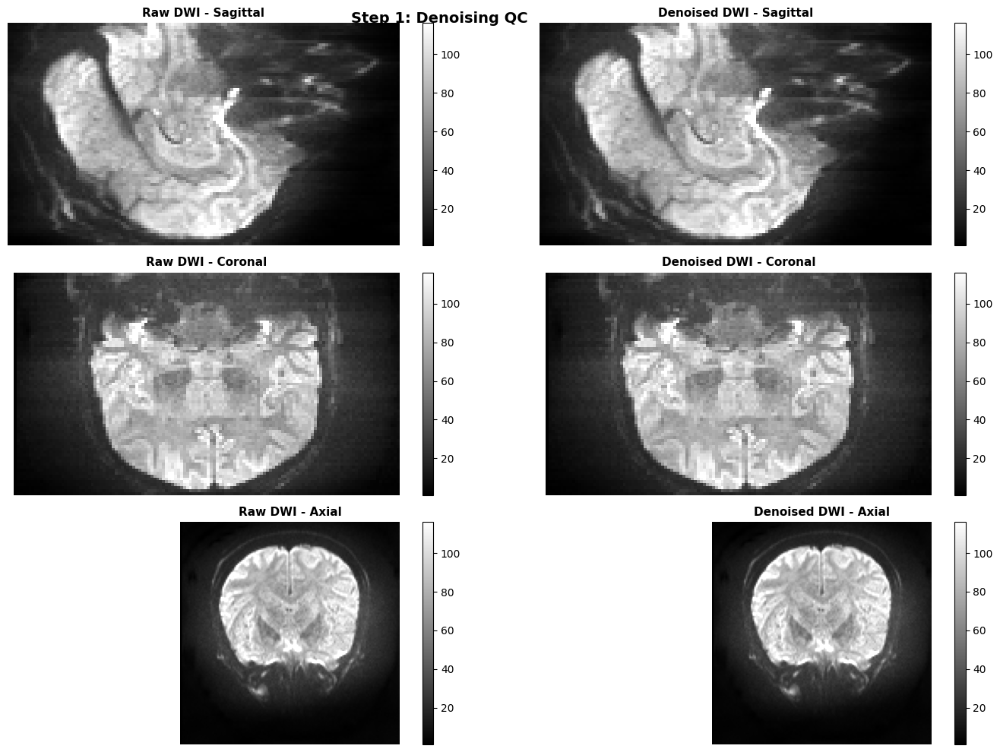


Noise Map Visualization


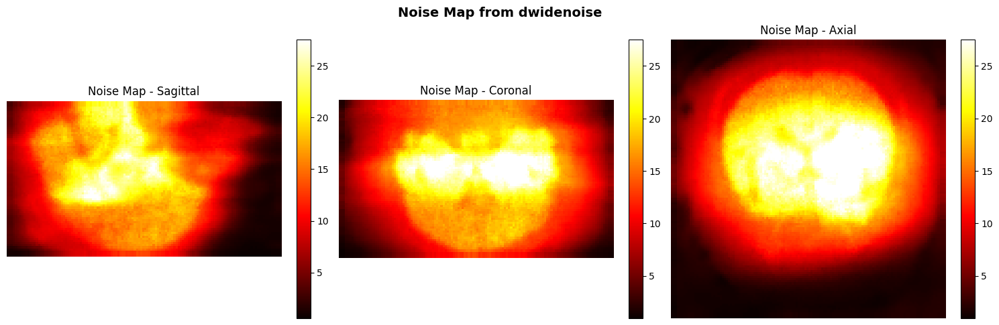


QC SUMMARY: Step 1: Denoising
  Snr Raw: 4.1711
  Snr Denoised: 4.1713
  Snr Improvement %: 4.7765e-03
  Mean Signal Raw: 29.4276
  Mean Signal Denoised: 29.4290
  Noise Std: 7.0552
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


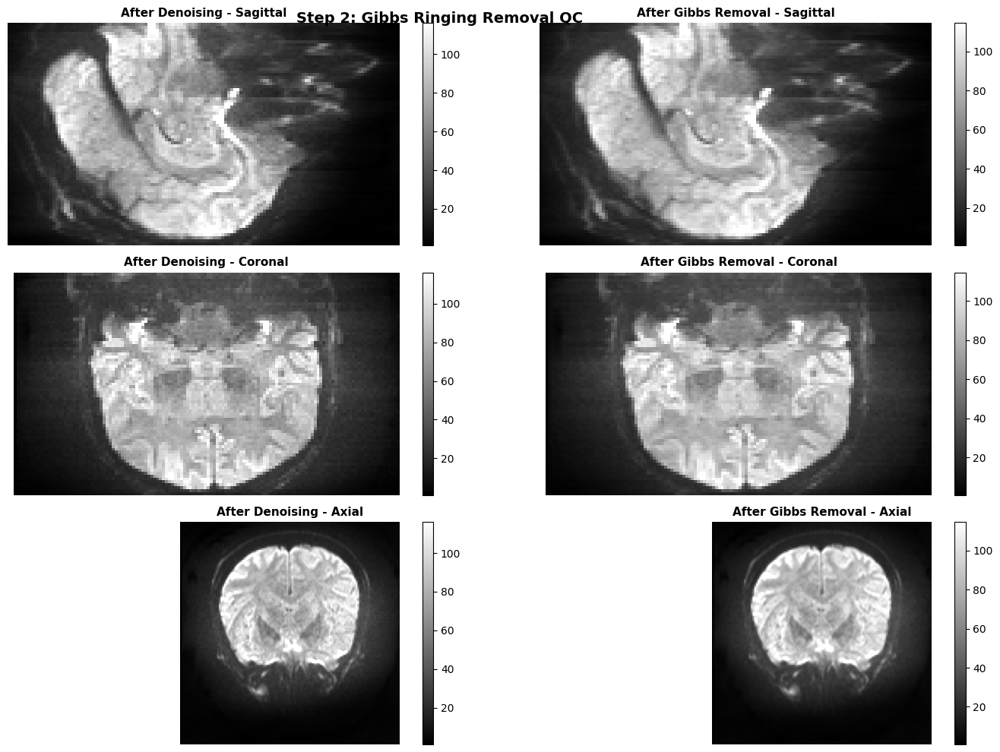


Edge Content Visualization (Gibbs ringing increases edge artifacts)


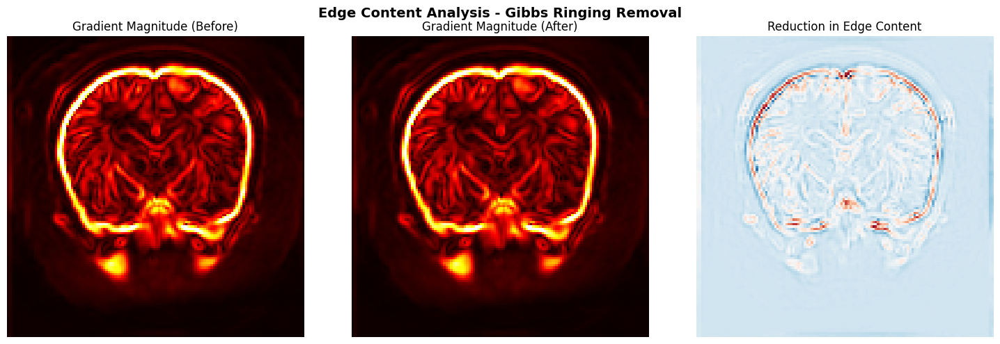


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


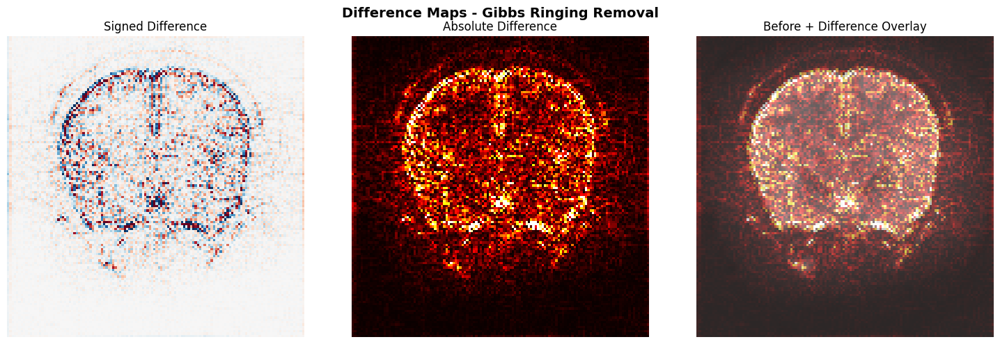


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 29.4290
  Mean Intensity After: 29.4159
  Std Intensity Before: 33.2400
  Std Intensity After: 33.0640
  Mean Gradient Before: 3.0628
  Mean Gradient After: 3.0133
  Gradient Reduction %: 1.6150
  High Freq Content Before: 11.3955
  High Freq Content After: 9.2262
  High Freq Reduction %: 19.0368
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 0.0131
  Std Difference: 1.0791
  Mean Abs Difference: 0.5522
  Max Abs Difference: 38.7707
  Voxels With Change: 60663


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


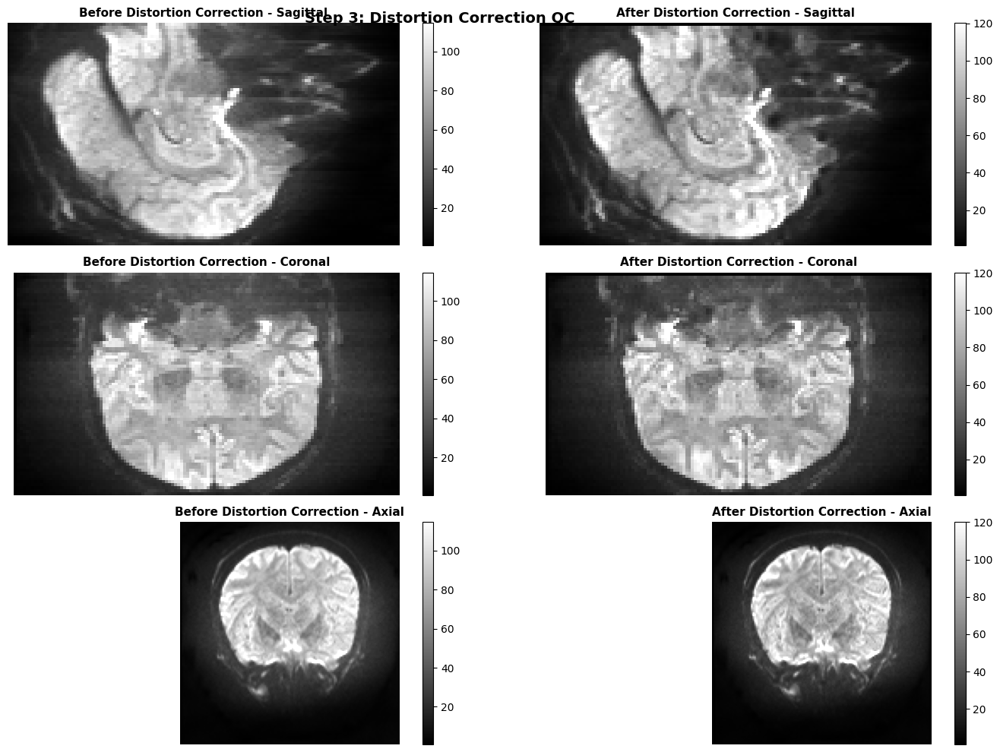


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


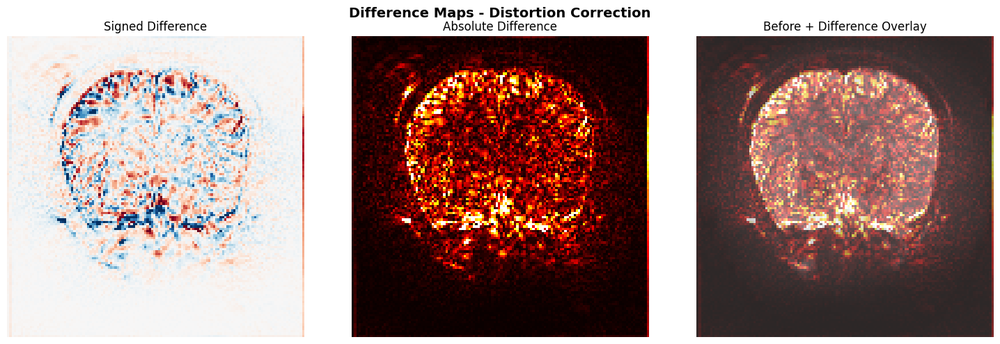


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 29.2012
  Mean Intensity After: 28.9314
  Std Intensity Before: 33.0267
  Std Intensity After: 33.7340
  Mean Difference: 0.2698
  Mean Abs Difference: 2.1298
  Max Abs Difference: 241.0536
  Voxels With Change: 61133


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


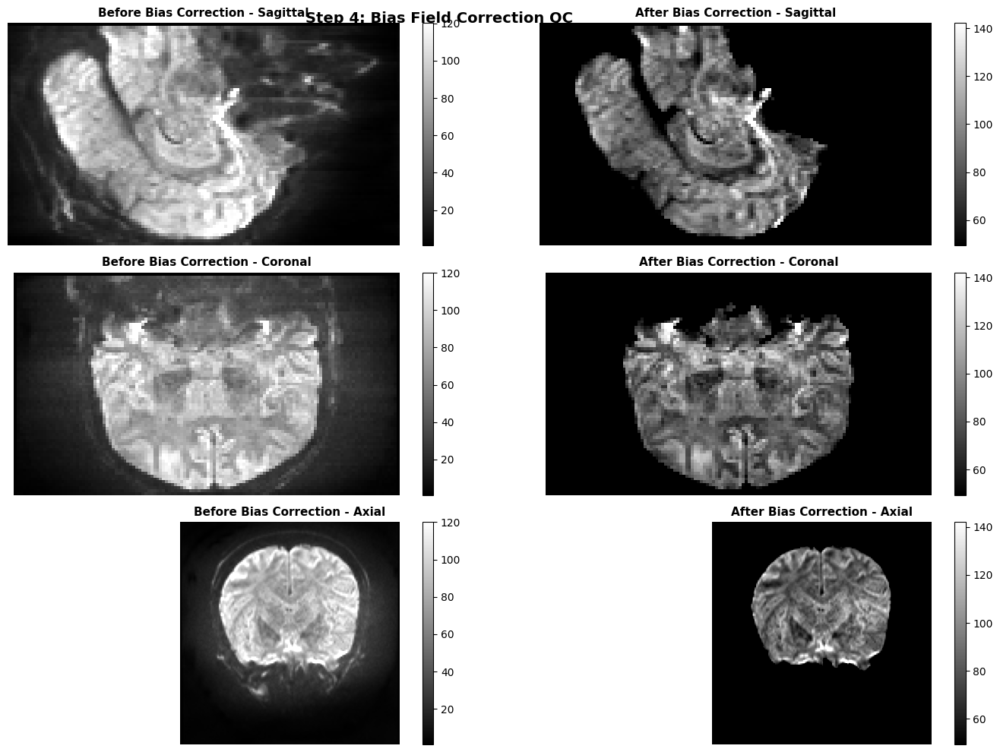


Difference Map (Before - After) - Shows where bias correction occurred


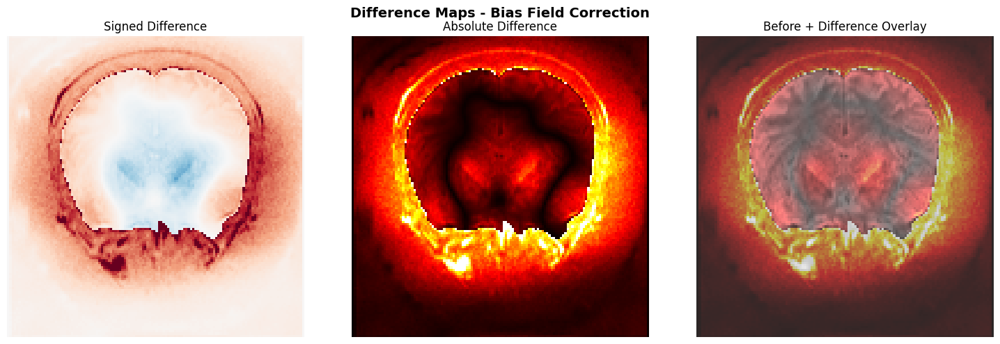


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 29.7708
  Mean Intensity After: 19.2219
  Std Intensity Before: 33.8626
  Std Intensity After: 37.3711
  Cv Before: 1.1374
  Cv After: 1.9442
  Cv Reduction %: -70.9270
  Mean Difference: 10.5489
  Mean Abs Difference: 11.8217
  Max Abs Difference: 369.3984
  Voxels With Change: 59389


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


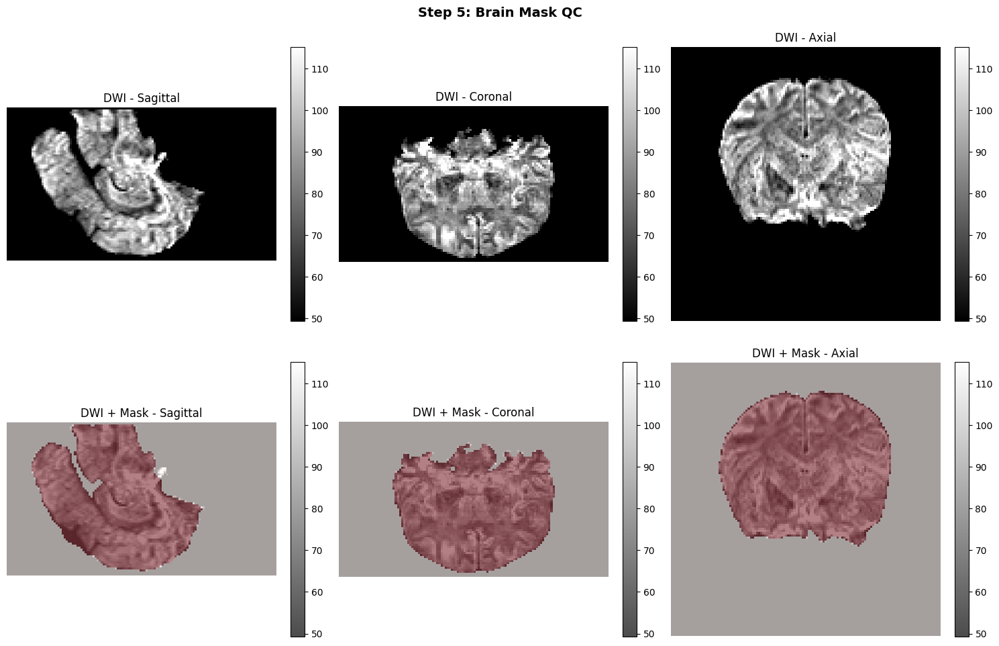


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.5060e+03
  Mask Voxels: 258232
  Coverage %: 104.5800
  Mean Intensity In Mask: 88.0164
  Mean Intensity Outside Mask: 60.8958


QC COMPLETE - See results above


In [44]:
results_PO = comprehensive_step_qc('sub-PO')


COMPREHENSIVE STEP-BY-STEP QC: sub-SA

STEP 1: DENOISING QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where denoising changes occur


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


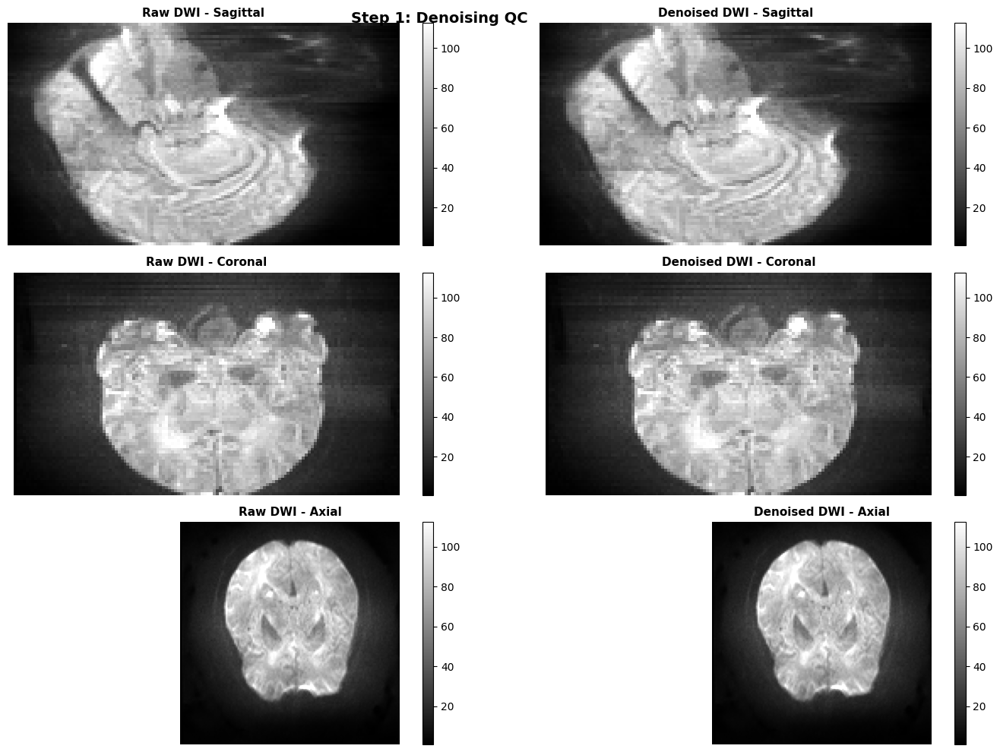


Noise Map Visualization


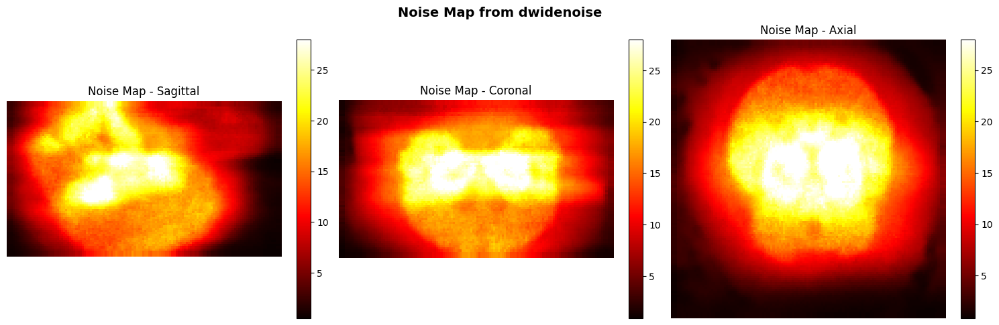


QC SUMMARY: Step 1: Denoising
  Snr Raw: 4.1278
  Snr Denoised: 4.1282
  Snr Improvement %: 0.0105
  Mean Signal Raw: 29.2357
  Mean Signal Denoised: 29.2388
  Noise Std: 7.0827
  Method: Using noise map from dwidenoise


STEP 2: GIBBS RINGING REMOVAL QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where Gibbs ringing was removed
Look for reduction in high-frequency oscillations at tissue boundaries


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


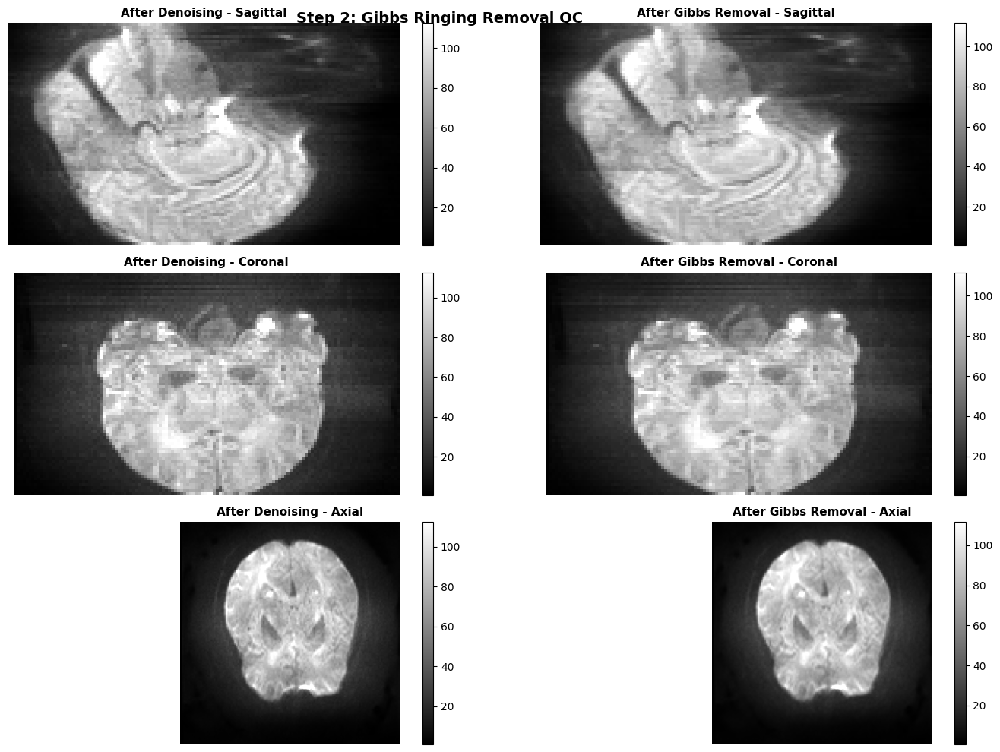


Edge Content Visualization (Gibbs ringing increases edge artifacts)


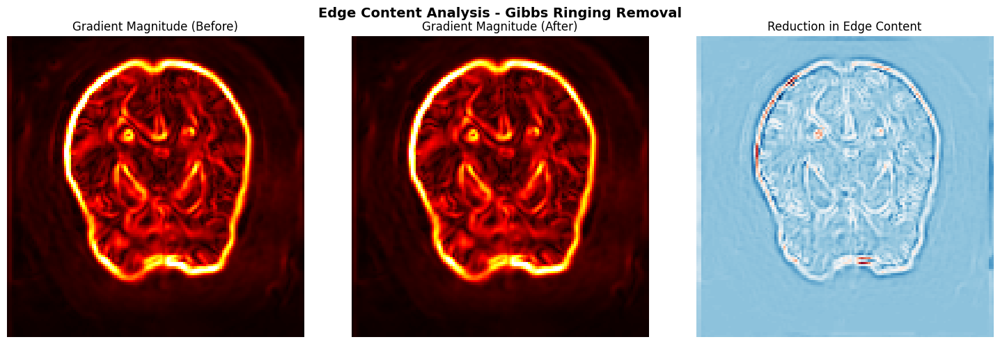


Difference Map (Before - After) - Shows where Gibbs ringing was removed
Positive values (red/yellow) indicate where signal was reduced (ringing removed)
Negative values (blue) indicate where signal was increased (rare, may indicate overcorrection)


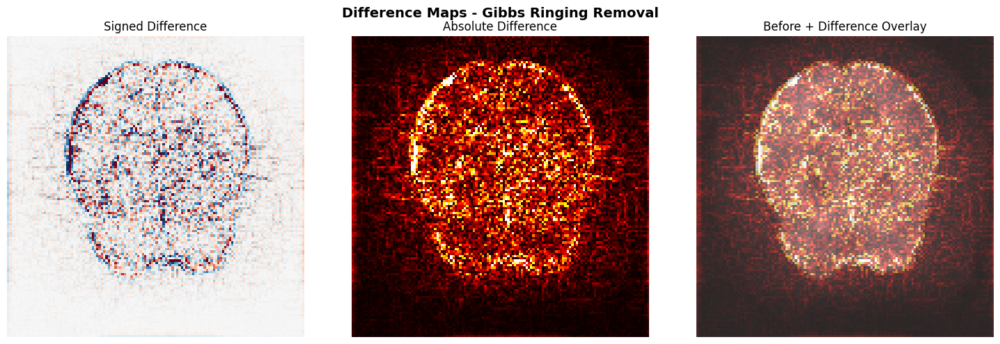


QC SUMMARY: Step 2: Gibbs Ringing Removal
  Mean Intensity Before: 29.2388
  Mean Intensity After: 29.2297
  Std Intensity Before: 33.1787
  Std Intensity After: 33.0826
  Mean Gradient Before: 2.6561
  Mean Gradient After: 2.6258
  Gradient Reduction %: 1.1389
  High Freq Content Before: 9.2356
  High Freq Content After: 7.4538
  High Freq Reduction %: 19.2924
  Interpretation: Positive reduction % indicates successful Gibbs artifact removal
  Mean Difference: 9.1477e-03
  Std Difference: 0.7959
  Mean Abs Difference: 0.4427
  Max Abs Difference: 19.9874
  Voxels With Change: 60663


STEP 3: DISTORTION CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where distortion correction occurred
Look for reduction in EPI distortions (stretching/compression artifacts)


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


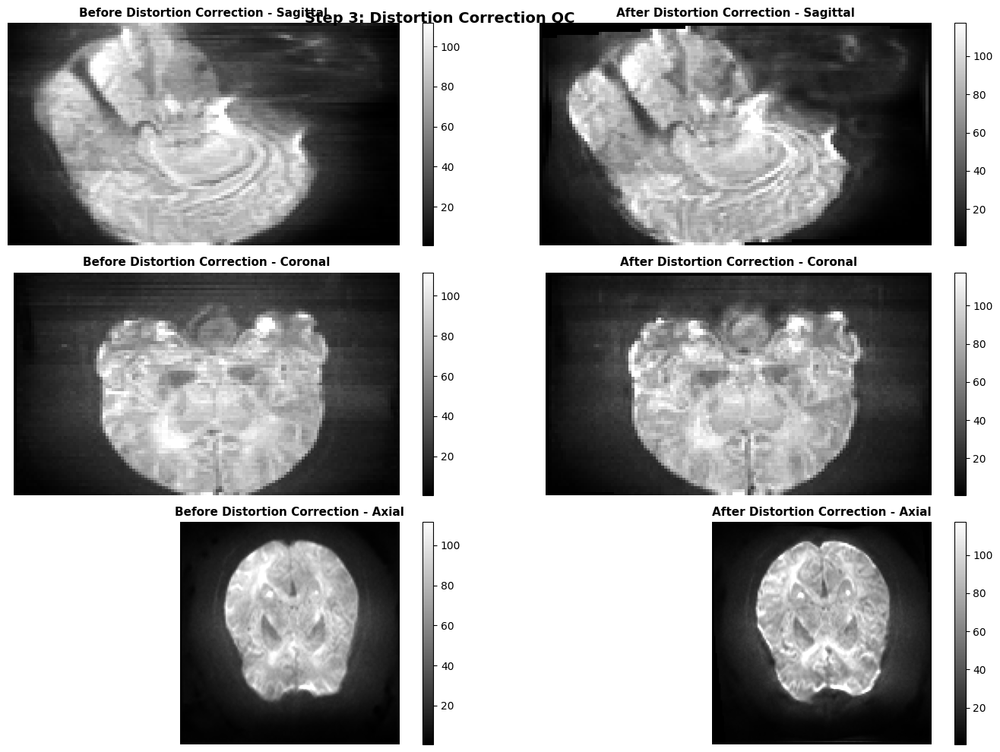


Difference Map (Before - After) - Shows where distortion correction occurred
Positive values (red/yellow) indicate where signal was reduced
Negative values (blue) indicate where signal was increased


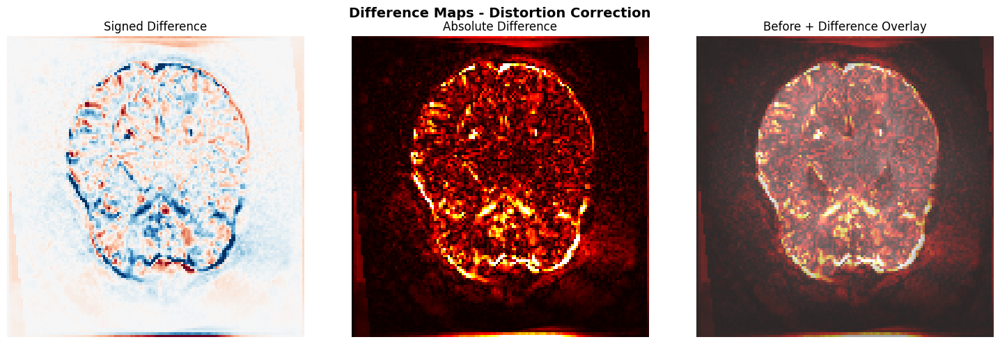


QC SUMMARY: Step 3: Distortion Correction
  Mean Intensity Before: 29.0153
  Mean Intensity After: 28.5335
  Std Intensity Before: 33.0449
  Std Intensity After: 34.3770
  Mean Difference: 0.4818
  Mean Abs Difference: 3.6226
  Max Abs Difference: 334.7429
  Voxels With Change: 61133


STEP 4: BIAS FIELD CORRECTION QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and see where bias correction occurred


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices)


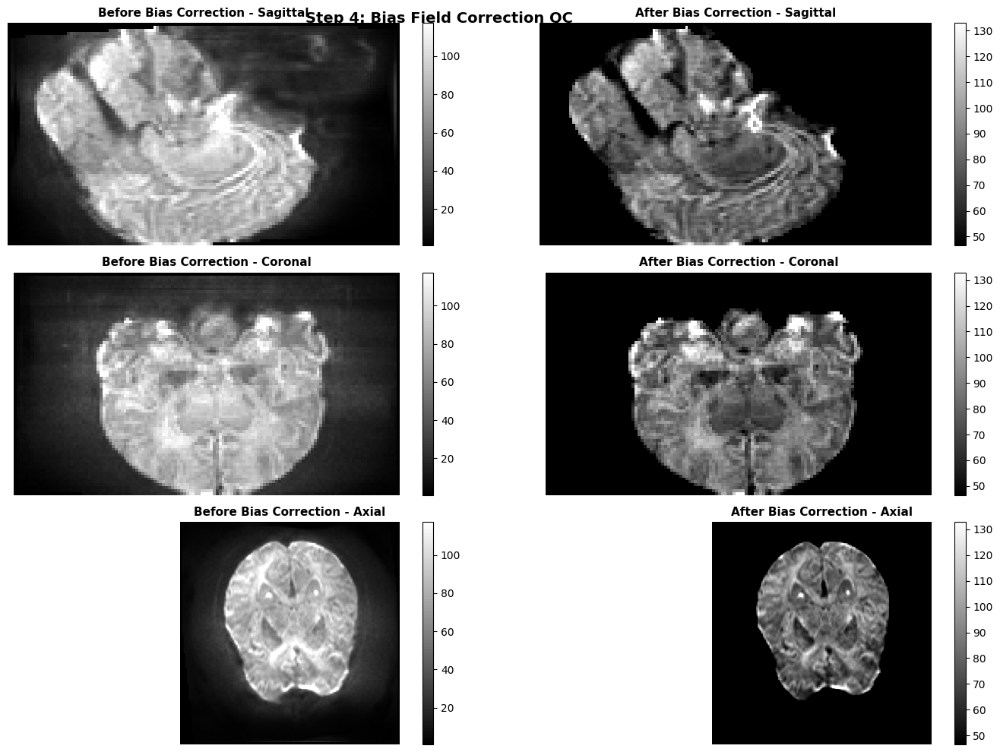


Difference Map (Before - After) - Shows where bias correction occurred


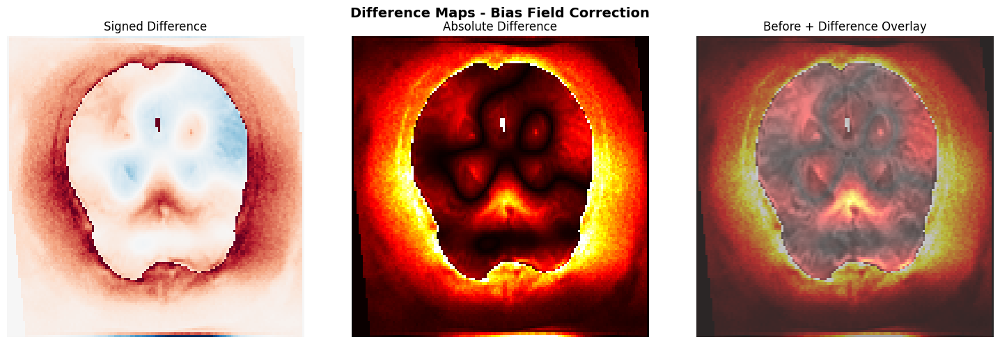


QC SUMMARY: Step 4: Bias Field Correction
  Mean Intensity Before: 31.2493
  Mean Intensity After: 21.9541
  Std Intensity Before: 34.5577
  Std Intensity After: 38.5641
  Cv Before: 1.1059
  Cv After: 1.7566
  Cv Reduction %: -58.8407
  Mean Difference: 9.2952
  Mean Abs Difference: 10.6783
  Max Abs Difference: 186.2526
  Voxels With Change: 56012


STEP 5: BRAIN MASK QC

Interactive Slice Viewer (navigate with slider)
Use the slider to navigate through slices and check mask quality
Red overlay shows the brain mask


interactive(children=(IntSlider(value=37, description='Slice:', layout=Layout(width='500px'), max=74, style=Sl…


Static Comparison (middle slices with mask overlay)


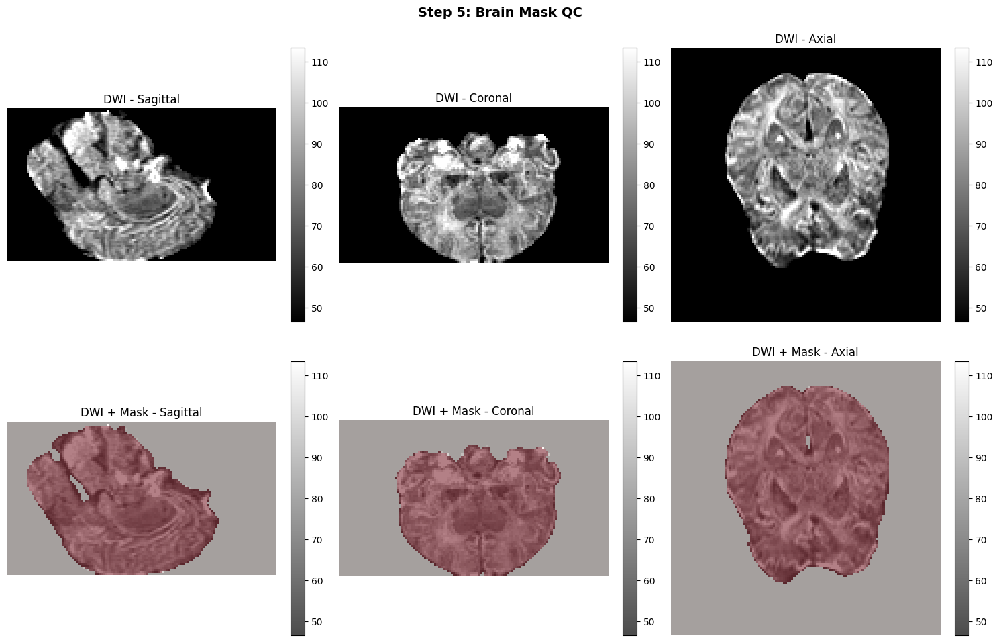


QC SUMMARY: Step 5: Brain Mask
  Mask Volume Ml: 1.6649e+03
  Mask Voxels: 285469
  Coverage %: 104.9013
  Mean Intensity In Mask: 85.9594
  Mean Intensity Outside Mask: 55.7052


QC COMPLETE - See results above


In [45]:
results_SA = comprehensive_step_qc('sub-SA')








In [46]:
### Usage Example

Run comprehensive step-by-step QC for a single subject:

```python
# Run comprehensive QC for all preprocessing steps
results = comprehensive_step_qc('sub-AF')

# Results will contain QC metrics for each step:
# - results['denoising']: SNR, noise map statistics
# - results['gibbs_ringing']: Gradient reduction, high-frequency content
# - results['distortion_correction']: Difference maps, intensity changes
# - results['bias_correction']: CV reduction, intensity normalization
# - results['brain_mask']: Mask volume, coverage statistics
```

The function will display:
- Interactive slice viewers for each step (navigate with sliders)
- Static comparison plots (middle slices)
- Difference maps showing where changes occurred
- Enhanced QC metrics and summaries



SyntaxError: invalid syntax (<ipython-input-46-0e50c1b387ea>, line 3)

In [ ]:
# Run comprehensive qualitative QC for all subjects
# results = comprehensive_step_qc('sub-AF')

# Uncomment the line below to execute:

all_qc_results = batch_qualitative_qc()

# Or run for a single subject:
# results = comprehensive_qualitative_qc('sub-AF')
